Please run those two cells before running the Notebook!

As those plotting settings are standard throughout the book, we do not show them in the book every time we plot something.

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = "retina"

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
from pandas.errors import SettingWithCopyWarning
warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)

# feel free to modify, for example, change the context to "notebook"
sns.set_theme(context="talk", style="whitegrid", 
              palette="colorblind", color_codes=True, 
              rc={"figure.figsize": [12, 8]})

In [3]:
import matplotlib.pyplot as plt


def get_font_family():
    import platform
    system_name = platform.system()
    if system_name == "Darwin" :
        font_family = "AppleGothic"
    elif system_name == "Windows":
        font_family = "Malgun Gothic"
    elif system_name == "Linux":
        font_family = "NanumGothic"
    return font_family


font_family = get_font_family()
plt.rc("font", family=font_family)
plt.rc('axes', unicode_minus=False)

# Chapter 13 - Applied Machine Learning: Identifying Credit Default

**응용 머신러닝: 신용 불이행 식별**

최근 몇 년 동안 머신러닝은 전통적인 비즈니스 문제 해결에 있어 점점 더 인기를 끌고 있습니다. 종종 새로운 알고리즘이 발표되어 최신 기술을 능가하고 있습니다. 모든 산업에서 비즈니스가 머신러닝의 놀라운 기능을 활용하려고 하는 것은 당연합니다.

이 장에서 집중할 과제를 명시하기 전에 머신러닝 분야에 대해 간단히 소개합니다. 머신러닝 도메인은 주로 지도 학습과 비지도 학습이라는 두 가지 주요 영역으로 나눌 수 있습니다. 지도 학습에서는 목표 변수(레이블)가 있으며, 이를 최대한 정확하게 예측하려고 합니다. 반면 비지도 학습에서는 목표가 없으며 데이터를 통해 몇 가지 통찰력을 도출하기 위해 다양한 기술을 시도합니다.

지도 학습 문제는 목표 변수가 연속적인 숫자인 회귀 문제(예: 소득이나 주택 가격과 같은 것)와 목표가 클래스(이진 또는 다중 클래스)인 분류 문제로 더욱 세분화될 수 있습니다. 비지도 학습의 예로는 주로 고객 세분화에 사용되는 클러스터링이 있습니다.

이 장에서는 금융 산업에서의 이진 분류 문제를 다룹니다. 우리는 UCI 머신러닝 리포지토리에 기여된 데이터셋을 사용합니다. 이 데이터셋은 매우 인기 있는 공개 데이터셋으로, 2005년 10월 대만 은행에서 수집된 데이터입니다. 당시에는 점점 더 많은 은행들이 고객에게 신용(현금 또는 신용카드를 통해)을 제공하고 있었습니다. 게다가 상환 능력에 상관없이 많은 사람들이 상당한 부채를 축적했습니다. 이로 인해 많은 사람들이 부채를 상환하지 못하는 상황이 발생했습니다. 즉, 대출을 불이행하게 된 것입니다.

이 연구의 목표는 고객의 기본 정보(성별, 연령, 교육 수준 등)와 과거 상환 이력을 통해 어떤 고객이 대출을 불이행할 가능성이 높은지를 예측하는 것이었습니다. 이 설정은 다음과 같이 설명될 수 있습니다. 과거 6개월의 상환 이력(2005년 4월~9월)을 사용하여 해당 고객이 2005년 10월에 불이행할지 여부를 예측합니다. 당연히 이러한 연구는 고객이 다음 달, 다음 분기, 또는 다음 해에 불이행할지를 예측하는 데 일반화될 수 있습니다.

이 장의 끝까지 가면, 데이터 수집 및 정제에서부터 분류기 구축 및 튜닝에 이르기까지 실제 머신러닝 과제를 해결하는 접근 방식을 익히게 될 것입니다. 또 다른 중요한 학습 내용은 머신러닝 프로젝트에 대한 일반적인 접근 방식을 이해하는 것입니다. 이러한 접근 방식은 고객 이탈 예측 또는 특정 지역의 부동산 가격 추정 등 다양한 과제에 적용될 수 있습니다.

이 장에서는 다음 주제에 중점을 둡니다:

- 데이터 로드 및 데이터 유형 관리
- 탐색적 데이터 분석
- 데이터셋을 학습 및 테스트 세트로 분할
- 결측값 식별 및 처리
- 범주형 변수 인코딩
- 결정 트리 분류기 적합
- 프로젝트 워크플로 관리
- 그리드 검색과 교차 검증을 통한 하이퍼파라미터 튜닝

## 13.0 Getting and preparing the data

이 부분은 책에서 다루지 않은 내용입니다. [UC Irvine Machine Learning Repository](https://archive.ics.uci.edu/ml/datasets/default+of+credit+card+clients) 웹사이트에서 해당 데이터셋을 다운로드합니다. 원본 데이터셋에는 결측값이 없으며 범주형 변수들은 이미 숫자로 인코딩되어 있습니다. 잠재적으로 지저분한 데이터를 다루고 준비하는 전체 파이프라인을 보여주기 위해 다음과 같은 변환을 적용합니다:

* 성별, 교육 수준, 결혼 상태 관련 변수들을 문자열로 인코딩했습니다
* 일부 관측치에 결측값을 도입했습니다 (전체 샘플의 0.5%를 열별로 무작위 선택 - 최소 하나의 결측값이 있는 행의 총 비율은 더 높을 것입니다)
* 교육 수준, 지불 상태 등과 같은 특성들의 일부 관측값이 저자들이 정의한 가능한 범주의 범위를 벗어났습니다. 이 문제가 많은 관측치에 영향을 미치므로, 새로운 미설명 범주를 'Others'(이미 그러한 범주가 있는 경우) 또는 'Unknown'(지불 상태의 경우)으로 인코딩합니다.

결측값으로 선택한 값의 비율을 작게 유지한 이유는 데이터의 기본 구조/패턴을 크게 변경하지 않기 위해서입니다.

In [4]:
import pandas as pd
import numpy as np
import random

In [5]:
# downloading the data 
# !wget https://archive.ics.uci.edu/ml/machine-learning-databases/00350/default%20of%20credit%20card%20clients.xls

In [7]:
# Excel 파일에서 데이터 로드
df = pd.read_excel("default of credit card clients.xls", skiprows=1, index_col=0)

# 컬럼명을 소문자로 변경하고 공백을 언더스코어로 대체 
df.columns = df.columns.str.lower().str.replace(" ", "_")

# 월별 변수명 생성을 위한 리스트 정의
months = ["sep", "aug", "jul", "jun", "may", "apr"]
variables = ["payment_status", "bill_statement", "previous_payment"]
# 각 변수와 월을 조합하여 새로운 컬럼명 생성 
new_column_names = [x + "_" + y for x in variables for y in months]
# 기존 컬럼명과 새로운 컬럼명을 매핑하여 변경
rename_dict = {x: y for x, y in zip(df.loc[:, "pay_0":"pay_amt6"].columns, new_column_names)}
df.rename(columns=rename_dict, inplace=True)


# 숫자를 문자열로 매핑하기 위한 딕셔너리 생성
gender_dict = {1: "Male", 
               2: "Female"}
education_dict = {0: "Others",
                  1: "Graduate school", 
                  2: "University", 
                  3: "High school", 
                  4: "Others",
                  5: "Others", 
                  6: "Others"}
marital_status_dict = {0: "Others", 
                       1: "Married", 
                       2: "Single", 
                       3: "Others"}
payment_status = {-2: "Unknown",
                  -1: "Payed duly", 
                  0: "Unknown",
                  1: "Payment delayed 1 month",
                  2: "Payment delayed 2 months",
                  3: "Payment delayed 3 months", 
                  4: "Payment delayed 4 months",
                  5: "Payment delayed 5 months",
                  6: "Payment delayed 6 months",
                  7: "Payment delayed 7 months", 
                  8: "Payment delayed 8 months",
                  9: "Payment delayed >= 9 months"}

# 숫자 값을 문자열로 변환
df["sex"] = df["sex"].map(gender_dict)
df["education"] = df["education"].map(education_dict)
df["marriage"] = df["marriage"].map(marital_status_dict)

# 지불 상태 관련 컬럼들의 숫자를 문자열로 변환
for column in [x for x in df.columns if ("status" in x)]:
    df[column] = df[column].map(payment_status)

# 결측치를 생성할 비율 설정 
RATIO_MISSING = 0.005

# 선택된 컬럼에 결측치 입력
random_state = np.random.RandomState(42)
for column in ["sex", "education", "marriage", "age"]:
    df.loc[df.sample(frac=RATIO_MISSING, random_state=random_state).index, column] = ""

# 인덱스 초기화
df.reset_index(drop=True, inplace=True)

# CSV 파일로 저장
# df.to_csv("./datasets/credit_card_default.csv", index=False)

## 13.1 Loading data and managing data types

**데이터 로드 및 데이터 유형 관리**

이 예제에서는 CSV 파일에서 Python으로 데이터셋을 로드하는 방법을 보여줍니다. 동일한 원칙은 pandas에서 지원하는 다른 파일 형식에도 적용할 수 있습니다. 일반적인 형식으로는 Parquet, JSON, XML, Excel, 그리고 Feather 등이 있습니다.

> pandas는 매우 일관된 API를 가지고 있어 함수 찾기가 훨씬 쉽습니다. 예를 들어, 다양한 소스에서 데이터를 로드하는 데 사용되는 모든 함수는 `pd.read_xxxx` 형태의 구문을 가지며, 여기서 `xxxx`는 파일 형식으로 대체됩니다.

또한 특정 데이터 유형 변환이 컴퓨터 메모리 내의 DataFrame 크기를 상당히 줄일 수 있음을 보여줍니다. 이는 대용량 데이터셋(GB 또는 TB 단위) 작업 시 특히 중요하며, 메모리에 맞추기 위해 데이터 사용을 최적화하지 않으면 메모리에 맞지 않을 수 있습니다.

더욱 현실적인 시나리오(혼란스러운 데이터, 결측값 등)를 제공하기 위해 원본 데이터셋에 몇 가지 변환을 적용했습니다. 이러한 변경 사항에 대한 자세한 내용은 동반 GitHub 리포지토리를 참조하십시오.

### How to do it...

1. Import the libraries:

In [8]:
import pandas as pd

2. Load the data from the CSV file:

pandas를 불러온 후 `pd.read_csv` 함수를 사용하여 CSV 파일을 로드합니다. 이때 빈 문자열이 누락된 값으로 해석되도록 지정합니다.

In [9]:
df = pd.read_csv("./datasets/credit_card_default.csv", 
                 na_values="")
df

,limit_bal,sex,education,marriage,age,payment_status_sep,payment_status_aug,payment_status_jul,payment_status_jun,payment_status_may,...,bill_statement_jun,bill_statement_may,bill_statement_apr,previous_payment_sep,previous_payment_aug,previous_payment_jul,previous_payment_jun,previous_payment_may,previous_payment_apr,default_payment_next_month
0,20000,Female,University,Married,24.0,Payment delayed 2 months,Payment delayed 2 months,Payed duly,Payed duly,Unknown,...,0,0,0,0,689,0,0,0,0,1
1,120000,Female,University,Single,26.0,Payed duly,Payment delayed 2 months,Unknown,Unknown,Unknown,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,Female,University,Single,34.0,Unknown,Unknown,Unknown,Unknown,Unknown,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,Female,University,Married,37.0,Unknown,Unknown,Unknown,Unknown,Unknown,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,Male,University,Married,57.0,Payed duly,Unknown,Payed duly,Unknown,Unknown,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,220000,NaN,High school,Married,39.0,Unknown,Unknown,Unknown,Unknown,Unknown,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,150000,Male,High school,Single,43.0,Payed duly,Payed duly,Payed duly,Payed duly,Unknown,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,30000,Male,University,Single,37.0,Payment delayed 4 months,Payment delayed 3 months,Payment delayed 2 months,Payed duly,Unknown,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,80000,Male,High school,Married,41.0,Payment delayed 1 month,Payed duly,Unknown,Unknown,Unknown,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


그림 13.1: 데이터셋 미리보기. 모든 열이 표시되지는 않음

DataFrame은 30,000개의 행과 24개의 열을 가지고 있습니다. 숫자형과 범주형 변수가 혼합되어 있습니다.


3. View the summary of the DataFrame: 

3단계에서는 데이터셋의 내용을 살펴보기 위해 DataFrame의 요약 정보를 표시합니다. 데이터셋에 대한 이해를 돕기 위해 변수에 대한 간단한 설명을 제공합니다:

- `limit_bal` — 주어진 신용 한도(대만 달러)
- `sex` — 생물학적 성별
- `education` — 교육 수준
- `marriage` — 결혼 상태
- `age` — 고객의 연령
- `payment_status_(month)` — 지난 6개월 동안의 월별 지불 상태
- `bill_statement_(month)` — 지난 6개월 동안의 청구서 금액(대만 달러)
- `previous_payment_(month)` — 지난 6개월 동안의 결제 금액(대만 달러)
- `default_payment_next_month` — 다음 달에 고객이 결제를 불이행했는지 여부를 나타내는 목표 변수

일반적으로 pandas는 가능한 한 효율적으로 데이터를 로드하고 저장하려고 합니다. pandas DataFrame의 `dtypes` 메서드를 사용하여 할당된 데이터 유형을 확인할 수 있습니다. 하지만 더 나은 메모리 할당을 위해 사용할 수 있는 몇 가지 요령이 있으며, 이는 수백 MB 또는 수 GB에 달하는 큰 테이블을 다룰 때 훨씬 더 편리하고 효율적입니다.

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   limit_bal                   30000 non-null  int64  
 1   sex                         29850 non-null  object 
 2   education                   29850 non-null  object 
 3   marriage                    29850 non-null  object 
 4   age                         29850 non-null  float64
 5   payment_status_sep          30000 non-null  object 
 6   payment_status_aug          30000 non-null  object 
 7   payment_status_jul          30000 non-null  object 
 8   payment_status_jun          30000 non-null  object 
 9   payment_status_may          30000 non-null  object 
 10  payment_status_apr          30000 non-null  object 
 11  bill_statement_sep          30000 non-null  int64  
 12  bill_statement_aug          30000 non-null  int64  
 13  bill_statement_jul          300

요약에서 우리는 열과 데이터 유형, 비어 있지 않은 값의 개수(즉, 누락되지 않은 값), 메모리 사용량 등을 확인할 수 있습니다.

또한 몇 가지 구별되는 데이터 유형을 볼 수 있습니다: float(부동 소수점 숫자, 예: 3.42), integer, 그리고 object. 마지막 것은 문자열 변수를 pandas가 표현한 것입니다. float와 int 옆에 있는 숫자는 해당 유형이 특정 값을 표현하는 데 사용하는 비트 수를 나타냅니다. 기본 데이터 유형은 64비트(또는 8바이트)의 메모리를 사용합니다.

> 기본 `int8` 유형은 -128에서 127까지의 정수를 포함합니다. `uint8`은 부호 없는 정수를 나타내며 동일한 범위를 포함하지만, 0에서 255까지의 양수만 포함합니다. 특정 데이터 유형이 포함하는 값의 범위를 알면(추가 참고 섹션의 링크 참조) 할당된 메모리를 최적화할 수 있습니다. 예를 들어, 구매 월(1-12로 표현된 숫자)과 같은 기능의 경우 기본 `int64` 대신 훨씬 작은 유형을 사용하는 것이 충분합니다.


4. Define a function for inspecting the exact memory usage of a DataFrame:

4단계에서는 DataFrame의 예상 메모리 사용량을 검사하는 함수를 정의합니다. `memory_usage` 메서드는 각 DataFrame 열의 메모리 사용량(바이트 단위)을 pandas Series로 반환합니다. 이해하기 쉽게 하기 위해 출력을 MB로 변환합니다.

> `memory_usage` 메서드를 사용할 때 `deep=True`로 지정합니다. 그 이유는 `object` 데이터 유형이 다른 데이터 유형과 달리 각 셀에 대해 고정된 메모리 할당이 없기 때문입니다. 즉, `object` 유형은 일반적으로 텍스트를 나타내며, 이는 각 셀에 포함된 문자 수에 따라 메모리 사용량이 달라진다는 것을 의미합니다. 직관적으로 문자열에 문자가 많을수록 해당 셀이 사용하는 메모리가 증가합니다.

In [11]:
def get_df_memory_usage(df, top_columns=5):
    """
    pandas DataFrame의 메모리 사용량을 빠르게 분석하는 함수입니다.
    메모리 사용량이 가장 많은 상위 `top_columns`개의 열과 전체 사용량을 출력합니다.
    
    Parameters
    ------------
    df : pd.DataFrame
        분석할 DataFrame
    top_columns : int
        표시할 상위 열의 개수 (메모리 사용량 기준)
    """
    # 메모리 사용량 헤더 출력
    print("Memory usage ----")
    
    # 각 열의 메모리 사용량을 MB 단위로 계산
    # deep=True로 설정하여 object 타입 열의 실제 메모리도 계산
    memory_per_column = df.memory_usage(deep=True) / (1024 ** 2)
    
    # 메모리를 가장 많이 사용하는 상위 n개 열 출력
    print(f"Top {top_columns} columns by memory (MB):")
    print(memory_per_column.sort_values(ascending=False) \
                           .head(top_columns))
    
    # DataFrame의 전체 메모리 사용량 출력 (소수점 2자리까지)
    print(f"Total size: {memory_per_column.sum():.2f} MB")

In [12]:
get_df_memory_usage(df, 5)

Memory usage ----
Top 5 columns by memory (MB):
education             1.965001
payment_status_sep    1.954342
payment_status_aug    1.920288
payment_status_jul    1.916343
payment_status_jun    1.904229
dtype: float64
Total size: 20.47 MB


출력에서 info 메서드가 보고한 5.5+ MB가 실제로는 거의 4배 더 많은 것으로 나타났습니다. 이는 현재 컴퓨터의 성능 측면에서는 여전히 매우 작은 크기이지만, 이 장에서 보여주는 메모리 절약 원칙은 기가바이트 단위의 DataFrame에도 동일하게 적용됩니다.

5. Convert the columns with `object` data type into `category` type:

5단계에서는 `category`라는 특수 데이터 유형을 활용하여 DataFrame의 메모리 사용량을 줄입니다. 기본 아이디어는 문자열 변수가 정수로 인코딩되고 pandas가 이를 원래 형태로 되돌리는 데 특수한 매핑 사전을 사용하는 것입니다. 이는 교육 수준, 출신 국가 등과 같이 제한된 수의 고유 값이 있는 경우 특히 유용합니다. 메모리를 절약하기 위해 `select_dtypes` 메서드를 사용하여 `object` 데이터 유형의 모든 열을 확인한 후, `astype` 메서드를 사용하여 해당 열의 데이터 유형을 `object`에서 `category`로 변경합니다.

> `category` 데이터 유형을 사용하는 것이 실제로 유리한 경우(고객 관점에서)를 알아야 합니다. 일반적인 규칙은 고유 값의 비율이 전체 관측값의 50% 미만인 변수를 위해 사용하는 것입니다.

In [13]:
# object 타입의 열들을 찾습니다
# select_dtypes() 메서드를 사용하여 데이터프레임에서 object 타입인 열들만 선택합니다
object_columns = df.select_dtypes(include="object").columns

# object 타입의 열들을 category 타입으로 변환합니다
# category 타입은 문자열을 정수로 인코딩하여 메모리를 절약합니다
# 특히 고유값이 적은 범주형 데이터에 효과적입니다
df[object_columns] = df[object_columns].astype("category")

# 변환 후의 메모리 사용량을 확인합니다
get_df_memory_usage(df)

Memory usage ----
Top 5 columns by memory (MB):
limit_bal               0.228882
age                     0.228882
previous_payment_sep    0.228882
previous_payment_aug    0.228882
bill_statement_may      0.228882
dtype: float64
Total size: 3.70 MB


6. Downcast the numeric columns to integers:

6단계에서는 `select_dtypes` 메서드를 사용하여 모든 숫자형 열을 식별합니다. 그런 다음 반복문을 사용하여 식별된 열을 순회하며 `pd.to_numeric` 함수를 사용해 값을 숫자형으로 변환합니다. 숫자형 열을 처음 식별한 후 다시 숫자형으로 변환했기 때문에 이 과정이 다소 중복으로 보일 수 있습니다. 그러나 중요한 부분은 `downcast` 인수를 `integer` 값으로 지정하여, 모든 정수 열의 데이터 유형을 `int32`와 `int8` 같은 더 작은 대안으로 최적화한다는 점입니다.

모든 숫자 열에 이 함수를 적용하지만 고객의 연령을 포함한 일부 열만 성공적으로 변환됩니다. 따라서 7단계에서는 고객의 연령을 `float` 데이터 유형으로 추가로 다운캐스트합니다.

In [20]:
# 숫자형 데이터 타입을 가진 모든 열을 선택합니다
numeric_columns = df.select_dtypes(include="number").columns

# 각 숫자형 열에 대해 반복하면서
for col in numeric_columns:
    # pd.to_numeric()을 사용하여 데이터 타입을 최적화합니다
    # downcast="integer"를 지정하여 가능한 가장 작은 정수 타입으로 변환합니다
    # 예: int64 -> int32 또는 int16 또는 int8
    df[col] = pd.to_numeric(df[col], downcast="integer")

# 메모리 사용량 변화를 확인합니다
get_df_memory_usage(df)

Memory usage ----
Top 5 columns by memory (MB):
age                     0.228882
limit_bal               0.114441
previous_payment_sep    0.114441
previous_payment_aug    0.114441
bill_statement_may      0.114441
dtype: float64
Total size: 2.01 MB


In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype   
---  ------                      --------------  -----   
 0   limit_bal                   30000 non-null  int32   
 1   sex                         29850 non-null  category
 2   education                   29850 non-null  category
 3   marriage                    29850 non-null  category
 4   age                         29850 non-null  float64 
 5   payment_status_sep          30000 non-null  category
 6   payment_status_aug          30000 non-null  category
 7   payment_status_jul          30000 non-null  category
 8   payment_status_jun          30000 non-null  category
 9   payment_status_may          30000 non-null  category
 10  payment_status_apr          30000 non-null  category
 11  bill_statement_sep          30000 non-null  int32   
 12  bill_statement_aug          30000 non-null  int32   
 13  bill_statement_j

요약하면, 몇 가지 데이터 타입 변환 후에 가장 많은 메모리를 차지하는 열은 고객의 나이를 포함하는 열입니다(df.info()의 출력에서 확인할 수 있지만 간단히 하기 위해 여기서는 표시하지 않았습니다). 이는 float 데이터 타입을 사용하여 인코딩되었고 float 열에는 정수 설정을 사용한 다운캐스팅이 적용되지 않았기 때문입니다.

7. Downcast the `age` column using the `float` data type:

In [17]:
# age 열을 float 타입으로 다운캐스트합니다
# pd.to_numeric() 함수를 사용하여 age 열의 데이터 타입을 변환합니다
# downcast="float" 옵션을 통해 가능한 가장 작은 float 타입으로 최적화합니다
# 예: float64 -> float32
df["age"] = pd.to_numeric(df["age"], downcast="float")

# 메모리 사용량 변화를 확인합니다
get_df_memory_usage(df)

Memory usage ----
Top 5 columns by memory (MB):
limit_bal               0.114441
age                     0.114441
previous_payment_sep    0.114441
previous_payment_aug    0.114441
bill_statement_may      0.114441
dtype: float64
Total size: 1.90 MB


### There's more

이 예제에서는 pandas DataFrame의 메모리 사용량을 최적화하는 방법에 대해 설명했습니다. 먼저 데이터를 Python으로 로드하고 열을 검사한 다음 일부 열의 데이터 유형을 변환하여 메모리 사용량을 줄였습니다. 그러나 이러한 접근이 불가능한 경우도 있을 수 있습니다. 데이터가 처음부터 메모리에 들어가지 않을 수도 있기 때문입니다.

이러한 경우에는 다음과 같은 방법을 사용할 수 있습니다:

- 데이터를 청크 단위로 로드하기(`read_csv`의 `chunksize` 인수를 사용). 예를 들어, 처음 100개의 행만 로드할 수 있습니다.
- 실제로 필요한 열만 로드하기(`read_csv`의 `usecols` 인수를 사용).
- 데이터를 로드할 때 `column_dtypes` 인수를 사용하여 각 열의 데이터 유형을 정의하기.

예시로, 다음 코드 스니펫을 사용하여 데이터셋을 로드하면서 선택한 세 열에 대해 `category` 데이터 유형을 지정할 수 있습니다:

In [19]:
# 데이터 타입을 미리 지정하여 메모리 사용량을 최적화합니다
# category 타입은 문자열 데이터를 정수로 매핑하여 메모리를 절약합니다
column_dtypes = {
    "education": "category",  # 교육 수준 열을 category 타입으로 지정
    "marriage": "category",   # 결혼 상태 열을 category 타입으로 지정 
    "sex": "category"        # 성별 열을 category 타입으로 지정
}

# 지정된 데이터 타입으로 CSV 파일을 읽어옵니다
# na_values=""로 빈 문자열을 NaN으로 처리합니다
df_cat = pd.read_csv("./datasets/credit_card_default.csv", 
                     na_values="", dtype=column_dtypes)

# 최적화된 DataFrame의 메모리 사용량을 확인합니다
get_df_memory_usage(df_cat)

Memory usage ----
Top 5 columns by memory (MB):
payment_status_sep    1.954342
payment_status_aug    1.920288
payment_status_jul    1.916343
payment_status_jun    1.904229
payment_status_apr    1.897395
dtype: float64
Total size: 15.01 MB


위의 접근 방법이 모두 실패하더라도 포기하지 마십시오. pandas는 Python에서 표 형식 데이터 작업을 위한 확실한 표준이지만, 대용량 데이터 작업 시 사용할 수 있는 몇 가지 대안 라이브러리의 힘을 활용할 수도 있습니다. 다음은 대용량 데이터 작업에 사용할 수 있는 라이브러리 목록입니다:

- **Dask**: 분산 컴퓨팅을 위한 오픈 소스 라이브러리입니다. 단일 머신 또는 클러스터의 여러 CPU에서 많은 연산을 동시에 실행할 수 있도록 해줍니다. 내부적으로는 하나의 큰 데이터 처리 작업을 여러 작은 작업으로 나누고, numpy 또는 pandas가 이러한 작업을 처리하도록 합니다. 마지막 단계에서 라이브러리가 결과를 일관된 전체로 다시 조립합니다.

- **Modin**: pandas DataFrame을 자동으로 시스템의 가용 CPU 코어에 분산하여 병렬화하는 라이브러리입니다. 라이브러리는 기존 DataFrame을 여러 부분으로 나눈 다음 각 부분을 서로 다른 CPU 코어에 보낼 수 있습니다.

- **Vaex**: 대용량 외부 메모리 DataFrame 작업에 특화된 오픈 소스 DataFrame 라이브러리입니다. 거의 RAM을 사용하지 않고 방대한 데이터셋과의 상호작용을 처리할 수 있습니다. 이는 느린 평가와 메모리 매핑 개념 덕분입니다.

- **datatable**: 2차원 표 형식 데이터를 조작하기 위한 오픈 소스 라이브러리입니다. 여러 면에서 pandas와 유사하지만 대용량 데이터 처리가 요구되는 경우 속도와 메모리 사용 효율이 향상되었습니다. R을 사용해본 경험이 있다면, R의 `data.table` 패키지와 유사하다는 점에 익숙할 수 있습니다.

- **cuDF**: NVIDIA의 RAPIDS 데이터 사이언스 생태계의 일부인 GPU DataFrame 라이브러리입니다. GPU의 성능을 활용하여 CUDA 프로그래밍 세부사항에 대한 지식 없이도 pandas와 유사한 API를 사용할 수 있습니다.

- **polars**: Apache Arrow를 메모리 모델로 사용하여 프로그래밍 언어인 Rust를 활용해 놀라운 성능을 제공하는 오픈 소스 DataFrame 라이브러리입니다.


### See also

- Dua, D. 및 Graff, C. (2019). UCI Machine Learning Repository [링크](http://archive.ics.uci.edu/ml).
- Yeh, I. C. 및 Lien, C. H. (2009). "신용 카드 고객의 대출 불이행 가능성 예측을 위한 데이터 마이닝 기법 비교." *Expert Systems with Applications*, 36(2), 2473-2480. [링크](https://doi.org/10.1016/j.eswa.2007.12.020).
- Python에서 사용되는 데이터 유형 목록: [링크](https://numpy.org/doc/stable/user/basics.types.html).

## 13.2 Exploratory data analysis

**탐색적 데이터 분석 (Exploratory Data Analysis)**

데이터 사이언스 프로젝트의 두 번째 단계는 탐색적 데이터 분석(EDA)을 수행하는 것입니다. 이를 통해 우리가 작업해야 하는 데이터를 파악할 수 있습니다. 또한, 이 단계에서는 도메인 지식의 범위를 테스트하기도 합니다. 예를 들어, 우리가 일하고 있는 회사는 고객의 대다수가 18세에서 25세 사이일 것이라고 가정할 수 있습니다. 그러나 실제로 그러한지 확인이 필요합니다. EDA를 수행하는 동안 이해되지 않는 패턴을 발견할 수도 있으며, 이는 이해 관계자와 논의할 시작점이 됩니다.

EDA를 수행하면서 다음과 같은 질문에 답할 수 있습니다:

- 실제로 어떤 데이터가 있으며, 각기 다른 데이터 유형을 어떻게 처리해야 할까요?
- 변수의 분포는 어떻게 되어 있나요?
- 데이터에 이상치가 있는가? 있다면 어떻게 처리할 수 있을까요?
- 변환이 필요한가요? 예를 들어, 일부 모델은 (또는 필요로 하는) 정규 분포된 변수를 더 잘 처리하므로 로그 변환과 같은 기술을 사용할 수 있습니다.
- 그룹별로 (예: 성별 또는 교육 수준) 분포가 다르나요?
- 누락된 데이터가 있나요? 얼마나 자주 발생하며, 어떤 변수에 나타나나요?
- 일부 변수 간에 선형 관계(상관관계)가 있나요?
- 기존 변수 집합을 사용하여 새로운 변수를 만들 수 있나요? 예를 들어, 타임스탬프에서 시/분을 추출하거나 날짜에서 요일을 파생할 수 있습니다.
- 분석에 필요하지 않은 변수가 있나요? 예를 들어, 무작위로 생성된 고객 식별자 같은 변수가 있을 수 있습니다.

물론 이 목록은 완전하지 않으며, 분석을 수행하는 과정에서 예상보다 더 많은 질문이 발생할 수 있습니다. EDA는 모든 데이터 사이언스 프로젝트에서 매우 중요합니다. 분석가가 데이터를 이해하고 더 나은 질문을 할 수 있게 하며, 데이터를 다루는 데 적합한 모델링 접근 방식을 선택하기 쉽게 만들어줍니다.

실제 상황에서는 먼저 모든 관련 변수에 대해 단변량 분석(각 변수를 하나씩)부터 수행하여 이를 잘 이해하는 것이 합리적입니다. 그런 다음 다변량 분석(예: 그룹별 분포, 상관관계 등)으로 넘어갈 수 있습니다. 간결함을 위해 선택된 분석 접근 방식을 일부 주요 변수에만 보여주지만, 더 깊은 분석이 강력히 권장됩니다.

### Getting ready

In [22]:
import pandas as pd
df = pd.read_csv("./datasets/credit_card_default.csv", na_values="")

### How to do it...

이전 예제에서 이미 `shape`와 `info`라는 두 가지 DataFrame 메서드를 탐색적 데이터 분석을 시작하는 데 유용하게 사용할 수 있음을 살펴봅니다. 이를 통해 데이터의 크기(행과 열의 수), 각 열의 데이터 유형 등을 빠르게 파악할 수 있습니다.

> 이번 예제에서는 seaborn 라이브러리를 주로 사용합니다. 이는 데이터를 탐색할 때 자주 사용하는 라이브러리입니다. 하지만 대안적으로 plotly를 사용하여 완전히 대화형 데이터 시각화를 만들 수도 있습니다. pandas DataFrame의 `plot` 메서드는 강력하고 빠르게 데이터를 시각화할 수 있는 기능을 제공합니다.

1. Import the libraries:

In [23]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import plotly.io as pio

2. Get summary statistics of the numeric variables: 



이번 예제에서 분석은 pandas DataFrame의 `describe`라는 매우 간단하면서도 강력한 메서드를 사용하여 시작합니다. 이 메서드는 데이터에 대한 요약 통계(카운트, 평균, 최소/최대, 사분위수 등)를 출력합니다. 이러한 지표를 살펴봄으로써 특정 피처의 값 범위를 유추할 수 있으며, 평균과 중앙값의 차이를 살펴보면 분포의 왜곡 여부를 판단할 수 있습니다. 또한, 비현실적인 값이 있는 경우 이를 쉽게 확인할 수 있습니다(예: 음수 또는 매우 어린/높은 연령).

> `describe` 메서드에 `percentiles=[.99]`와 같은 인수를 추가하여 추가적인 백분위수를 포함할 수 있습니다. 이번 경우에는 99번째 백분위수를 추가합니다.

카운트 메트릭은 비어 있지 않은 관측값의 수를 나타내며, 이는 누락된 값이 포함된 숫자형 피처를 확인하는 또 다른 방법이기도 합니다. 누락된 값을 조사하는 또 다른 방법은 `isnull().sum()`을 실행하는 것입니다. 누락된 값에 대한 자세한 정보는 **Identifying and dealing with missing values** 섹션을 참고하세요.


In [24]:
df.describe().transpose().round(2)

,count,mean,std,min,25%,50%,75%,max
limit_bal,30000.0,167484.32,129747.66,10000.0,50000.00,140000.0,240000.00,1000000.0
age,29850.0,35.49,9.22,21.0,28.00,34.0,41.00,79.0
bill_statement_sep,30000.0,51223.33,73635.86,-165580.0,3558.75,22381.5,67091.00,964511.0
bill_statement_aug,30000.0,49179.08,71173.77,-69777.0,2984.75,21200.0,64006.25,983931.0
bill_statement_jul,30000.0,47013.15,69349.39,-157264.0,2666.25,20088.5,60164.75,1664089.0
bill_statement_jun,30000.0,43262.95,64332.86,-170000.0,2326.75,19052.0,54506.00,891586.0
bill_statement_may,30000.0,40311.40,60797.16,-81334.0,1763.00,18104.5,50190.50,927171.0
bill_statement_apr,30000.0,38871.76,59554.11,-339603.0,1256.00,17071.0,49198.25,961664.0
previous_payment_sep,30000.0,5663.58,16563.28,0.0,1000.00,2100.0,5006.00,873552.0
previous_payment_aug,30000.0,5921.16,23040.87,0.0,833.00,2009.0,5000.00,1684259.0


3. Get summary statistics of the categorical variables: 

3단계에서는 `include='object'` 인수를 사용하여 `describe` 메서드를 호출하여 범주형 피처를 별도로 검사합니다. 출력은 숫자형 피처와 다릅니다. 예를 들어, 각 범주의 개수, 고유한 범주의 수, 가장 빈번하게 등장하는 값, 그리고 데이터셋 내에서 몇 번 나타났는지 확인할 수 있습니다.

> `include='all'` 인수를 사용하여 모든 데이터 유형에 대한 요약 메트릭을 표시할 수 있습니다. 이 경우, 특정 날짜 데이터 유형에 해당하는 열만 있는 경우 해당 열에 대한 결과는 NA 값으로 채워집니다.

In [25]:
df.describe(include="object").transpose()

,count,unique,top,freq
sex,29850,2,Female,18027
education,29850,4,University,13960
marriage,29850,3,Single,15891
payment_status_sep,30000,10,Unknown,17496
payment_status_aug,30000,10,Unknown,19512
payment_status_jul,30000,10,Unknown,19849
payment_status_jun,30000,10,Unknown,20803
payment_status_may,30000,9,Unknown,21493
payment_status_apr,30000,9,Unknown,21181


Alternatively, we can get the summary statistics of all columns in one table using the following snippet:

In [26]:
df.describe(include="all").transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
limit_bal,30000.0,NaN,NaN,NaN,167484.322667,129747.661567,10000.0,50000.0,140000.0,240000.0,1000000.0
sex,29850,2,Female,18027,NaN,NaN,NaN,NaN,NaN,NaN,NaN
education,29850,4,University,13960,NaN,NaN,NaN,NaN,NaN,NaN,NaN
marriage,29850,3,Single,15891,NaN,NaN,NaN,NaN,NaN,NaN,NaN
age,29850.0,NaN,NaN,NaN,35.490117,9.217852,21.0,28.0,34.0,41.0,79.0
payment_status_sep,30000,10,Unknown,17496,NaN,NaN,NaN,NaN,NaN,NaN,NaN
payment_status_aug,30000,10,Unknown,19512,NaN,NaN,NaN,NaN,NaN,NaN,NaN
payment_status_jul,30000,10,Unknown,19849,NaN,NaN,NaN,NaN,NaN,NaN,NaN
payment_status_jun,30000,10,Unknown,20803,NaN,NaN,NaN,NaN,NaN,NaN,NaN
payment_status_may,30000,9,Unknown,21493,NaN,NaN,NaN,NaN,NaN,NaN,NaN


4. Plot the distribution of age and, additionally, split it by gender: 

4단계에서는 고객의 연령이라는 변수의 분포를 시각화하는 방법을 보여줍니다. 이를 위해 KDE 플롯을 생성합니다. 이는 변수의 분포를 시각화하는 방법 중 하나로, 전통적인 히스토그램과 유사합니다. KDE는 1차원 또는 여러 차원에서 연속 확률 밀도 곡선을 사용하여 데이터를 나타냅니다. KDE의 장점 중 하나는 출력된 플롯이 덜 간결하고 해석이 용이하다는 점입니다.

> KDE 플롯에서의 혼란의 주요 원인은 밀도 축에 대한 것입니다. 일반적으로, 커브 높이는 특정 구간의 확률을 나타냅니다. 특정 구간에서 밀도를 추정하여 특정 범위에서의 확률을 얻을 수 있습니다. KDE 커브는 정상화되어 있으며, 모든 가능한 값의 영역 전체에 대한 적분값이 1이 되도록 설정되어 있습니다. `common_norm=True`를 사용하여 모든 범주가 동일한 수의 관측값을 가정하여 밀도를 정상화하거나 `common_norm=False`를 사용하여 범주별로 독립적으로 정상화할 수 있습니다.

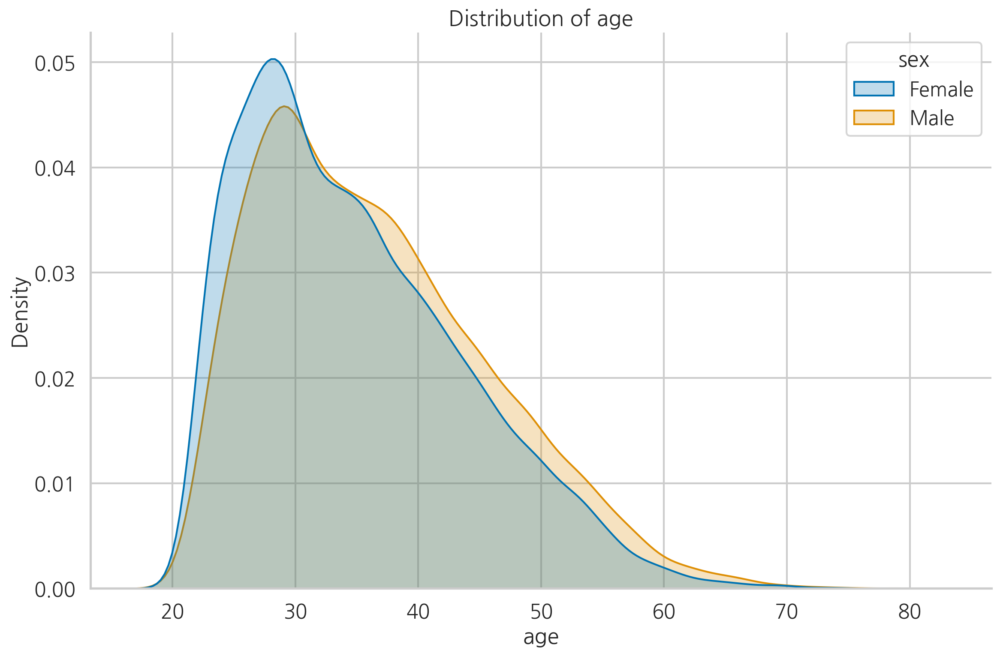

In [27]:
# seaborn의 kdeplot을 사용하여 연령 분포를 시각화
# data=df: 데이터프레임을 지정
# x="age": x축에 연령 데이터를 표시
# hue="sex": 성별에 따라 다른 색상으로 구분
# common_norm=False: 각 성별 그룹을 독립적으로 정규화
# fill=True: 곡선 아래 영역을 채움
ax = sns.kdeplot(data=df, x="age", 
                 hue="sex", common_norm=False, 
                 fill=True)

# 그래프 제목 설정
ax.set_title("Distribution of age")

# 상단과 우측 테두리 제거하여 깔끔한 시각화
sns.despine()

# 그래프 레이아웃 자동 조정
plt.tight_layout()

# 그래프 저장 코드 (현재는 주석 처리됨)
# plt.savefig("images/figure_13_1", dpi=200)

그림 13.4: 성별로 구분된 연령의 KDE 플롯

커널 밀도 추정(KDE) 플롯을 분석해보면, 성별에 따른 분포 형태의 차이가 크지 않음을 알 수 있습니다. 여성 표본이 평균적으로 약간 더 젊은 편입니다.

As mentioned in the text, we can create a histogram (together with the KDE), by running:

KDE 플롯과 함께 히스토그램은 단일 피처의 분포를 조사하는 데 있어 가장 인기 있는 방법 중 하나입니다. 히스토그램을 생성하려면 `sns.histplot` 함수를 사용할 수 있습니다. 대안으로, pandas DataFrame의 `plot` 메서드를 사용하여 kind=`hist`로 히스토그램을 생성할 수 있습니다. GitHub에 있는 동반 Jupyter 노트북에서 히스토그램 생성 방법을 더 많이 보여줍니다.

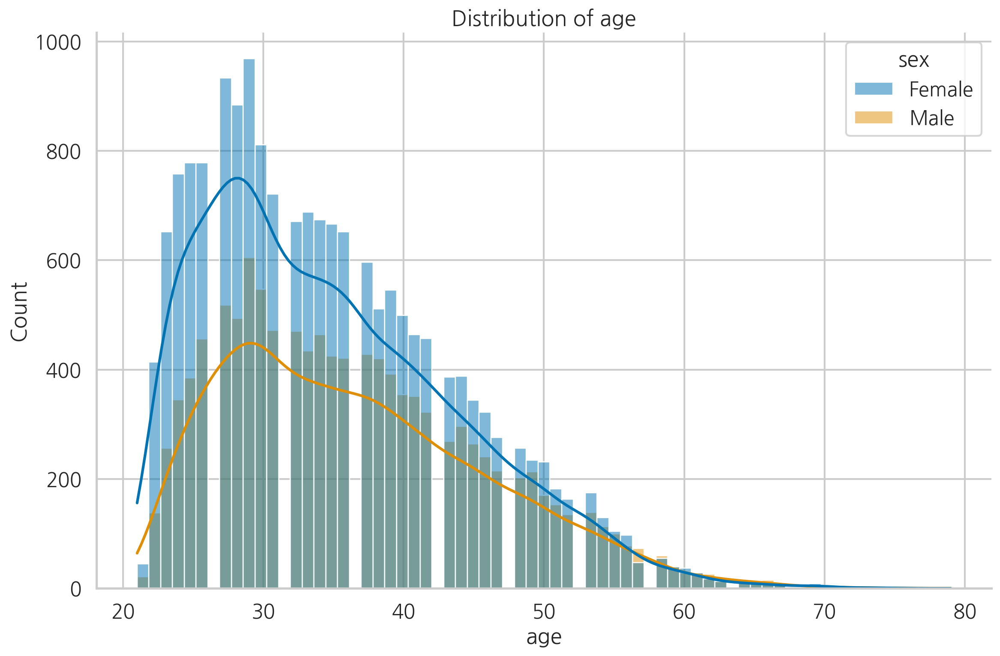

In [28]:
# seaborn의 histplot 함수를 사용하여 연령 분포를 시각화
# data=df.dropna(): 결측치가 제거된 데이터프레임 사용
# x="age": x축에 연령 데이터 표시
# hue="sex": 성별에 따라 다른 색상으로 구분
# kde=True: 커널 밀도 추정(KDE) 곡선도 함께 표시
ax = sns.histplot(data=df.dropna(), x="age", hue="sex", kde=True)

# 그래프 제목 설정
ax.set_title("Distribution of age");

# 상단과 우측 테두리 제거하여 깔끔한 시각화
sns.despine()

# 그래프 레이아웃 자동 조정
plt.tight_layout()

플롯에서 몇몇 간격이 있는 것을 발견했는데, 이는 구간화(binning) 때문입니다. 아래에서는 `sns.countplot`과 `plotly_express`를 사용하여 동일한 히스토그램을 만들었습니다. 이렇게 함으로써 각 연령값이 별도의 구간을 가지게 되어 플롯을 자세히 살펴볼 수 있습니다. 다음 플롯들에서는 그러한 급격한 변화가 없습니다:

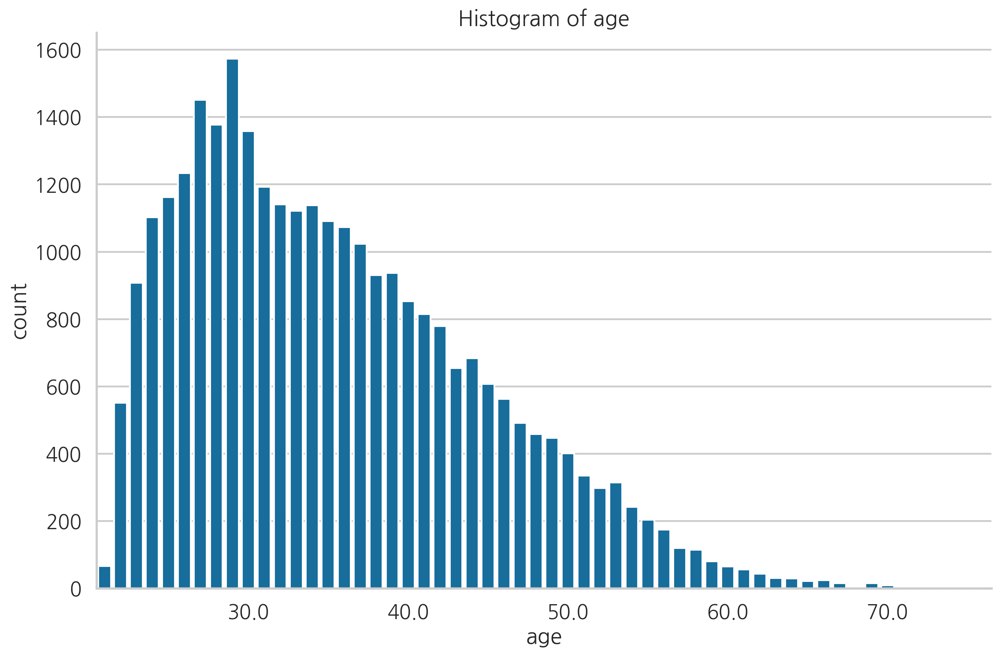

In [29]:
# seaborn의 countplot을 사용하여 연령별 빈도수를 시각화
# data=df.dropna(): 결측치가 제거된 데이터프레임 사용
# x="age": x축에 연령 표시
# color="b": 막대 색상을 파란색으로 지정
ax = sns.countplot(data=df.dropna(), x="age", color="b")

# x축 레이블 조정 - 10의 배수인 연령만 표시하여 가독성 향상
# enumerate(): 인덱스와 레이블을 함께 반복
for ind, label in enumerate(ax.get_xticklabels()):
    # 레이블 텍스트를 숫자로 변환하여 10의 배수인지 확인
    if int(float(label.get_text())) % 10 == 0:
        label.set_visible(True)  # 10의 배수는 표시
    else:
        label.set_visible(False)  # 나머지는 숨김

# 그래프 제목 설정
ax.set_title("Histogram of age")

# 상단과 우측 테두리 제거하여 깔끔한 시각화
sns.despine()

# 그래프 레이아웃 자동 조정
plt.tight_layout()

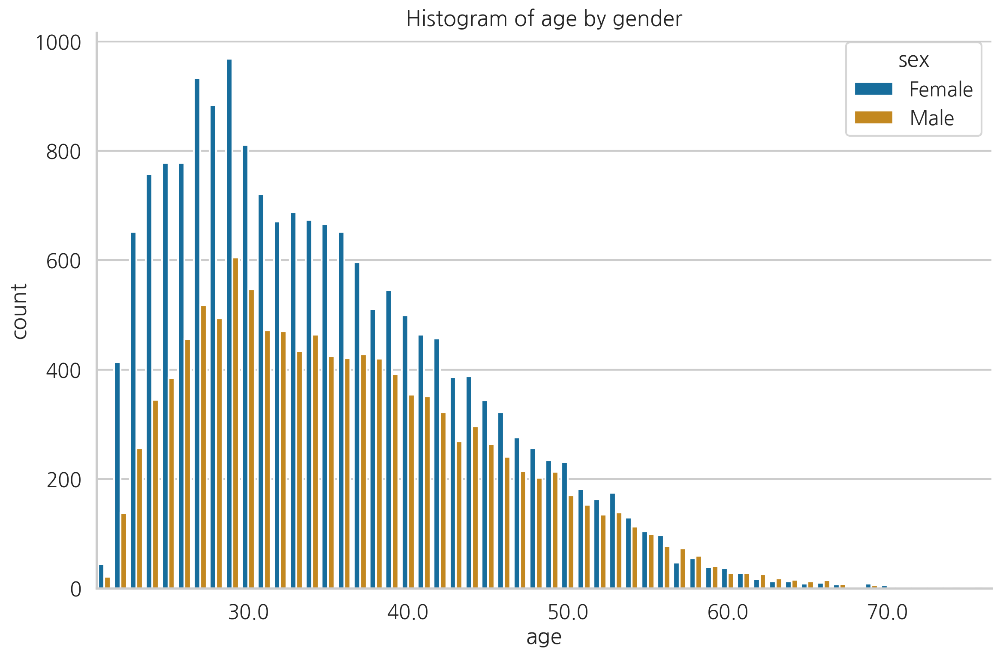

In [30]:
# seaborn의 countplot을 사용하여 성별에 따른 연령 분포를 시각화
# data=df.dropna(): 결측치가 제거된 데이터프레임 사용
# x="age": x축에 연령 표시
# hue="sex": 성별에 따라 다른 색상으로 구분
ax = sns.countplot(data=df.dropna(), x="age", hue="sex")

# x축 레이블 조정 - 가독성을 위해 10의 배수인 연령만 표시
for ind, label in enumerate(ax.get_xticklabels()):
    if int(float(label.get_text())) % 10 == 0:  # 레이블이 10의 배수인 경우
        label.set_visible(True)  # 레이블 표시
    else:
        label.set_visible(False)  # 레이블 숨김

# 그래프 제목 설정 - 성별에 따른 연령 분포를 나타냄
ax.set_title("Histogram of age by gender")

# 상단과 우측 테두리 제거하여 깔끔한 시각화
sns.despine()

# 그래프 레이아웃 자동 조정
plt.tight_layout()

In [35]:
# px.histogram(df.dropna(), x="age", color="sex", title = "Distribution of age")

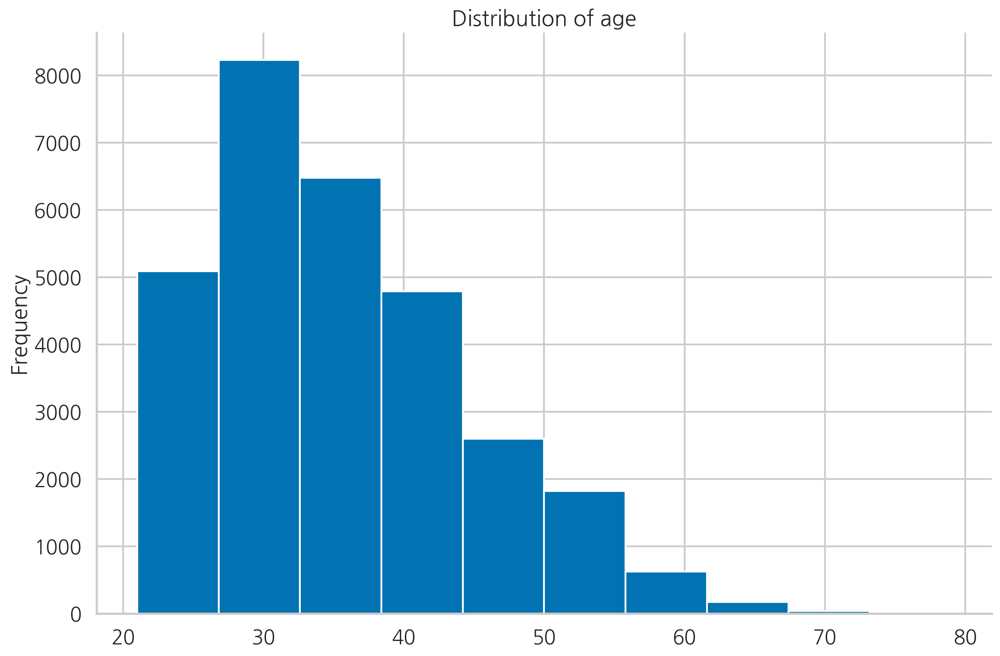

In [36]:
# pandas의 plot 메서드를 사용하여 연령 분포를 히스토그램으로 시각화
# kind="hist": 히스토그램 형태로 그래프 생성
# title: 그래프의 제목을 "Distribution of age"로 설정
df["age"].plot(kind="hist", title="Distribution of age")

# seaborn의 despine() 함수로 상단과 우측 테두리를 제거하여 깔끔한 시각화 구현
sns.despine()

# 그래프의 레이아웃을 자동으로 조정하여 보기 좋게 표시
plt.tight_layout()

5. Create a `pairplot` of selected variables:

이 분석을 확장하려면 페어플롯을 사용할 수 있습니다. 페어플롯은 두 변수 간의 관계를 보여주며, 대각선에는 히스토그램이나 KDE 플롯이 위치합니다. 이 방법을 통해 두 변수 간에 관계가 있는지 확인할 수 있습니다. 관계를 명확히 하기 위해 회귀선을 추가할 수도 있습니다.

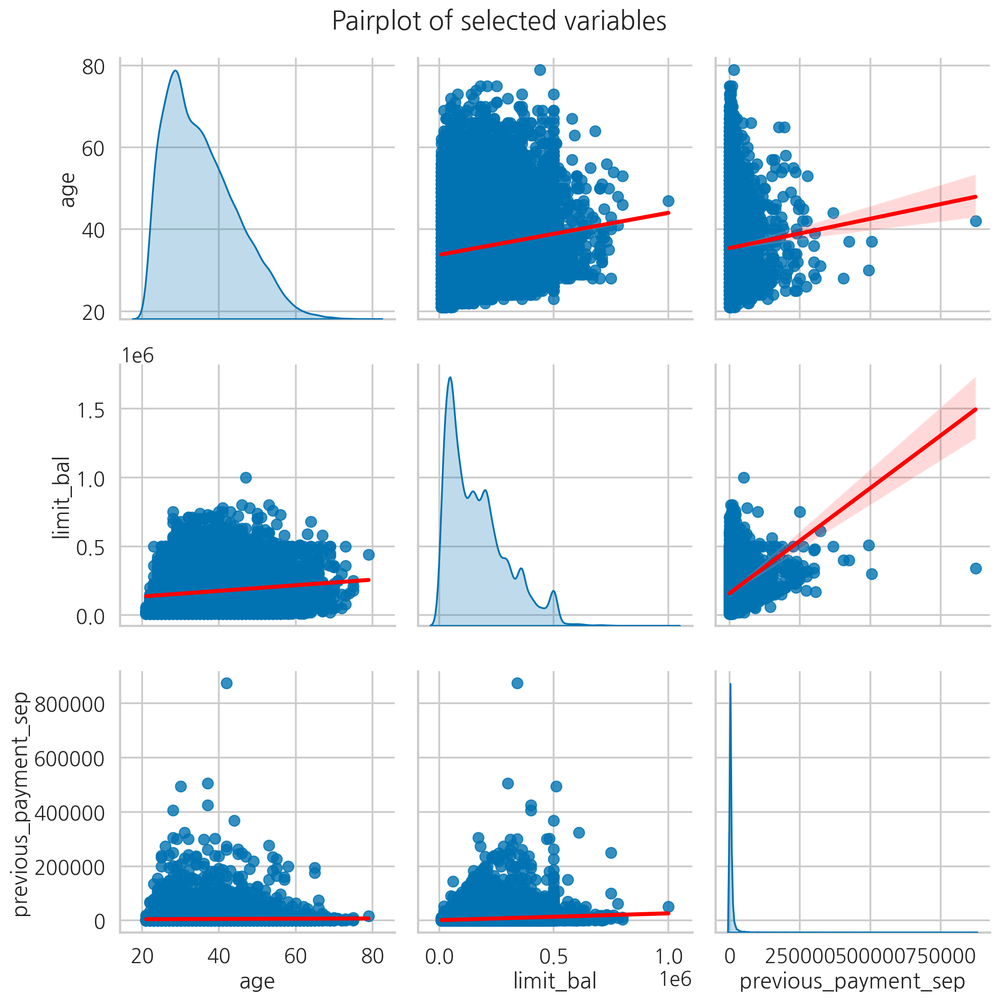

In [37]:
# 페어플롯에 표시할 변수들을 선택
# age: 연령
# limit_bal: 신용카드 한도
# previous_payment_sep: 9월 이전 결제액
COLS_TO_PLOT = ["age", "limit_bal", "previous_payment_sep"]

# seaborn의 pairplot을 사용하여 선택된 변수들의 관계를 시각화
# kind="reg": 산점도와 함께 회귀선 표시
# diag_kind="kde": 대각선에는 커널 밀도 추정(KDE) 플롯 표시
# height=4: 각 서브플롯의 크기를 4인치로 설정
# plot_kws: 회귀선의 색상을 빨간색으로 지정
pair_plot = sns.pairplot(df[COLS_TO_PLOT], kind="reg", 
                         diag_kind="kde", height=4,
                         plot_kws={"line_kws":{"color":"red"}})

# 전체 그래프의 제목 설정
pair_plot.fig.suptitle("Pairplot of selected variables")

# 상단과 우측 테두리 제거하여 깔끔한 시각화
sns.despine()

# 그래프 레이아웃 자동 조정
plt.tight_layout()

# 그래프를 파일로 저장하는 코드 (현재는 주석 처리됨)
# plt.savefig("images/figure_13_2", dpi=200)

그림 13.5: 대각선에는 KDE 플롯이, 각 산점도에는 회귀선이 있는 페어플롯

- `previous_payment_sep`의 분포는 매우 왜곡되어 있으며, 긴 꼬리를 가지고 있습니다.
- 이전 점과 연결하여, 산점도에서 `previous_payment_sep`의 매우 극단적인 값들을 관찰할 수 있습니다.
- 산점도에서 결론을 도출하기 어렵습니다. 각각에 약 30,000개의 관측값이 있기 때문입니다. 이러한 대량의 데이터를 플로팅할 때 특정 영역에서 관측값의 밀도를 더 잘 시각화하기 위해 투명한 마커를 사용할 수 있습니다.
- 이상치는 회귀선에 상당한 영향을 미칠 수 있습니다.

또한 `hue` 인자를 지정하여 성별을 구분할 수 있습니다:

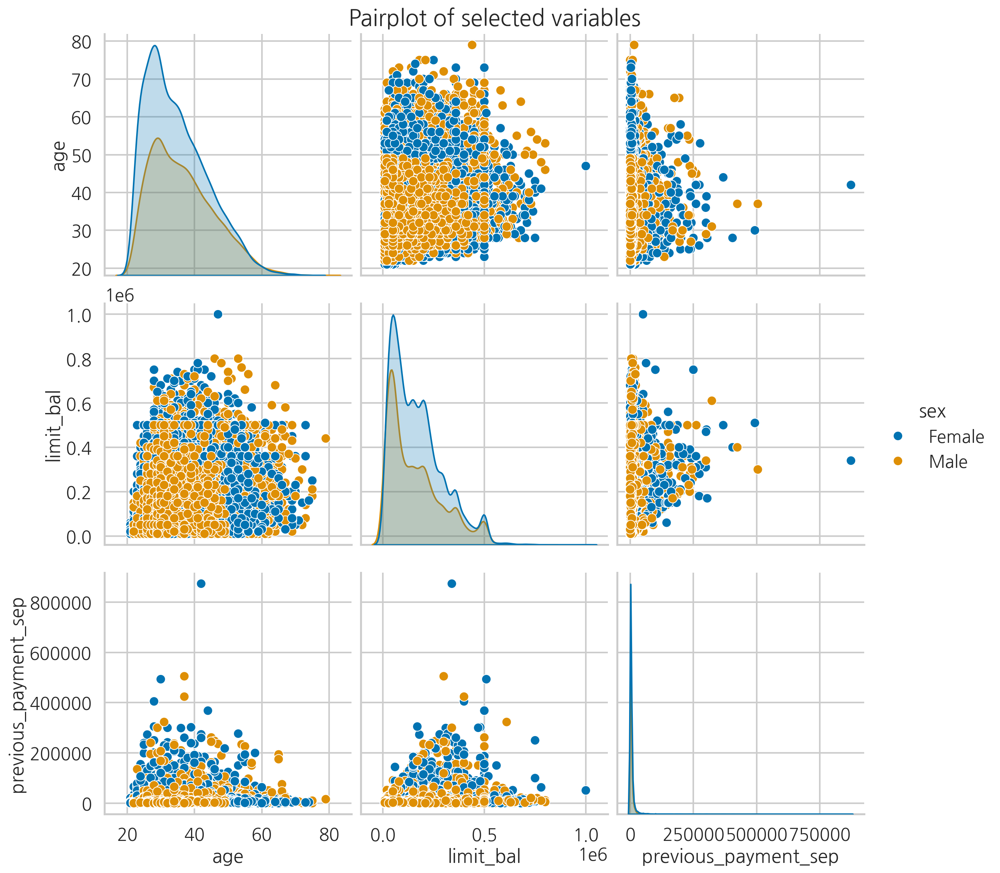

In [38]:
# seaborn의 pairplot을 사용하여 성별에 따른 변수들의 관계를 시각화
# data=df: 데이터프레임 지정
# x_vars, y_vars=COLS_TO_PLOT: x축과 y축에 표시할 변수 지정 (age, limit_bal, previous_payment_sep)
# hue="sex": 성별에 따라 다른 색상으로 표시
# height=4: 각 서브플롯의 크기를 4인치로 설정
pair_plot = sns.pairplot(data=df, 
                         x_vars=COLS_TO_PLOT, 
                         y_vars=COLS_TO_PLOT, 
                         hue="sex", 
                         height=4)

# 전체 그래프의 제목 설정
pair_plot.fig.suptitle("Pairplot of selected variables")

# 제목과 그래프 사이의 간격 조정 (top=0.95는 상단 여백을 5%로 설정)
plt.subplots_adjust(top=0.95)

# 그래프를 파일로 저장하는 코드 (현재는 주석 처리됨)
# plt.savefig("images/figure_13_3", dpi=200)

그림 13.6: 성별에 따른 개별 마커를 사용한 페어플롯

성별로 나눈 대각선 플롯에서 몇 가지 추가적인 통찰을 얻을 수 있지만, 플로팅된 데이터의 방대한 양으로 인해 산점도는 여전히 읽기 어렵습니다.

잠재적인 해결책으로 전체 데이터셋에서 무작위로 샘플링하여 선택된 관측값만 플로팅할 수 있습니다. 그러나 이러한 접근 방식의 단점은 극단적인 값(이상치)을 포함한 일부 관측값을 놓칠 수 있다는 점입니다.

6. Analyze the relationship between age and limit balance:

또한 `sns.jointplot`을 사용하여 두 변수 간의 관계를 조사할 수 있습니다. 이는 산점도와 KDE 플롯 또는 히스토그램을 결합하여 단변량 분포를 분석하는 데 사용됩니다. 6단계에서는 나이와 신용 한도 사이의 관계를 분석합니다.

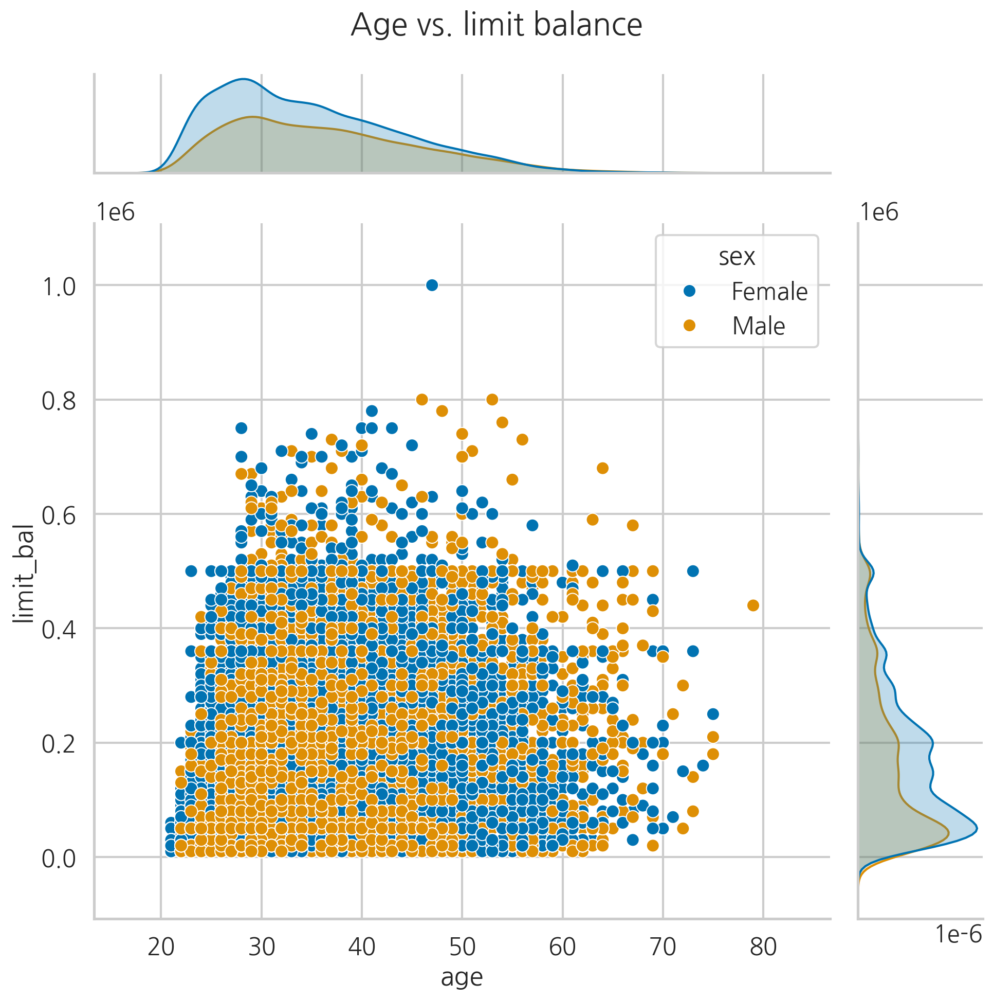

In [39]:
# seaborn의 jointplot을 사용하여 나이와 신용한도의 관계를 시각화
# data=df: 데이터프레임 지정
# x="age": x축은 나이
# y="limit_bal": y축은 신용한도
# hue="sex": 성별에 따라 다른 색상으로 표시
# height=10: 그래프의 크기를 10인치로 설정
ax = sns.jointplot(data=df, x="age", y="limit_bal", 
                   hue="sex", height=10)

# 그래프의 제목 설정
ax.fig.suptitle("Age vs. limit balance")

# 테두리 제거 (위쪽과 오른쪽 테두리)
sns.despine()

# 그래프의 레이아웃 자동 조정
plt.tight_layout()

# 그래프를 파일로 저장하는 코드 (현재는 주석 처리됨)
# plt.savefig("images/figure_13_4", dpi=200)

그림 13.7: 성별로 그룹화된 나이와 신용 한도 사이의 관계를 보여주는 조인트 플롯

조인트 플롯은 상당히 많은 유용한 정보를 제공합니다. 먼저, 산점도에서 두 변수 간의 관계를 확인할 수 있습니다. 또한 축을 따라 KDE 플롯을 사용하여 두 변수의 분포를 개별적으로 조사할 수도 있습니다(또는 히스토그램을 대신 플로팅할 수도 있습니다).


7. Define and run a function for plotting the correlation heatmap:

7단계에서는 상관 행렬을 플로팅하는 함수를 정의하여 상관 관계를 분석합니다. 함수는 주어진 상관 행렬을 플롯하는 데 필요한 몇 가지 연산을 사용합니다. `mask` 인수를 사용하여 삼각 행렬의 상단을 마스킹하며, `annot` 인수를 사용하여 열을 이해하기 쉽게 설명을 추가합니다. 그러나 분석된 피처가 많지 않은 경우에만 이를 수행하는 것이 좋습니다. 피처가 많으면 그래프가 이해하기 어렵기 때문입니다.

상관 관계를 계산하기 위해 DataFrame의 `corr` 메서드를 사용합니다. 기본적으로 이는 피어슨(Pearson)의 상관 계수를 계산합니다. 우리는 이를 숫자형 피처에만 적용합니다. 범주형 피처의 상관 계수를 계산하는 방법도 있으며, 몇 가지는 **There’s more…** 섹션에서 언급합니다. 상관 관계를 검토하는 것은 특히 선형 독립성을 가정하는 머신러닝 알고리즘을 사용할 때 중요합니다.

In [41]:
def plot_correlation_matrix(corr_mat, annotate=False):
    """
    상관관계 히트맵을 그리는 함수입니다. 불필요한 부분은 마스킹 처리합니다.
    
    Parameters
    ----------
    corr_mat : pd.DataFrame
        특성들 간의 상관관계 행렬
    annotate : bool, default=False
        상관계수 값을 히트맵에 표시할지 여부
    """
    
    # seaborn 스타일을 일시적으로 흰색 배경으로 변경
    sns.set(style="white")
    
    # 상관행렬의 상단 삼각형 부분을 마스킹하기 위한 마스크 생성
    # np.zeros_like로 corr_mat과 같은 크기의 False로 채워진 배열 생성
    mask = np.zeros_like(corr_mat, dtype=bool)
    # 상단 삼각형 부분을 True로 설정하여 마스킹
    mask[np.triu_indices_from(mask)] = True
    
    # matplotlib 그림 객체 생성
    fig, ax = plt.subplots()
    
    # 발산형 컬러맵 생성 (240도->10도 색상, 9단계)
    cmap = sns.diverging_palette(240, 10, n=9, as_cmap=True)
    
    # 히트맵 그리기
    # mask: 상단 삼각형 마스킹
    # cmap: 위에서 정의한 컬러맵 사용
    # annot: annotate 파라미터에 따라 값 표시 여부 결정
    # vmax: 색상 스케일의 최대값을 0.3으로 제한
    # center: 컬러맵의 중심값을 0으로 설정
    # square: 정사각형 셀로 표시
    sns.heatmap(corr_mat, mask=mask, cmap=cmap, 
                annot=annotate, vmax=.3, 
                center=0, square=True, linewidths=.5, 
                cbar_kws={"shrink": .5}, ax=ax)
    
    # 그래프 제목 설정
    ax.set_title("Correlation Matrix", fontsize=16)
    
    # seaborn 스타일을 다시 darkgrid로 변경
    sns.set(style="darkgrid")

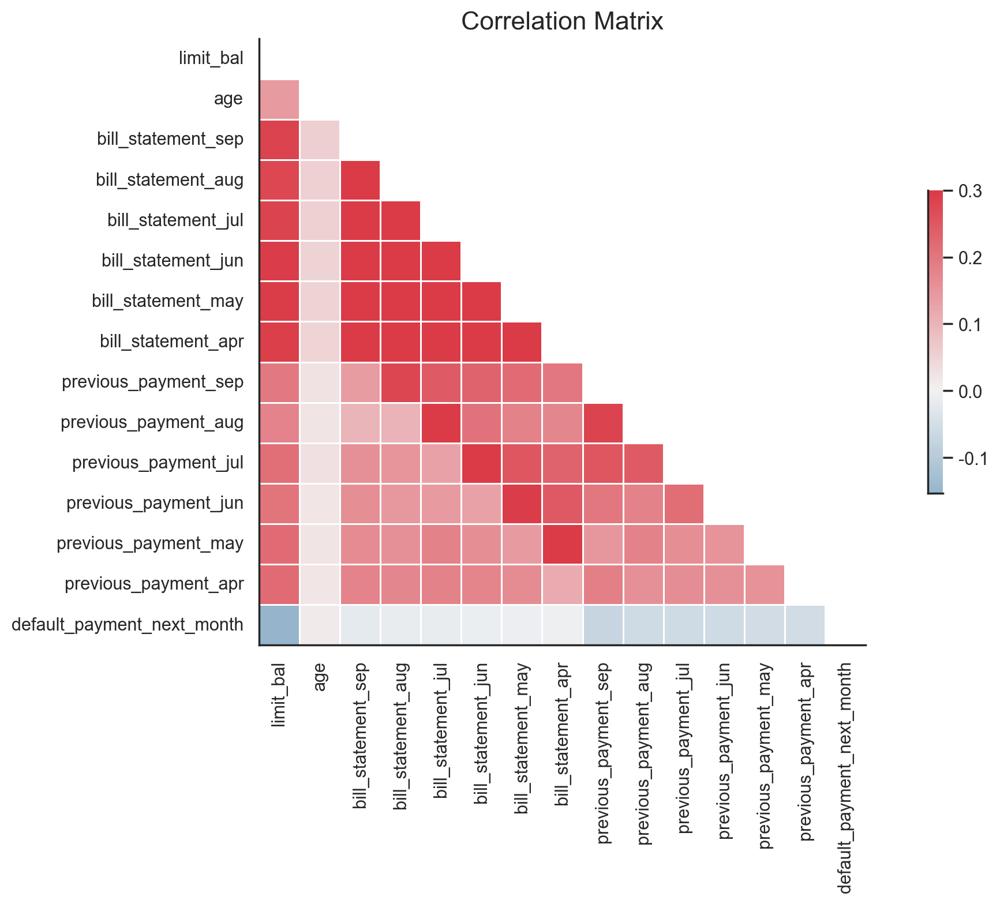

In [42]:
# 수치형 특성들의 상관관계 행렬 계산
# select_dtypes(include="number")로 수치형 열만 선택하여 상관계수 계산
corr_mat = df.select_dtypes(include="number").corr()    

# 앞서 정의한 plot_correlation_matrix 함수를 사용하여 상관관계 히트맵 시각화
plot_correlation_matrix(corr_mat)

# 그래프의 테두리 제거 (상단과 우측 테두리)
sns.despine()

# 그래프의 레이아웃 자동 조정
plt.tight_layout()

# 그래프 저장 코드 (현재는 주석 처리됨)
# plt.savefig("images/figure_13_5", dpi=200)

그림 13.8: 수치형 특성들의 상관관계 히트맵

나이(age)는 다른 특성들과 상관관계가 없는 것으로 보입니다.

특성(수치형)과 타겟 변수 간의 상관관계를 직접 확인할 수 있습니다:

In [43]:
df.select_dtypes(include="number").corr()[["default_payment_next_month"]]

,default_payment_next_month
limit_bal,-0.153520
age,0.014491
bill_statement_sep,-0.019644
bill_statement_aug,-0.014193
bill_statement_jul,-0.014076
bill_statement_jun,-0.010156
bill_statement_may,-0.006760
bill_statement_apr,-0.005372
previous_payment_sep,-0.072929
previous_payment_aug,-0.058579


8. Analyze the distribution of age in groups using boxplots:

8단계에서는 연령 분포를 결혼 상태와 성별에 따라 조사하기 위해 박스 플롯을 사용합니다. 박스 플롯(상자-수염 플롯이라고도 함)은 범주형 변수의 여러 수준을 비교하는 방식으로 데이터의 분포를 표시합니다. 박스 플롯은 다음과 같은 5가지 요약 통계를 사용하여 데이터의 분포에 대한 정보를 제공합니다:

- 중앙값(50번째 백분위수) — 상자 안의 가로 검정 선으로 표시됩니다.
- 사분위 범위(IQR) — 상자로 표시되며, 첫 번째 사분위수(25번째 백분위수)와 세 번째 사분위수(75번째 백분위수) 사이의 범위를 나타냅니다.
- 수염(whiskers) — 상자에서 뻗어 나오는 선으로 표시됩니다. 수염의 극단 값(가로 선으로 표시)은 첫 번째 사분위수 - 1.5 IQR과 세 번째 사분위수 + 1.5 IQR로 정의됩니다.

박스 플롯을 통해 데이터에 대해 다음과 같은 통찰을 얻을 수 있습니다:

- 수염 바깥쪽에 표시된 점들은 이상치로 간주할 수 있습니다. 이 방법은 터키의 울타리(Tukey’s fences)라고 하며 가장 간단한 이상치 탐지 기법 중 하나입니다. 간단히 말해, [Q1 - 1.5 IQR, Q3 + 1.5 IQR] 범위를 벗어난 관측값을 이상치로 가정합니다.
- 분포의 잠재적 비대칭성. 중앙값이 상자의 하한선에 가까울수록 분포는 오른쪽으로 치우치며(양의 왜도), 중앙값이 상자의 상한선에 가까울수록 왼쪽으로 치우칩니다. **그림 13.13**은 이를 설명합니다.

<img src="./image/fig_13_13.PNG" width="500">

**그림 13.13: 박스 플롯을 사용하여 분포의 왜도를 결정**

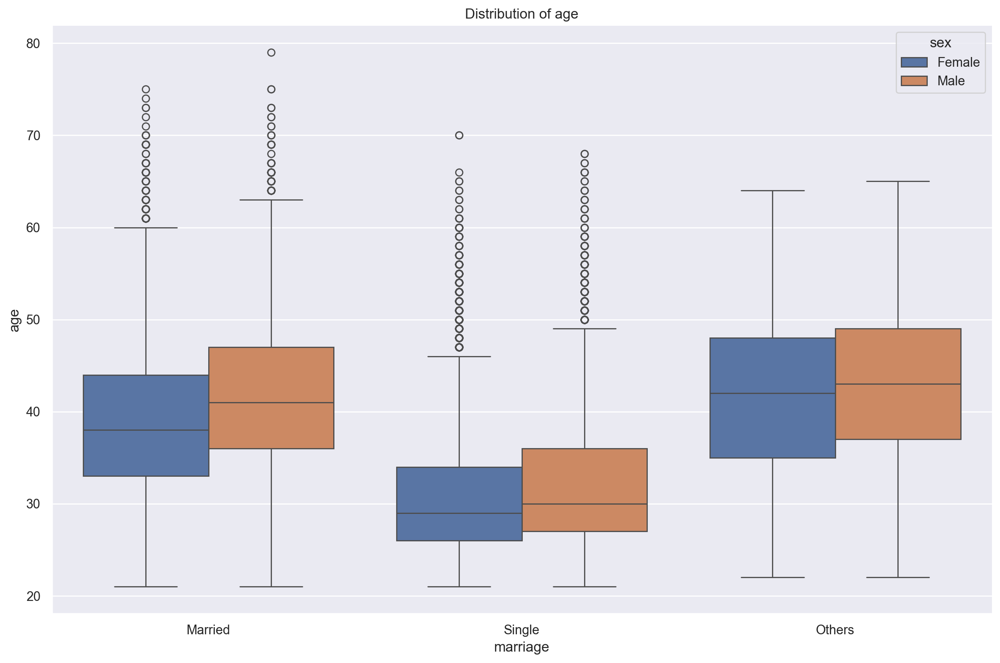

In [44]:
# 결혼 상태와 성별에 따른 나이 분포를 박스플롯으로 시각화
# data: 데이터프레임
# y: y축에 표시할 연령 변수 
# x: x축에 표시할 결혼상태 변수
# hue: 성별로 구분하여 색상 표시
ax = sns.boxplot(data=df, y="age", x="marriage", hue="sex")

# 그래프 제목 설정 
ax.set_title("Distribution of age")

# 그래프의 상단과 우측 테두리 제거
sns.despine()

# 그래프 레이아웃 자동 조정
plt.tight_layout()

# 그래프 저장 코드 (현재는 주석 처리됨)
# plt.savefig("images/figure_13_6", dpi=200)

그림 13.9: 결혼 상태와 성별에 따른 나이 분포
 
결혼 상태 그룹 내에서 분포가 매우 유사해 보이며, 남성의 중간 연령이 항상 더 높습니다.

9. Plot the distribution of limit balance for each gender and education level:

9단계에서, 교육 수준과 성별에 따른 신용 한도 피처의 분포를 조사하기 위해 바이올린 플롯을 사용합니다. `sns.violinplot`을 사용하여 이를 생성하며, `x` 인수에 교육 수준을 지정하고 `hue="sex"` 및 `split=True`를 설정합니다. 이를 통해 바이올린 플롯의 각 절반이 서로 다른 성별을 나타내게 됩니다.

일반적으로 바이올린 플롯은 박스 플롯과 매우 유사하며, 다음과 같은 정보를 제공합니다:

- 중앙값은 흰 점으로 표시됩니다.
- 사분위 범위는 바이올린의 중심에 있는 검은 막대로 표시됩니다.
- 상위 및 하위 인접 값은 막대에서 뻗어 나가는 검정 선으로 표시됩니다. 하위 인접 값은 첫 번째 사분위수 - 1.5 IQR로 정의되며, 상위 인접 값은 세 번째 사분위수 + 1.5 IQR로 정의됩니다. 이 인접 값을 사용하여 단순한 이상치 탐지 기법으로 활용할 수 있습니다.

바이올린 플롯은 박스 플롯과 KDE 플롯을 결합한 것으로, 분포의 형태를 더 명확히 보여준다는 점이 장점입니다. 이는 특히 여러 개의 봉우리가 있는 다봉 분포(예: 대학원 수준 교육을 받은 카테고리의 신용 한도 바이올린)에서 유용합니다.

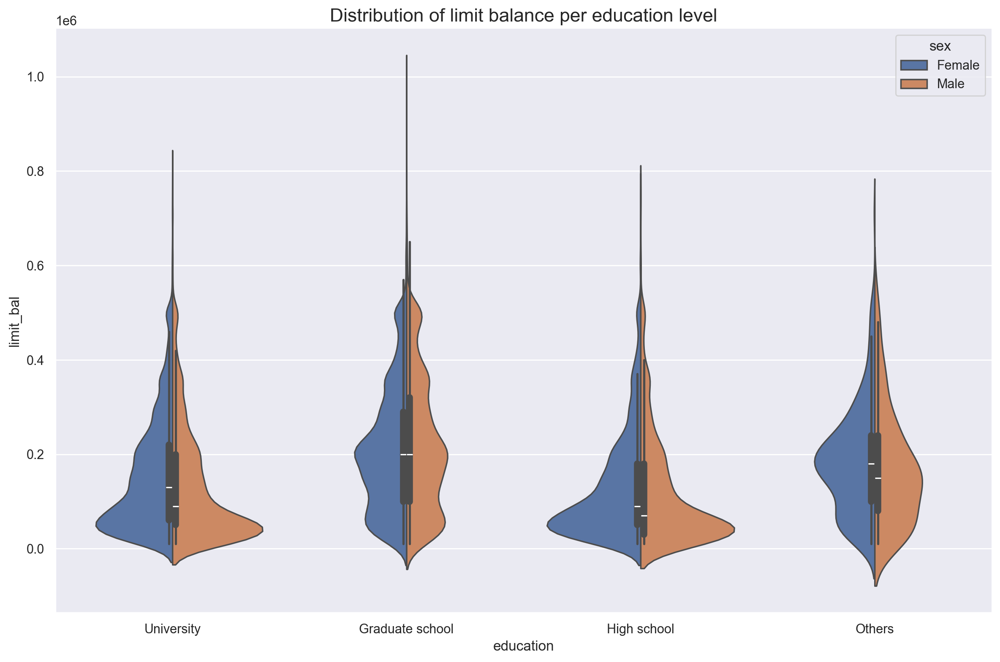

In [45]:
# seaborn의 violinplot을 사용하여 교육 수준별, 성별 신용한도 분포를 시각화
# x축: 교육 수준(education)
# y축: 신용한도(limit_bal)
# hue: 성별로 구분(sex)
# split=True: 바이올린 플롯을 성별로 나누어 표시
ax = sns.violinplot(x="education", y="limit_bal", 
                    hue="sex", split=True, data=df)

# 그래프 제목 설정 (글자 크기 16)
ax.set_title(
    "Distribution of limit balance per education level", 
    fontsize=16
)

# 그래프의 상단과 우측 테두리 제거
sns.despine()

# 그래프 레이아웃 자동 조정
plt.tight_layout()

# 그래프 저장 코드 (현재는 주석 처리됨)
# plt.savefig("images/figure_13_7", dpi=200)

그림 13.10: 교육 수준과 성별에 따른 신용 한도 분포

플롯을 검사하면 몇 가지 흥미로운 패턴이 나타납니다:

- 가장 큰 신용 한도는 대학원 수준의 교육을 받은 그룹에서 나타납니다.
- 분포의 모양은 교육 수준별로 다릅니다. 대학원 수준은 기타 범주와 유사하고, 고등학교 수준은 대학 수준과 유사합니다.
- 일반적으로 성별 간 차이는 거의 없습니다.

다음 코드는 바이올린 플롯을 분할하지 않고 동일한 정보를 표시합니다.

split=False인 경우:
- 각 교육 수준과 성별 조합마다 별도의 바이올린이 생성됩니다
- 바이올린이 분할되지 않고 온전한 형태로 표시됩니다

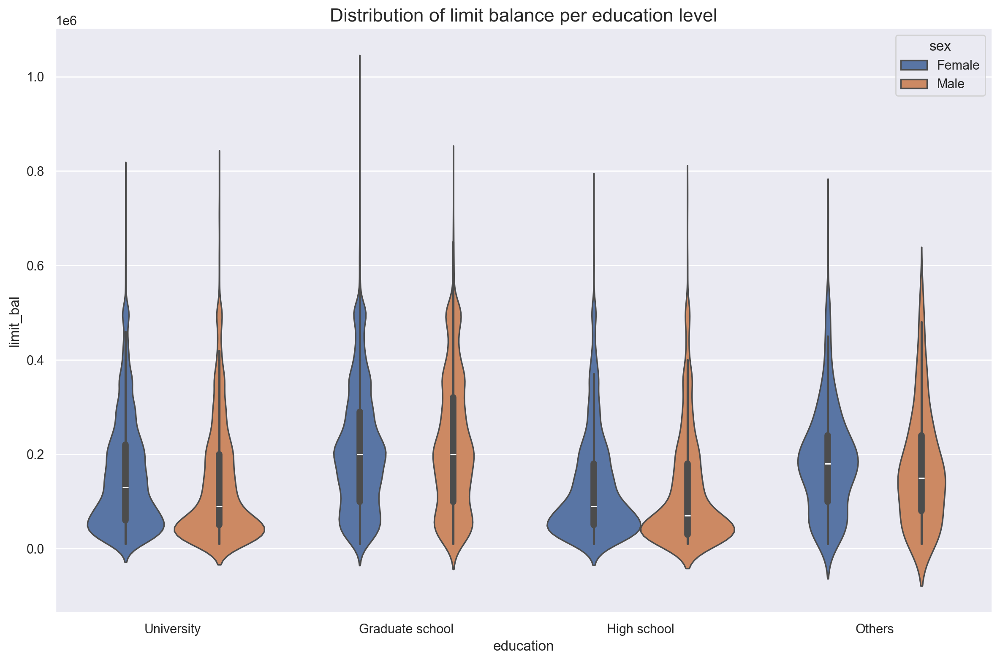

In [47]:
# seaborn의 violinplot을 사용하여 교육 수준별 신용한도 분포를 시각화합니다
# x축은 교육 수준, y축은 신용한도이며 성별로 구분하여 표시합니다
ax = sns.violinplot(x="education", y="limit_bal", 
                    hue="sex", data=df, split=False)

# 그래프의 제목을 설정합니다 (글자 크기 16)
ax.set_title("Distribution of limit balance per education level", 
             fontsize=16)

# 그래프의 상단과 우측 테두리를 제거하여 깔끔한 시각화를 구현합니다
sns.despine()

# 그래프의 레이아웃을 자동으로 조정하여 보기 좋게 만듭니다
plt.tight_layout()

10. Investigate the distribution of the target variable per gender and education level:


마지막 두 단계에서는 성별과 교육 수준별로 목표 변수(불이행)의 분포를 조사합니다. 첫 번째 경우에서는 `sns.countplot`을 사용하여 각 성별에 대한 두 가지 가능한 결과의 발생 횟수를 표시합니다. 

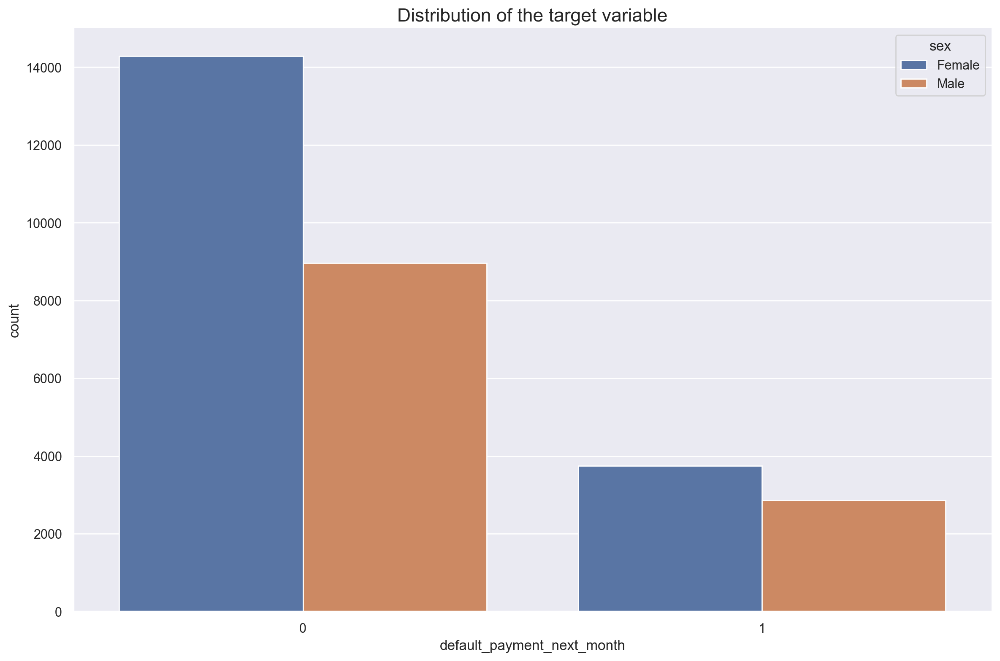

In [49]:
# ax = sns.countplot("default_payment_next_month", hue="sex", 
#                    data=df, orient="h")
# ax.set_title("Distribution of the target variable", fontsize=16)

# seaborn의 countplot을 사용하여 채무불이행 여부에 따른 성별 분포를 시각화
# data: 데이터프레임, x: x축 변수(채무불이행), hue: 색상 구분 변수(성별)
ax = sns.countplot(data=df, x="default_payment_next_month", hue="sex")

# 그래프 제목 설정 (글자 크기 16)
ax.set_title("Distribution of the target variable", fontsize=16)

# 그래프의 상단과 우측 테두리 제거
sns.despine()

# 그래프 레이아웃 자동 조정
plt.tight_layout()

그림 13.11: 성별에 따른 목표 변수의 분포
 
플롯을 분석해보면, 남성 고객들의 채무불이행 비율이 더 높다는 것을 알 수 있습니다.

11. Investigate the percentage of defaults per education level:

두 번째 경우에는 다른 접근 방식을 선택합니다. 교육 수준별로 불이행 비율을 플로팅하고자 했으며, 그룹 간의 백분율을 비교하는 것이 명목 값을 비교하는 것보다 더 유용하기 때문입니다. 이를 위해 먼저 교육 수준별로 그룹화한 다음 관심 변수를 선택하고, 각 그룹의 백분율을 계산(`value_counts(normalize=True)` 메서드 사용)한 후 멀티 인덱스를 제거하여(`unstacked`) 이미 익숙한 `plot` 메서드를 사용하여 플롯을 생성합니다.

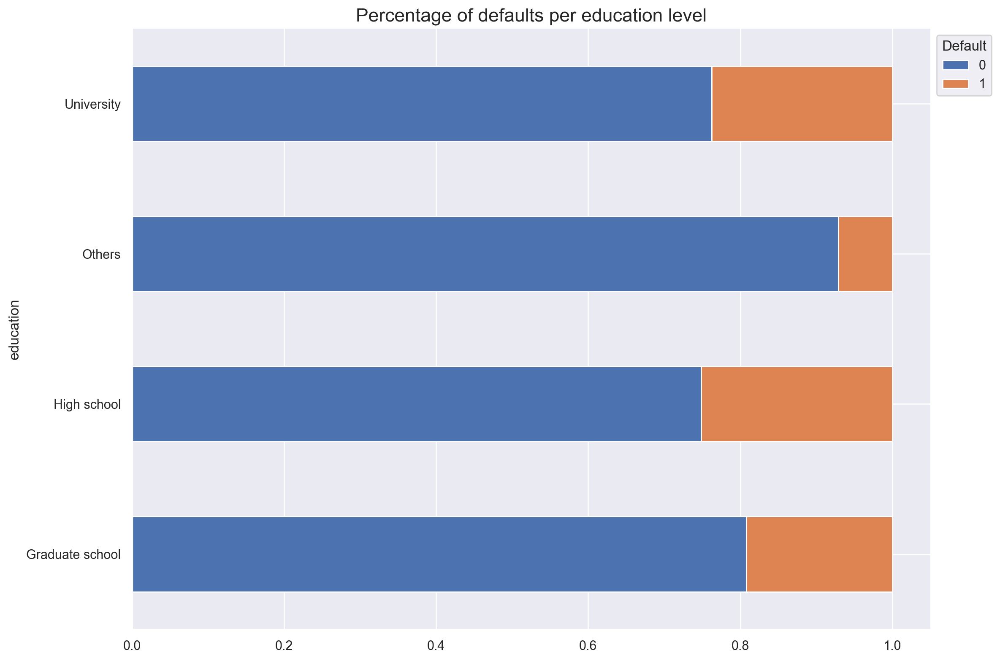

In [50]:
# 교육 수준별 채무불이행 비율을 시각화하는 코드
# 1. df.groupby("education"): 교육 수준별로 데이터를 그룹화
# 2. ["default_payment_next_month"]: 채무불이행 변수 선택
# 3. value_counts(normalize=True): 각 그룹별 비율 계산
# 4. unstack(): 멀티인덱스를 2차원 데이터프레임으로 변환
# 5. plot(kind="barh", stacked=True): 누적 가로 막대 그래프로 시각화
ax = df.groupby("education")["default_payment_next_month"] \
       .value_counts(normalize=True) \
       .unstack() \
       .plot(kind="barh", stacked=True)

# 그래프 제목 설정 (글자 크기 16)
ax.set_title("Percentage of defaults per education level", 
             fontsize=16)

# 범례 설정 - 제목을 "Default"로 하고 그래프 우측 상단에 위치
ax.legend(title="Default", bbox_to_anchor=(1,1)) 

# 그래프의 상단과 우측 테두리 제거
sns.despine()

# 그래프 레이아웃 자동 조정
plt.tight_layout()

# 그래프 저장 코드 (현재는 주석 처리)
# plt.savefig("images/figure_13_9", dpi=200)

그림 13.12: 교육 수준별 채무불이행 비율

상대적으로 고등학교 교육을 받은 고객들 사이에서 가장 많은 채무불이행이 발생하며, '기타' 범주에서 가장 적은 채무불이행이 발생합니다.

### There's more

이 예제에서는 주어진 데이터를 조사하기 위한 다양한 접근 방식을 소개했습니다. 하지만 EDA를 수행할 때마다 여러 줄의 코드(반복되는 코드가 많음)가 필요합니다. 다행히도, 이 과정을 단순화하는 파이썬 라이브러리가 있습니다. 이 라이브러리는 `pandas_profiling`이라고 하며, 한 줄의 코드만으로 데이터셋에 대한 포괄적인 요약을 HTML 보고서 형태로 생성합니다.

보고서를 생성하려면 다음 코드를 실행해야 합니다:

In [52]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df, title="Loan Default Dataset EDA")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

그림 13.14: 신용 한도 피처에 대한 심층 분석 예시

이 보고서는 매우 포괄적이며 유용한 정보를 많이 포함하고 있습니다. 간략히 설명하기 위해 보고서의 일부 선택된 요소만 다룹니다:

- DataFrame의 크기 정보 개요(피처/행 수, 누락 값, 중복 행, 메모리 크기, 데이터 유형별 분석).
- 데이터에 대한 잠재적 문제에 대한 경고, 예를 들어, 중복 행 비율이 높거나, 높은 상관관계를 가지는 피처(중복 가능성 있음), 0 값의 비율이 높은 피처, 왜도가 높은 피처 등.
- 상관계수의 다양한 측정값: 스피어만의 ρ(Spearman’s ρ), 피어슨의 r(Pearson’s r), 켄달의 τ(Kendall’s τ), 크래머의 V(Cramér’s V), 그리고 Phi_K(Φ<sub>K</sub>). 마지막 Phi_K(Φ<sub>K</sub>)는 특히 흥미롭습니다. 이는 범주형, 순서형, 그리고 구간형 변수를 일관되게 지원하는 최신 상관계수로, 비선형 종속성까지 포착합니다. 이 메트릭에 대한 참조 논문은 **See also** 섹션을 참조하세요.
- 누락된 값에 대한 세부 분석.
- 각 피처의 상세 단변량 분석(보고서에서 **Toggle details**을 클릭하여 더 많은 세부 정보를 확인할 수 있습니다).

`pandas_profiling`은 Python의 EDA 라이브러리 중 가장 인기 있는 라이브러리입니다. 하지만 유일한 옵션은 아니며, 다음의 라이브러리도 탐구해 볼 수 있습니다:

- **sweetviz** — [https://github.com/fbdesignpro/sweetviz](https://github.com/fbdesignpro/sweetviz)
- **autoviz** — [https://github.com/AutoViML/AutoViz](https://github.com/AutoViML/AutoViz)
- **dtale** — [https://github.com/man-group/dtale](https://github.com/man-group/dtale)
- **dataprep** — [https://github.com/sfu-db/dataprep](https://github.com/sfu-db/dataprep)
- **lux** — [https://github.com/lux-org/lux](https://github.com/lux-org/lux)

각 라이브러리는 EDA를 약간 다르게 접근합니다. 따라서 모든 라이브러리를 탐색하고 필요에 가장 적합한 도구를 선택하는 것이 좋습니다.



> `pandas_profiling`에 새로 추가된 `profile_report` 메서드를 사용하여 pandas DataFrame의 프로필을 생성할 수도 있습니다.

실용적인 이유로, 보고서를 HTML 파일로 저장하고 Jupyter 노트북 대신 브라우저에서 검사하는 것이 더 편리할 수 있습니다. 다음 코드 스니펫을 사용하여 쉽게 저장할 수 있습니다:

In [51]:
profile.to_file("loan_default_eda.html")

Export report to file: 100%|██████████| 1/1 [00:00<00:00, 56.31it/s]


In [53]:
profile.to_file("loan_default_eda.json")

Render JSON:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## 13.3 Splitting the data into training and test sets

**데이터 학습 및 테스트 세트로 분할하기**

탐색적 데이터 분석(EDA)을 완료한 후, 다음 단계는 데이터 세트를 학습용과 테스트용으로 분할하는 것입니다. 두 개의 별도 데이터 세트를 가지는 것이 목표입니다:

- **학습 세트** - 이 부분의 데이터로 머신러닝 모델을 학습시킵니다.
- **테스트 세트** - 이 부분의 데이터는 학습 중 모델이 보지 않은 데이터로, 모델의 성능을 평가하는 데 사용됩니다.

이러한 방식으로 데이터를 분할하는 이유는 **과적합**을 방지하기 위해서입니다. 과적합은 모델이 학습에 사용된 데이터에서 너무 많은 패턴을 찾아내어 해당 데이터에만 잘 작동하고 새로운 데이터에 대해 일반화하지 못하는 현상을 말합니다.

이 과정은 분석에서 매우 중요한 단계입니다. 잘못 수행할 경우, **데이터 누수**와 같은 형태로 편향이 도입될 수 있습니다. 데이터 누수는 학습 단계에서 모델이 접근할 수 없는 정보를 관찰할 때 발생할 수 있습니다. 예를 들어, 결측값을 채우는 일반적인 방법으로는 해당 특성의 평균값을 사용하는 것이 있습니다. 만약 데이터를 분할하기 전에 이 작업을 수행했다면, 테스트 세트의 데이터를 평균 계산에 포함하게 되어 누수가 발생할 것입니다. 따라서 올바른 순서는 데이터를 학습용과 테스트용으로 먼저 분할한 다음, 학습 세트에서 관찰된 데이터를 사용해 결측값을 채우는 것입니다. 이는 이상값 규칙 설정에도 동일하게 적용됩니다.

또한, 데이터를 분할함으로써 미래의 미확인 데이터(이 경우, 모델에 의해 점수가 매겨질 새로운 고객)가 테스트 세트의 데이터와 동일한 방식으로 처리되도록 보장할 수 있습니다.

### Getting ready

In [4]:
import pandas as pd
df = pd.read_csv("./datasets/credit_card_default.csv", na_values="")

### How to do it...

1. Import the libraries:

In [5]:
import pandas as pd
from sklearn.model_selection import train_test_split

2. Separate the target from the features:

라이브러리를 가져온 후, pandas 데이터프레임의 `pop` 메서드를 사용하여 타겟을 특징(feature)에서 분리합니다.

In [6]:
X = df.copy()
y = X.pop("default_payment_next_month")

3. Split the data into training and test sets:

3단계에서는 가장 기본적인 분할 방법을 보여줍니다. `train_test_split` 함수에 `X`와 `y` 객체를 전달합니다. 추가적으로, 모든 관측값의 비율로 테스트 세트의 크기를 지정합니다. 재현성을 위해 랜덤 상태도 지정합니다. 함수의 출력을 네 개의 새 객체에 할당해야 합니다.

In [7]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

4. Split the data into training and test sets without shuffling:

4단계에서는 다른 접근 방식을 취합니다. `test_size=0.2`와 `shuffle=False`를 지정하여 데이터의 처음 80%를 학습 세트로, 나머지 20%를 테스트 세트로 할당합니다. 이는 관측값이 사용 가능해지는 순서를 유지하고 싶을 때 유용할 수 있습니다.

In [8]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, shuffle=False
)

5. Split the data into training and test sets with stratification:

5단계에서는 타겟 변수(`stratify=y`)를 전달하여 층화(stratification) 인수를 지정합니다. 층화하여 데이터를 분할하면 학습 세트와 테스트 세트 모두 지정된 변수의 거의 동일한 분포를 가지게 됩니다. 이는 데이터 불균형이 있는 경우, 예를 들어 사기 탐지의 경우 매우 중요합니다. 데이터의 99%가 정상이고 1%만이 사기인 경우, 무작위 분할을 하면 학습 세트에 사기 케이스가 하나도 포함되지 않을 수 있습니다. 이 때문에 불균형 데이터와 작업할 때는 올바르게 분할하는 것이 중요합니다.

In [9]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

6. Verify that the ratio of the target is preserved:

마지막 단계에서는 층화된 학습/테스트 분할이 두 데이터 세트에서 동일한 기본값 비율을 가지는지 확인합니다. 이를 확인하기 위해 pandas 데이터프레임의 `value_counts` 메서드를 사용합니다.

이 장의 나머지 부분에서는 층화된 분할에서 얻은 데이터를 사용합니다.

In [10]:
print("Target distribution - train")
print(y_train.value_counts(normalize=True).values)
print("Target distribution - test")
print(y_test.value_counts(normalize=True).values)

Target distribution - train
[0.77879167 0.22120833]
Target distribution - test
[0.77883333 0.22116667]


### There's more

데이터를 세 가지 세트로 나누는 것도 일반적입니다: 학습, 검증, 테스트. **검증 세트**는 모델의 하이퍼파라미터를 자주 평가하고 조정하는 데 사용됩니다. 예를 들어, 의사결정 트리 분류기를 학습시키고, 트리의 최대 깊이를 결정하는 `max_depth` 하이퍼파라미터의 최적 값을 찾고자 한다고 가정합니다.

이를 위해 학습 세트를 사용하여 여러 번 모델을 학습시킬 수 있으며, 매번 다른 하이퍼파라미터 값을 사용합니다. 그런 다음 검증 세트를 사용하여 이러한 모든 모델의 성능을 평가할 수 있습니다. 그중 가장 좋은 모델을 선택하고, 궁극적으로 테스트 세트에서 해당 모델의 성능을 평가합니다.

다음 코드 스니펫에서는 동일한 `train_test_split` 함수를 사용하여 학습-검증-테스트 분할을 만드는 방법의 한 가지 예를 보여줍니다:

In [11]:
import numpy as np

# define the size of the validation and test sets
VALID_SIZE = 0.1
TEST_SIZE = 0.2

# create the initial split - training and temp
X_train, X_temp, y_train, y_temp = train_test_split(
    X, y, 
    test_size=(VALID_SIZE + TEST_SIZE), 
    stratify=y, 
    random_state=42
)

# calculate the new test size
new_test_size = np.around(TEST_SIZE / (VALID_SIZE + TEST_SIZE), 2)

# create the valid and test sets
X_valid, X_test, y_valid, y_test = train_test_split(
    X_temp, y_temp, 
    test_size=new_test_size, 
    stratify=y_temp, 
    random_state=42
)

기본적으로 `train_test_split`을 두 번 실행합니다. 중요한 점은 `test_size` 입력의 크기를 조정하여 처음 정의한 비율(70-10-20)이 유지되도록 해야 한다는 것입니다.

또한, 데이터 세트의 크기가 의도한 분할에 맞고 각 세트에서 기본값의 비율이 동일한지 확인합니다. 이를 위해 다음 스니펫을 사용합니다:

In [12]:
print("Percentage of data in each set ----")
print(f"Train: {100 * len(X_train) / len(X):.2f}%")
print(f"Valid: {100 * len(X_valid) / len(X):.2f}%")
print(f"Test: {100 * len(X_test) / len(X):.2f}%")
print("")
print("Class distribution in each set ----")
print(f"Train: {y_train.value_counts(normalize=True).values}")
print(f"Valid: {y_valid.value_counts(normalize=True).values}")
print(f"Test: {y_test.value_counts(normalize=True).values}")

Percentage of data in each set ----
Train: 70.00%
Valid: 9.90%
Test: 20.10%

Class distribution in each set ----
Train: [0.77879899 0.22120101]
Valid: [0.77878788 0.22121212]
Test: [0.77880948 0.22119052]


우리는 원본 데이터셋이 의도한 70-10-20 비율로 분할되었고, 기본값(타겟 변수)의 분포가 층화 덕분에 유지되었음을 확인합니다. 때로는 세 개의 세트로 나누기에 충분한 데이터가 없거나, 데이터가 크게 불균형하여 학습 세트에서 중요한 학습 샘플이 제거될 수 있습니다. 이 때문에 실무자들은 종종 교차 검증(cross-validation)이라는 방법을 사용하며, 이에 대해서는 **그리드 탐색 및 교차 검증을 사용한 하이퍼파라미터 튜닝**에서 설명합니다.

## 13.4 Identifying and dealing with missing values

**결측값 식별 및 처리**

실제 상황에서는 완전하고 깨끗한 데이터를 다루지 않는 경우가 많습니다. 우리가 직면하게 될 잠재적 문제 중 하나는 결측값 문제입니다. 결측값은 발생 이유에 따라 다음과 같이 분류할 수 있습니다:

- **완전 무작위 결측(MCAR)** – 결측값이 다른 데이터와 무관하게 발생하는 경우입니다. 예를 들어, 설문 조사에서 응답자가 실수로 질문을 놓치는 경우입니다.
- **무작위 결측(MAR)** – 결측 데이터의 원인이 다른 열(column)의 데이터로부터 유추될 수 있는 경우입니다. 예를 들어, 특정 설문 조사 질문에 대한 응답 결측이 어느 정도 성별, 연령, 생활 방식 등의 요인에 의해 결정될 수 있습니다.
- **비무작위 결측(MNAR)** – 결측값에 근본적인 이유가 있는 경우입니다. 예를 들어, 높은 소득을 가진 사람들이 소득에 대해 공개를 꺼리는 경우입니다.
- **구조적 결측 데이터** – MNAR의 하위 집합으로, 논리적 이유로 데이터가 결측되는 경우입니다. 예를 들어, 배우자를 나타내는 변수가 결측인 경우, 해당 사람에게 배우자가 없음을 유추할 수 있습니다.

일부 머신러닝 알고리즘은 결측 데이터를 처리할 수 있습니다. 예를 들어, 의사결정 트리는 결측값을 별도이자 고유한 범주로 취급할 수 있습니다. 그러나 많은 알고리즘은 이 기능을 지원하지 않거나, **scikit-learn**의 일부 구현과 같이 기본적으로 이 기능을 포함하지 않습니다.

>**우리는 타겟 변수가 아닌 피처만을 대체해야 합니다!**

결측값을 처리하는 일반적인 해결책은 다음을 포함합니다:

- 하나 이상의 결측값이 있는 행을 삭제 – 가장 쉬운 접근 방식이지만, 특히 작은 데이터셋의 경우 항상 좋은 방법은 아닙니다. 피처당 결측값 비율이 적더라도 같은 행에서 결측값이 발생하지 않을 수도 있으므로 실제 삭제해야 하는 행 수는 훨씬 많아질 수 있습니다. 또한, 비무작위 결측일 경우 이런 행을 제거하면 분석에 편향이 생길 수 있습니다.
- 결측값이 대부분인 열 전체를 삭제 – 하지만 이 피처가 모델에 중요한 신호일 수 있기 때문에 주의가 필요합니다.
- 결측값을 범위 외 값으로 대체 – 의사결정 트리와 같은 알고리즘이 이를 특수 값으로 처리하여 결측 데이터를 나타내게 합니다.
- 시계열 데이터의 경우, 선행 값(결측 이전 값)을 사용한 채우기(forward-filling), 후행 값(결측 이후 값)을 사용한 채우기(backward-filling), 또는 보간법(선형 또는 고급) 사용.
- **Hot-deck 기법** – 결측값이 있는 항목과 상관된 다른 피처 중 하나 또는 그 이상을 선택하여 결측값이 있는 열과 유사한 행의 값을 사용해 채움. 이 방법은 데이터셋을 해당 피처로 정렬하고, 위에서 아래로 반복하면서 이전에 결측이 아닌 값을 사용해 결측값을 대체하는 방식입니다.
- 집계 메트릭으로 결측값 대체 – 연속형 데이터의 경우, 데이터에 명백한 이상치가 없으면 평균을, 이상치가 있을 경우 중앙값을 사용합니다. 범주형 데이터의 경우 최빈값을 사용할 수 있습니다. 평균/중앙값 대체의 잠재적 단점은 데이터셋의 분산 감소와 대체된 피처와 나머지 데이터셋 간의 상관관계 왜곡입니다.
- 그룹별 집계 메트릭으로 결측값 대체 – 예를 들어, 신체 관련 데이터 처리 시, 성별로 평균 또는 중앙값을 계산하여 결측값을 보다 정확하게 대체할 수 있습니다.
- 머신러닝 기반 접근법 – 결측값을 타겟으로 간주하고 완전한 사례를 사용해 모델을 학습시켜 결측값을 예측합니다.

일반적으로 결측값 처리 과정은 EDA의 일부입니다. **pandas_profiling**에서 생성된 보고서를 분석할 때 간략하게 다룹니다. 하지만 의도적인 이유로 결측값 대체는 학습/테스트 분할 후에 남겨두어야 합니다. 그렇지 않으면 데이터 누수가 발생할 수 있기 때문입니다.

### How to do it...

1. Import the libraries:

**1단계**에서는 필요한 라이브러리를 가져옵니다. 

In [17]:
import pandas as pd 
import missingno as msno
from sklearn.impute import SimpleImputer

2. Inspect the information about the DataFrame:

그런 다음, pandas 데이터프레임의 `info` 메서드를 사용하여 열에 대한 정보(예: 데이터 유형 및 결측이 아닌 관측값 수)를 확인합니다. 총 관측값 수와 결측이 아닌 값 수의 차이는 결측 관측값의 수에 해당합니다.

In [18]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   limit_bal             30000 non-null  int64  
 1   sex                   29850 non-null  object 
 2   education             29850 non-null  object 
 3   marriage              29850 non-null  object 
 4   age                   29850 non-null  float64
 5   payment_status_sep    30000 non-null  object 
 6   payment_status_aug    30000 non-null  object 
 7   payment_status_jul    30000 non-null  object 
 8   payment_status_jun    30000 non-null  object 
 9   payment_status_may    30000 non-null  object 
 10  payment_status_apr    30000 non-null  object 
 11  bill_statement_sep    30000 non-null  int64  
 12  bill_statement_aug    30000 non-null  int64  
 13  bill_statement_jul    30000 non-null  int64  
 14  bill_statement_jun    30000 non-null  int64  
 15  bill_statement_may 

 열별 결측값 수를 확인하는 또 다른 방법은 `X.isnull().sum()`을 실행하는 것입니다.

In [19]:
X.isnull().sum()

limit_bal                 0
sex                     150
education               150
marriage                150
age                     150
payment_status_sep        0
payment_status_aug        0
payment_status_jul        0
payment_status_jun        0
payment_status_may        0
payment_status_apr        0
bill_statement_sep        0
bill_statement_aug        0
bill_statement_jul        0
bill_statement_jun        0
bill_statement_may        0
bill_statement_apr        0
previous_payment_sep      0
previous_payment_aug      0
previous_payment_jul      0
previous_payment_jun      0
previous_payment_may      0
previous_payment_apr      0
dtype: int64

결측값을 대체하는 대신, 결측값이 포함된 관측값(또는 열)을 삭제할 수도 있습니다. 결측값이 있는 모든 행을 삭제하려면 `X_train.dropna(how="any", inplace=True)`를 사용할 수 있습니다. 샘플 데이터에서는 결측값 수가 많지 않지만, 실제 데이터셋에서는 결측값이 많거나 데이터셋이 작아 관측값을 삭제할 수 없을 수도 있습니다. 또는 `dropna` 메서드의 `thresh` 인수를 지정하여 데이터셋에서 삭제할 행이 되기 위해 몇 개의 열에 결측값이 있어야 하는지를 나타냅니다.

3. Visualize the nullity of the DataFrame:

**3단계**에서는 `missingno` 라이브러리를 사용하여 데이터프레임의 결측값을 시각화합니다.

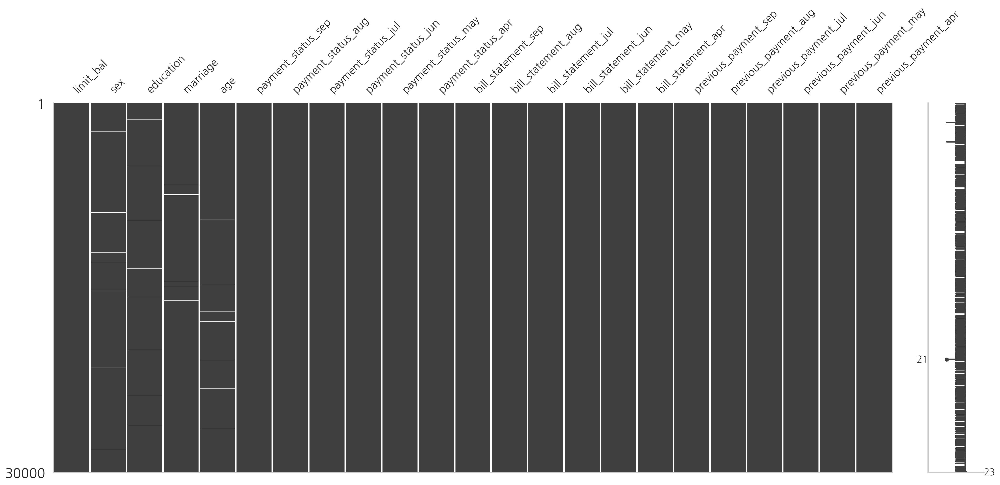

In [16]:
msno.matrix(X)

sns.despine()
# plt.savefig("images/figure_13_12", dpi=200)

**그림 13.15: 대출 연체 데이터셋의 nullity 행렬 플롯**

- 컬럼에 보이는 흰색 막대는 결측값을 나타냅니다. 결측값이 몇 개만 있는 큰 데이터셋을 다룰 때, 이 흰색 막대는 찾기 어려울 수 있다는 점을 기억해야 합니다. 
- 플롯 오른쪽에 있는 선은 데이터 완전성의 형태를 설명합니다. 두 숫자는 데이터셋에서 최대와 최소 nullity 값을 나타냅니다. 관측값에 결측값이 없을 경우, 선은 가장 오른쪽 위치에 있으며, 데이터셋의 열 개수와 동일한 값(이 경우 23)을 가집니다. 관측값 내 결측값 수가 증가하기 시작하면, 선은 왼쪽으로 이동합니다. nullity 값이 21이라는 것은 이 데이터셋에서 최대값이 23(열 개수)이므로, 해당 행에 결측값이 2개 있음을 의미합니다.

4. Define columns with missing values per data type:

**4단계**에서는 대체할 피처를 데이터 유형별로 리스트로 정의합니다. 이는 수치형 피처와 범주형 피처를 서로 다른 방식으로 대체하기 때문입니다. 기본적인 대체를 위해 scikit-learn의 `SimpleImputer` 클래스를 사용합니다.

In [20]:
NUM_FEATURES = ["age"]
CAT_FEATURES = ["sex", "education", "marriage"]

5. Impute the numerical feature:

**5단계**에서는 수치형 피처(이 경우 나이 피처)에 대해 반복 작업을 하며, 결측값을 중위값으로 대체합니다. 반복문 내에서 적절한 전략(`"median"`)을 가진 대체 객체를 정의하고, 학습 데이터의 해당 열에 적합하도록 설정한 후 학습 데이터와 테스트 데이터를 변환합니다. 이렇게 하면 잠재적인 데이터 누수를 방지하기 위해 학습 데이터만 사용하여 중위값을 추정하게 됩니다.

In [22]:
for col in NUM_FEATURES:
    num_imputer = SimpleImputer(strategy="median")
    num_imputer.fit(X_train[[col]])
    X_train.loc[:, col] = num_imputer.transform(X_train[[col]])
    X_test.loc[:, col] = num_imputer.transform(X_test[[col]])

>이 레시피에서는 결측값을 처리하기 위해 `scikit-learn`을 사용하지만, 수동으로도 처리할 수 있습니다. 이를 위해 결측값이 있는 각 열에 대해 학습 세트를 사용하여 필요한 통계(평균/중위값/최빈값)를 계산합니다. 예를 들어, `age_median = X_train.age.median()`을 계산한 후, 이 중위값을 `fillna` 메서드를 사용하여 학습 및 테스트 세트의 나이 열에서 결측값을 채우는 데 사용합니다.

In [70]:
# alternative method using pandas

# for feature in NUM_FEATURES:
#     median_value = X_train[feature].median()
#     X_train.loc[:, feature].fillna(median_value, inplace=True)
#     X_test.loc[:, feature].fillna(median_value, inplace=True)

6. Impute the categorical features:

**6단계**는 **5단계**와 유사하며, 범주형 열을 반복하는 데 같은 접근 방식을 사용합니다. 차이점은 선택한 전략에 있습니다. 지정된 열에서 가장 자주 등장하는 값(`"most_frequent"`)을 사용합니다. 이 전략은 범주형 및 수치형 피처에 모두 사용할 수 있으며, 후자의 경우 최빈값에 해당합니다.

In [23]:
for col in CAT_FEATURES:
    cat_imputer = SimpleImputer(strategy="most_frequent")
    cat_imputer.fit(X_train[[col]])
    X_train.loc[:, col] = cat_imputer.transform(X_train[[col]])
    X_test.loc[:, col] = cat_imputer.transform(X_test[[col]])

In [24]:
# alternative method using pandas

# for feature in CAT_FEATURES:
#     mode_value = X_train[feature].mode().values[0]
#     X_train.loc[:, feature].fillna(mode_value, inplace=True)
#     X_test.loc[:, feature].fillna(mode_value, inplace=True)

7. Verify that there are no missing values:

In [25]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 20999 entries, 25553 to 27126
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   limit_bal             20999 non-null  int64  
 1   sex                   20999 non-null  object 
 2   education             20999 non-null  object 
 3   marriage              20999 non-null  object 
 4   age                   20999 non-null  float64
 5   payment_status_sep    20999 non-null  object 
 6   payment_status_aug    20999 non-null  object 
 7   payment_status_jul    20999 non-null  object 
 8   payment_status_jun    20999 non-null  object 
 9   payment_status_may    20999 non-null  object 
 10  payment_status_apr    20999 non-null  object 
 11  bill_statement_sep    20999 non-null  int64  
 12  bill_statement_aug    20999 non-null  int64  
 13  bill_statement_jul    20999 non-null  int64  
 14  bill_statement_jun    20999 non-null  int64  
 15  bill_statement_may  

### There's more

결측값 처리를 다룰 때 언급할 가치가 있는 몇 가지 사항이 있습니다.

**missingno 라이브러리에서 제공하는 추가 시각화 기능**

이 레시피에서는 데이터셋의 결측값 행렬(nullity matrix) 표현을 이미 다루었지만, missingno 라이브러리는 몇 가지 더 유용한 시각화 기능을 제공합니다:

- `msno.bar` – 각 열의 nullity를 나타내는 막대 그래프를 생성합니다. nullity 행렬보다 빠르게 해석할 수 있어 편리합니다.
- `msno.heatmap` – nullity 상관관계를 시각화합니다. 한 피처의 존재/부재가 다른 피처의 존재에 얼마나 영향을 미치는지를 보여줍니다. nullity 상관관계의 해석은 일반적인 피어슨 상관계수 해석과 유사합니다. 값은 -1에서 1 사이이며, -1은 하나의 피처가 결측일 때 다른 피처가 결측이 아닌 경우(또는 그 반대)로 나타내고, 1은 한 피처가 결측일 때 다른 피처도 반드시 결측임을 나타냅니다.
- `msno.dendrogram` – 변수 간 상관 관계를 더 잘 이해할 수 있도록 합니다. 내부적으로 계층적 클러스터링을 사용하여 nullity 상관 관계를 기준으로 피처들을 서로 묶어 시각화합니다.

We also look into the other types of visualizations offered by `missingno`.

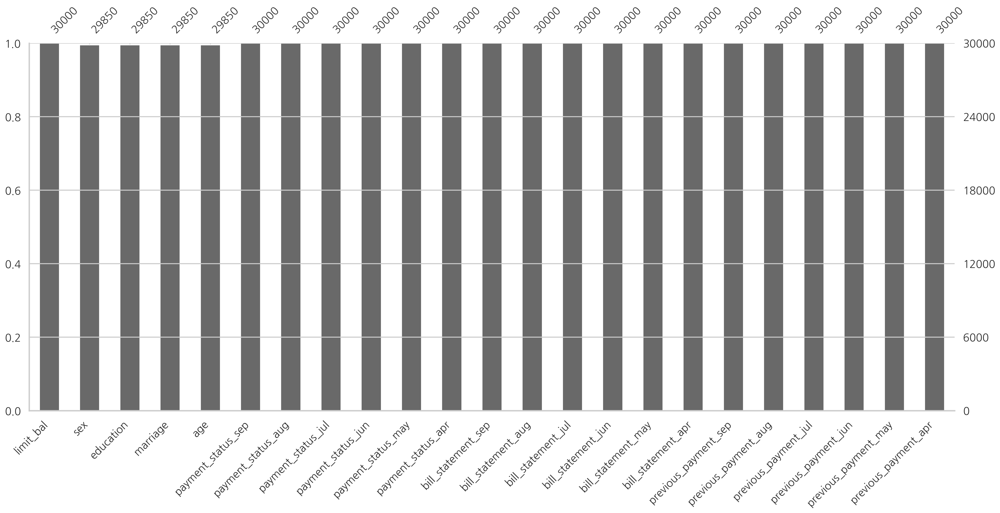

In [26]:
msno.bar(X)

sns.despine()
plt.show()

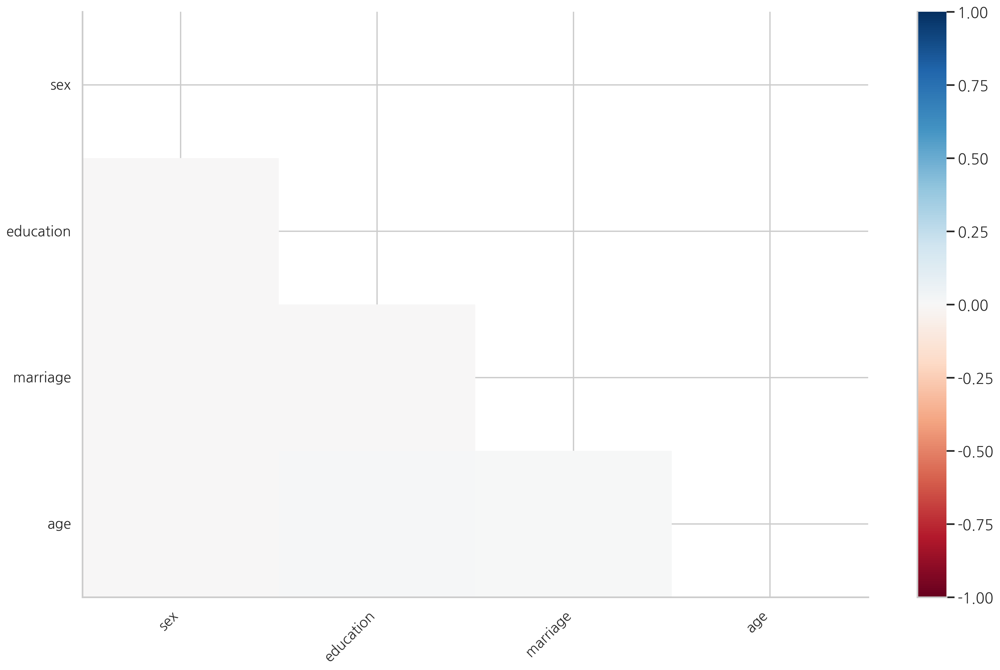

In [27]:
msno.heatmap(X)

sns.despine()
plt.show()

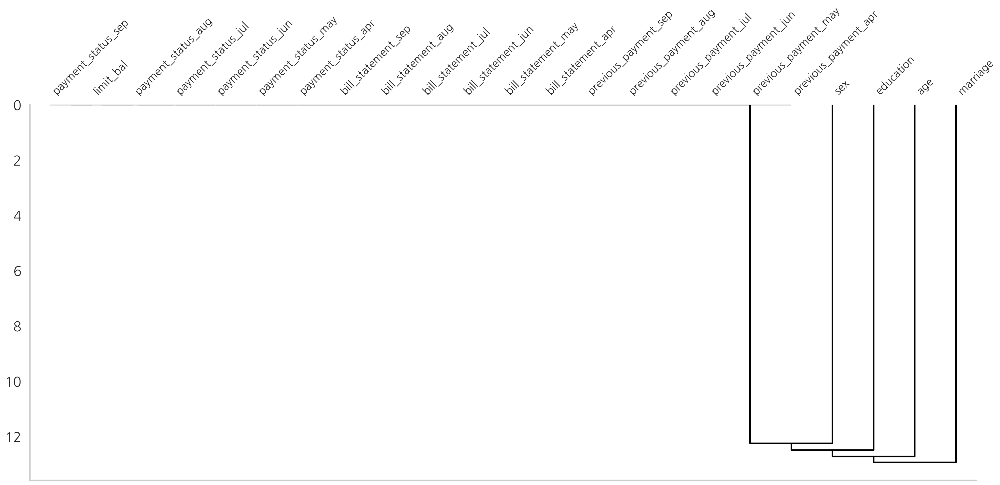

In [28]:
msno.dendrogram(X)

sns.despine()
# plt.savefig("images/figure_13_13", dpi=200)

그림 13.16: 결측치 덴드로그램 예시

이 그림을 해석하기 위해서는 위에서 아래로 분석해야 합니다. 먼저 거리가 0인 클러스터 잎사귀들을 살펴봐야 합니다. 이들은 서로의 존재를 완벽하게 예측합니다. 즉, 한 특성이 있을 때 다른 특성이 항상 없거나, 둘 다 항상 있거나 없는 등의 관계를 의미합니다. 0에 가까운 분할을 가진 클러스터 잎사귀들은 서로를 매우 잘 예측합니다. 우리의 경우, 덴드로그램은 모든 관측치에 존재하는 특성들을 연결합니다. 우리가 의도적으로 4개의 특성에만 결측치를 도입했기 때문에 이것은 확실합니다.


**결측값 대체를 위한 머신러닝 기반 접근법**

이 레시피에서는 결측값을 대체하는 방법을 설명합니다. 평균/중위값/최빈값 등으로 결측값을 대체하는 방식은 단일 대체 방식(single imputation)이라고 합니다. 이 방식은 특정한 값으로만 결측값을 대체합니다. 반면에, 다중 대체 방식(multiple imputation)도 있으며, 그 중 하나가 **체인 방정식을 사용한 다중 대체(MICE)** 입니다.

간단히 말해서, 이 알고리즘은 여러 회귀 모델을 이용해 결측값을 대체하며, 각 결측값은 결측이 아닌 데이터 포인트를 기반으로 조건부로 결정됩니다. 머신러닝 기반 대체의 장점은 단일 대체에서 발생하는 편향을 줄이는 것입니다. MICE 알고리즘은 scikit-learn의 `IterativeImputer`에서 사용할 수 있습니다.

또는, `scikit-learn`의 `KNNImputer`로 구현된 최근접 이웃 대체 방법을 사용할 수 있습니다. KNN 대체 방법의 기본 가정은 결측값이 있는 피처의 값이 가장 가까운 이웃의 관측값을 통해 근사될 수 있다는 것입니다. 다른 관측값과의 근접성은 다른 피처와 특정 거리 척도(예: 유클리드 거리)를 사용해 결정됩니다.

이 알고리즘은 K-최근접 이웃(KNN)을 사용하기 때문에 몇 가지 단점이 있습니다:

- 최적의 성능을 위해 하이퍼파라미터 튜닝이 필요합니다.
- 데이터를 스케일링하고 범주형 피처를 전처리해야 합니다.
- 거리 척도를 선택해야 하며, 특히 범주형 및 수치형 피처가 섞인 경우에는 더욱 중요합니다.
- 이상치와 소음에 민감합니다.
- 모든 관측값 쌍 사이의 거리를 계산해야 하므로 계산 비용이 큽니다.

다른 머신러닝 기반 대체 알고리즘으로는 `MissForest`(missingpy 라이브러리에서 사용 가능)가 있습니다. 자세한 설명 없이 간단히 말하자면, 이 알고리즘은 결측값을 중위값 또는 최빈값 대체로 시작한 후, 해당 결측 피처를 예측하기 위해 랜덤 포레스트 모델을 학습시킵니다. 다음으로, 결측 피처의 관측값에 대해 예측을 수행합니다. 이 프로세스는 각 반복에서 이전 예측을 개선하여 반복됩니다. 알고리즘은 특정 조건이 충족되거나 허용된 반복 수에 도달하면 중단됩니다.

MissForest는 결측값을 대체하는 데 사용하는 머신러닝 기반 알고리즘입니다. 이 알고리즘은 랜덤 포레스트(Random Forest)를 사용하여 결측값을 예측하는 방식으로 작동합니다. 더 쉽게 설명하자면, MissForest는 결측값이 있는 데이터에 대해 예측을 반복적으로 수행하면서 점점 더 정확한 대체 값을 찾아가는 과정입니다.

**MissForest 알고리즘의 작동 방식:**
- **초기값 대체**: 우선, 결측값이 있는 각 피처(열)에 대해 중위값이나 최빈값 등 간단한 값으로 임시로 채웁니다. 이 값들은 초기 추정치 역할을 합니다.
- **모델 학습**: 랜덤 포레스트 모델을 사용하여 결측값이 있는 피처를 예측합니다. 예를 들어, 나이 피처에 결측값이 있다면, 나이를 예측하기 위해 다른 피처(예: 성별, 소득 등)를 사용하여 모델을 학습합니다.
- **예측 및 대체**: 학습된 랜덤 포레스트 모델을 사용해 결측값을 예측합니다. 예측된 값을 사용하여 초기값을 대체합니다.
- **반복적 개선**: 이렇게 예측된 값이 다시 피처에 채워진 상태에서 다른 결측값을 예측합니다. 이 과정을 반복하면서 점점 더 정확한 대체 값을 찾습니다.
- **중단 조건**: 알고리즘은 특정 조건(예: 이전 반복과의 차이가 거의 없을 때)에서 반복을 중단합니다. 이렇게 하면 대체된 값들이 최적에 가깝게 수렴하게 됩니다.

**MissForest의 장점**:
- 수치형 및 범주형 피처의 결측값을 모두 처리할 수 있습니다.
- 스케일링과 같은 추가 전처리가 필요하지 않습니다.
- 소음이 많은 데이터에서도 강력한 성능을 보이며, 쓸모없는 피처의 영향을 거의 받지 않습니다.
- 비모수적이며, 피처 간의 선형 관계를 가정하지 않습니다(MICE는 선형 관계 가정을 요구함).
- 피처 간의 상호 작용을 활용하여 대체 성능을 향상시킵니다.

**MissForest의 단점**:
- 결측값, 피처 수, 결측값이 있는 피처 수가 많을수록 처리 시간이 늘어납니다.
- 랜덤 포레스트는 메모리를 많이 사용하며, 특히 대규모 데이터셋에서는 비효율적일 수 있습니다.
- 예측 모델이 완전히 통제 불가능하여 대체 시 예기치 않은 편향이 발생할 수 있습니다.

### See also

추가 자료는 다음에서 확인할 수 있습니다:

- Azur, M. J., Stuart, E. A., Frangakis, C., & Leaf, P. J. (2011). “체인 방정식을 통한 다중 대체: 그것이 무엇이며 어떻게 작동하는가?” *International Journal of Methods in Psychiatric Research*, 20(1), 40-49. [링크](https://doi.org/10.1002/mpr.329).
- Buck, S. F. (1960). “전자 컴퓨터 사용에 적합한 다변량 데이터의 결측값 추정 방법.” *Journal of the Royal Statistical Society: Series B (Methodological)*, 22(2), 302-306. [링크](https://www.jstor.org/stable/2984099).
- Stekhoven, D. J. & Bühlmann, P. (2012). “MissForest—혼합형 데이터에 대한 비모수 결측값 대체.” *Bioinformatics*, 28(1), 112-118.
- van Buuren, S. & Groothuis-Oudshoorn, K. (2011). “MICE: R에서의 체인 방정식을 통한 다변량 대체.” *Journal of Statistical Software* 45(3): 1-67.
- Van Buuren, S. (2018). *Flexible Imputation of Missing Data*. CRC 출판사.

- **miceforest** — LightGBM을 사용한 빠르고 메모리 효율적인 MICE용 Python 라이브러리.
- **missingpy** — MissForest 알고리즘의 구현을 포함하는 Python 라이브러리.

## 13.5 Encoding categorical variables

**범주형 변수 인코딩**

이전 레시피에서 일부 피처가 범주형 변수(원래는 `object` 또는 `category` 데이터 유형으로 표시됨)임을 확인했습니다. 하지만 대부분의 머신러닝 알고리즘은 숫자형 데이터만을 다룹니다. 따라서 범주형 피처를 ML 모델과 호환되는 표현으로 인코딩해야 합니다.

범주형 피처를 인코딩하는 첫 번째 방법은 **레이블 인코딩**입니다. 이 방법에서는 각 범주형 값에 고유한 숫자 값을 할당합니다. 예를 들어, 세 가지 별개의 범주가 있을 때는 다음과 같은 표현을 사용할 수 있습니다: `[0, 1, 2]`.

> 이 방법은 pandas에서 `category` 데이터 유형으로 변환하는 결과와 매우 유사합니다. 예를 들어, `df_cat`이라는 데이터프레임에 `feature_1`이라는 피처가 있다고 가정합니다. 이 피처는 `category` 데이터 유형으로 인코딩됩니다. 이 경우, `df_cat["feature_1"].cat.codes`를 실행하여 범주 코드에 접근할 수 있습니다. `dict(zip(df_cat["feature_1"].cat.codes, df_cat["feature_1"]))`을 실행하여 매핑을 복원할 수도 있습니다. `pd.factorize` 함수를 사용하여 유사한 표현에 도달할 수 있습니다.

레이블 인코딩의 잠재적 문제는 범주 간 관계를 도입하는 것입니다. 세 가지 범주 예시에서 관계는 다음과 같이 나타납니다: `0 < 1 < 2`. 범주가 국가와 같은 경우, 이러한 순서는 의미가 없습니다. 그러나 이 방법은 서열형 변수(예: Bad-Neutral-Good과 같은 서비스 평점)와 같은 순서가 있는 피처에는 유용할 수 있습니다.

이 문제를 극복하기 위해, **원-핫 인코딩**을 사용할 수 있습니다. 이 방법에서는 피처의 각 범주에 대해 이진 변수를 사용하여 새로운 열(더미 변수라고도 함)을 생성합니다. 그러나 이 방법의 단점은 데이터셋의 차원을 크게 증가시켜서 **차원의 저주**를 일으킬 수 있다는 것입니다. 첫째, 이는 오버피팅의 위험을 증가시키며, 특히 데이터셋에 관측값이 적을 때 문제가 됩니다. 둘째, 고차원 데이터셋은 거리 기반 알고리즘(예: K-최근접 이웃)에서 문제가 될 수 있습니다. 매우 높은 차원에서는 모든 관측값이 거의 같은 거리에 위치하게 되어 거리 기반 모델이 무용지물이 될 수 있습니다.

> 주의할 점은 더미 변수를 생성할 때 데이터셋에 중복이 생긴다는 것입니다. 예를 들어, 피처에 세 가지 범주가 있는 경우, 이를 완전히 표현하기 위해 두 개의 더미 변수만 필요합니다. 특정 범주에 속하지 않는 관측값이 두 개 중 어느 것에도 해당되지 않으면 세 번째 범주에 속하게 됩니다. 이를 **더미 변수 함정**이라고 하며, 이를 방지하기 위해 항상 한 열(참조 값으로 알려짐)을 제거하는 것이 좋습니다. 특히 정규화되지 않은 선형 모델에서는 더욱 중요합니다.

정리하자면, 레이블 인코딩은 데이터에 잘못된 순서를 도입할 수 있으며, 이는 잘못된 결론으로 이어질 수 있습니다. 트리 기반 방법(의사결정 트리, 랜덤 포레스트 등)은 범주형 데이터와 레이블 인코딩을 처리할 수 있습니다. 하지만 원-핫 인코딩은 피처 간 거리 메트릭을 계산하는 모델(예: K-평균 클러스터링, K-최근접 이웃)이나 **인공신경망(ANN)** 같은 알고리즘에는 자연스러운 표현 방식입니다.

### How to do it...

1. Import the libraries:

먼저, 필요한 라이브러리를 가져옵니다.

In [40]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.compose import ColumnTransformer

2. Use Label Encoder to encode a selected column:

두 번째 단계에서는 레이블 인코딩으로 인코딩하려는 열을 선택하고, `LabelEncoder`를 인스턴스화하여 학습 데이터에 적합하게 설정한 후 학습 및 테스트 데이터 모두에 적용합니다. 레이블 인코딩을 유지하고 싶지 않기 때문에 데이터프레임의 복사본에서 작업합니다.

> 레이블 인코딩은 사용 가능한 옵션 중 하나로서 소개하지만, 꽤 심각한 단점이 있습니다. 따라서 실무에서는 이 방법을 피하는 것이 좋습니다. 추가로, scikit-learn의 문서에서는 다음과 같은 경고가 있습니다: **이 변환기는 입력 X가 아니라 타겟 값, 즉 y를 인코딩하는 데 사용해야 합니다.**

In [41]:
COL = "education"

X_train_copy = X_train.copy()
X_test_copy = X_test.copy()

label_enc = LabelEncoder()
label_enc.fit(X_train_copy[COL])
X_train_copy.loc[:, COL] = label_enc.transform(X_train_copy[COL])
X_test_copy.loc[:, COL] = label_enc.transform(X_test_copy[COL])

X_test_copy[COL].head()

24775    3
9945     0
6150     1
25097    1
7745     3
Name: education, dtype: object

In [42]:
label_enc.classes_

array(['Graduate school', 'High school', 'Others', 'University'],
      dtype=object)

3. Select categorical features for one-hot encoding:

**3단계**에서는 `select_dtypes` 메서드를 사용하여 모든 `object` 데이터 유형의 피처를 선택하여 범주형 피처 목록을 생성하면서 원-핫 인코딩 준비를 시작합니다.

In [32]:
cat_features = X_train.select_dtypes(include="object") \
                      .columns \
                      .to_list()

cat_features

['sex',
 'education',
 'marriage',
 'payment_status_sep',
 'payment_status_aug',
 'payment_status_jul',
 'payment_status_jun',
 'payment_status_may',
 'payment_status_apr']

4. Instantiate the `OneHotEncoder` object: 

**4단계**에서는 `OneHotEncoder` 인스턴스를 생성합니다. 희소 행렬(0이 매우 많은 특수 데이터 유형)로 작업하고 싶지 않기 때문에, 각 피처에서 첫 번째 열을 삭제하여 더미 변수 함정을 피하고, 인코더가 변환 중에 알려지지 않은 값을 찾을 때 어떻게 처리할지(`handle_unknown="error"`) 지정합니다.

In [43]:
# one_hot_encoder = OneHotEncoder(sparse=False, 
#                                 handle_unknown="error", 
#                                 drop="first")

one_hot_encoder = OneHotEncoder(sparse_output=False, 
                               handle_unknown="error", 
                               drop="first")

5. Create the column transformer using the one-hot encoder: 

**5단계**에서는 `ColumnTransformer`를 정의합니다. 이는 동일한 변환(이 경우 원-핫 인코더)을 여러 열에 적용하는 데 유용합니다. 각 단계는 이름("one_hot"), 적용할 변환, 변환할 피처의 세 가지로 구성된 튜플로 정의합니다.

`ColumnTransformer`를 생성할 때, `remainder="passthrough"`라는 추가 인수를 지정하여 지정된 열만 변환하고 나머지는 그대로 남겨 둡니다. `remainder` 인수의 기본값은 "drop"이어서 사용되지 않은 열을 삭제합니다. 또한, `verbose_feature_names_out` 인수를 `False`로 설정하여 `get_feature_names_out` 메서드를 사용할 때 피처 이름 앞에 변환기 이름이 붙지 않도록 합니다. 만약 변경하지 않으면, 일부 피처에는 "one_hot_" 접두사가 붙고, 다른 피처에는 "remainder_" 접두사가 붙게 됩니다.


In [34]:
one_hot_transformer = ColumnTransformer(
    [("one_hot", one_hot_encoder, cat_features)],
    remainder="passthrough",
    verbose_feature_names_out=False
)

6. Fit the transformer:

**6단계**에서는 `fit` 메서드를 사용하여 학습 데이터에 컬럼 변환기를 적합하게 설정합니다.

In [35]:
one_hot_transformer.fit(X_train)

ColumnTransformer(remainder='passthrough',
                  transformers=[('one_hot',
                                 OneHotEncoder(drop='first',
                                               sparse_output=False),
                                 ['sex', 'education', 'marriage',
                                  'payment_status_sep', 'payment_status_aug',
                                  'payment_status_jul', 'payment_status_jun',
                                  'payment_status_may',
                                  'payment_status_apr'])],
                  verbose_feature_names_out=False)

Figure 13.17: Preview of the column transformer with one-hot encoding

7. Apply the transformations to both training and test sets:

마지막으로, `transform` 메서드를 사용하여 학습 및 테스트 세트 모두에 변환을 적용합니다. `transform` 메서드는 `numpy` 배열을 반환하기 때문에, 변환된 피처의 이름과 새로운 열 이름, 원래 인덱스를 사용하여 이를 다시 `pandas` 데이터프레임으로 변환합니다.

> 결측값 처리나 이상값 탐지와 유사하게, 모든 변환기(원-핫 인코딩 포함)를 학습 데이터에만 적합하게 설정한 후, 이를 학습 및 테스트 세트 모두에 적용합니다. 이렇게 하면 데이터 누수를 방지할 수 있습니다.

In [36]:
col_names = one_hot_transformer.get_feature_names_out()

X_train_ohe = pd.DataFrame(one_hot_transformer.transform(X_train), 
                           columns=col_names, 
                           index=X_train.index)

X_test_ohe = pd.DataFrame(one_hot_transformer.transform(X_test), 
                          columns=col_names, 
                          index=X_test.index)

Below we can see how one-hot encoding increased the shape of our DataFrame:

In [37]:
X_train.shape

(20999, 23)

In [38]:
X_train_ohe.shape

(20999, 72)

In [52]:
X_train_ohe.to_csv("./datasets/X_train_ohe.csv", index=True)
X_test_ohe.to_csv("./datasets/X_test_ohe.csv", index=True)
y_train.to_csv("./datasets/y_train.csv", index=True)
y_test.to_csv("./datasets/y_test.csv", index=True)

### There's more

범주형 변수 인코딩과 관련하여 몇 가지 추가 사항을 언급하고자 합니다.

#### pandas를 사용한 원-핫 인코딩

scikit-learn 대신, `pd.get_dummies`를 사용하여 범주형 피처에 대해 원-핫 인코딩을 수행할 수 있습니다. 예제 구문은 다음과 같습니다:

In [89]:
pd.get_dummies(X_train, prefix_sep="_", drop_first=True)

,limit_bal,age,bill_statement_sep,bill_statement_aug,bill_statement_jul,bill_statement_jun,bill_statement_may,bill_statement_apr,previous_payment_sep,previous_payment_aug,...,payment_status_may_Payment delayed 8 months,payment_status_may_Unknown,payment_status_apr_Payment delayed 2 months,payment_status_apr_Payment delayed 3 months,payment_status_apr_Payment delayed 4 months,payment_status_apr_Payment delayed 5 months,payment_status_apr_Payment delayed 6 months,payment_status_apr_Payment delayed 7 months,payment_status_apr_Payment delayed 8 months,payment_status_apr_Unknown
25553,320000,37.0,202442,187475,164694,148160,132230,121191,8211,6100,...,False,True,False,False,False,False,False,False,False,True
14463,500000,35.0,1369,6138,20424,7840,846,790,4769,19629,...,False,True,False,False,False,False,False,False,False,False
27267,160000,42.0,14137,13613,14634,16532,15969,17701,0,1247,...,False,False,True,False,False,False,False,False,False,False
18620,20000,26.0,1000,8930,0,0,0,790,8930,0,...,False,True,False,False,False,False,False,False,False,True
12238,20000,22.0,11999,3617,4165,6323,0,0,1062,1000,...,False,False,False,False,False,False,False,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25780,200000,32.0,10701,0,0,0,0,0,0,0,...,False,True,False,False,False,False,False,False,False,True
13921,120000,24.0,112336,113351,115515,113948,122127,121962,4200,4100,...,False,True,True,False,False,False,False,False,False,False
3794,120000,24.0,75796,76004,67187,49924,33188,19826,3700,2023,...,False,True,False,False,False,False,False,False,False,True
27565,360000,57.0,0,0,860,246,-46,-46,0,860,...,False,False,False,False,False,False,False,False,False,True


이 대체 방법을 알아두면 유용합니다. 특히, 빠른 개념 증명(Proof of Concept, PoC)을 만들 때 작업하기 더 쉬울 수 있습니다(컬럼 이름이 자동으로 처리되기 때문에). 그러나 코드를 프로덕션 환경에서 사용할 때는 scikit-learn 변형을 사용하고 파이프라인 내에서 더미 변수를 생성하는 것이 더 좋은 접근 방식입니다.

#### OneHotEncoder에 가능한 범주 지정하기

`ColumnTransformer`를 생성할 때, 고려된 피처에 대해 가능한 범주 목록을 추가로 제공할 수도 있습니다. 간단한 예는 다음과 같습니다:


In [44]:
# 성별 데이터에 대한 원-핫 인코딩을 수행하는 인코더 생성
# categories: 가능한 모든 범주값을 명시적으로 지정
# sparse_output=False: 밀집 행렬(dense matrix) 형태로 출력
# handle_unknown="error": 학습 데이터에 없는 범주값이 들어오면 에러 발생
# drop="first": 첫번째 범주를 기준범주로 삭제하여 다중공선성 방지
one_hot_encoder = OneHotEncoder(
    categories=[["Male", "Female", "Unknown"]], 
    sparse_output=False,  
    handle_unknown="error", 
    drop="first"
)

# ColumnTransformer를 사용하여 특정 컬럼("sex")에만 원-핫 인코딩 적용
# one_hot: 변환기 이름
# one_hot_encoder: 사용할 변환기 
# ["sex"]: 변환할 컬럼명
one_hot_transformer = ColumnTransformer(
    [("one_hot", one_hot_encoder, ["sex"])]
)

# 학습 데이터로 원-핫 인코더 학습
one_hot_transformer.fit(X_train)

# 생성된 더미변수의 컬럼명 확인
one_hot_transformer.get_feature_names_out()

array(['one_hot__sex_Female', 'one_hot__sex_Unknown'], dtype=object)

각 피처에 대해 가능한 범주를 지정하는 목록(또는 목록의 목록)을 전달하면, 특정 값이 학습 세트에 나타나지 않을 가능성을 고려하게 됩니다. 그러나 이러한 값은 테스트 세트나 프로덕션 환경의 새로운 관측값에서 나타날 수 있습니다. 이런 경우 오류가 발생할 수 있습니다.

위 코드 블록에서는 성별을 나타내는 열에 "Unknown"이라는 추가 범주를 추가했습니다. 그 결과, 이 범주에 대한 추가 "더미" 열이 생깁니다. 남성 범주는 참조 항목으로 제거됩니다.

#### Category Encoders 라이브러리

pandas와 scikit-learn을 사용하는 것 외에도, **Category Encoders**라는 또 다른 라이브러리를 사용할 수 있습니다. 이 라이브러리는 scikit-learn과 호환되는 라이브러리 세트에 속하며, fit-transform 접근 방식을 사용하는 다양한 인코더를 제공합니다. 따라서 **ColumnTransformer** 및 **Pipeline**과 함께 사용할 수 있습니다.

다음은 원-핫 인코더의 대체 구현 예시입니다.

라이브러리를 가져옵니다:

In [47]:
import category_encoders as ce

인코더 객체를 생성합니다:

In [48]:
one_hot_encoder_ce = ce.OneHotEncoder(use_cat_names=True)

또한, `drop_invariant`이라는 인수를 지정하여 분산이 없는 열(예: 하나의 고유 값만 있는 열)을 삭제할 수 있습니다. 이는 피처의 수를 줄이는 데 도움이 됩니다.

인코더를 적합하게 설정하고 데이터를 변환합니다:

In [49]:
# category_encoders 라이브러리의 원-핫 인코더를 학습 데이터에 맞춥니다
one_hot_encoder_ce.fit(X_train)

# 학습된 인코더를 사용하여 학습 데이터를 변환합니다
# 원-핫 인코딩된 새로운 데이터프레임이 생성됩니다
X_train_ce = one_hot_encoder_ce.transform(X_train)

# 변환된 데이터의 처음 5행을 출력하여 결과를 확인합니다
X_train_ce.head()

,limit_bal,sex_Female,sex_Male,education_University,education_Graduate school,education_High school,education_Others,marriage_Married,marriage_Single,marriage_Others,...,bill_statement_jul,bill_statement_jun,bill_statement_may,bill_statement_apr,previous_payment_sep,previous_payment_aug,previous_payment_jul,previous_payment_jun,previous_payment_may,previous_payment_apr
25553,320000,1,0,1,0,0,0,1,0,0,...,164694,148160,132230,121191,8211,6100,6094,5035,4446,5028
14463,500000,0,1,0,1,0,0,0,1,0,...,20424,7840,846,790,4769,19629,157,0,790,860
27267,160000,0,1,0,1,0,0,1,0,0,...,14634,16532,15969,17701,0,1247,2145,0,2000,0
18620,20000,1,0,0,1,0,0,0,1,0,...,0,0,0,790,8930,0,0,0,790,0
12238,20000,1,0,1,0,0,0,0,1,0,...,4165,6323,0,0,1062,1000,10488,0,0,0


이 원-핫 인코더 구현은 기본적으로 문자열이 포함된 열만 자동으로 인코딩합니다(필요시 `cols` 인수에 목록을 전달하여 특정 범주형 열의 하위 집합을 지정하지 않는 한). 기본적으로 `pandas` 데이터프레임을 반환하여, scikit-learn의 경우와 달리 조정된 열 이름을 가진 상태로 반환합니다. 이 구현의 유일한 단점은 각 피처의 중복된 더미 열을 삭제할 수 없다는 점입니다.

#### Accessing the `category` encoding

In [97]:
column_dtypes = {
    "education": "category", 
    "marriage": "category", 
    "sex": "category"
}
df_cat = pd.read_csv("./datasets/credit_card_default.csv", 
                     na_values="", dtype=column_dtypes)

In [98]:
df_cat["education"].cat.codes

0        3
1        3
2        3
3        3
4        3
        ..
29995    1
29996    1
29997    3
29998    1
29999    3
Length: 30000, dtype: int8

In [99]:
dict(zip(df_cat["education"].cat.codes, df_cat["education"]))

{3: 'University', 0: 'Graduate school', 1: 'High school', 2: 'Others', -1: nan}

#### 원-핫 인코딩과 의사결정 트리 기반 알고리즘에 대한 경고

1. **회귀 모델과 원-핫 인코딩**:
   - 회귀 기반 모델(예: 선형 회귀)은 원-핫 인코딩된 피처를 잘 처리합니다.
   - 원-핫 인코딩된 값은 특정 조건에 맞는지("이 범주에 속하는가?")를 나타내는데, 이는 회귀 모델에서 "OR 조건"을 처리하는 데 적합합니다.

2. **의사결정 트리와 원-핫 인코딩의 문제**:
   - 의사결정 트리 기반 모델(예: 의사결정 트리, 랜덤 포레스트)은 범주형 피처를 직접 다루는 데 능숙합니다.
   - 원-핫 인코딩을 사용하지 않아도 트리 구조를 통해 각 범주를 따로 처리할 수 있습니다.
   - 그러나 **scikit-learn**의 트리 기반 모델은 모든 피처가 **숫자형**이어야 하기 때문에, 범주형 변수를 원-핫 인코딩하여 숫자로 변환해야 합니다.

3. **왜 원-핫 인코딩이 트리 기반 모델에 적합하지 않을까?**:
   - 원-핫 인코딩으로 변환하면 각 범주가 별도의 열로 나누어지지만, 이는 트리 기반 모델이 범주형 변수의 전체 정보를 활용하는 데 방해가 될 수 있습니다.
   - 원-핫 인코딩된 열 하나하나는 특정 범주의 일부 정보만 전달하므로, 트리가 각 범주의 전체 정보를 포괄적으로 이해하기 어려워질 수 있습니다.
   - 특히, 많은 범주를 가진 변수를 원-핫 인코딩하면 열의 수가 급격히 증가하고, 모델이 복잡해질 뿐 아니라 계산 비용도 높아집니다.

4. **해결책**:
   - **다른 인코딩 방법 사용**: 원-핫 인코딩 대신 **레이블 인코딩**이나 **타겟 인코딩** 같은 방법을 사용할 수 있습니다. 이 방법들은 범주형 변수를 하나의 숫자 값으로 변환해 트리 모델이 더 효율적으로 사용할 수 있게 합니다.
   - **다른 구현 사용**: LightGBM이나 h2o 라이브러리의 랜덤 포레스트처럼 **범주형 피처를 직접 다룰 수 있는 모델**을 사용하면, 원-핫 인코딩 없이도 범주형 변수를 효과적으로 처리할 수 있습니다.

즉, 의사결정 트리 기반 모델에서 원-핫 인코딩은 데이터를 너무 세분화해 정보 손실을 초래할 수 있으며, 대신 다른 인코딩 방법이나 범주형 피처를 직접 처리할 수 있는 모델을 사용하는 것이 좋습니다.

## 13.6 Fitting a decision tree classifier

**의사결정 트리 분류기 학습**

의사결정 트리 분류기는 회귀와 분류 문제 모두에 사용되는 비교적 간단하지만 매우 중요한 머신러닝 알고리즘입니다. 이 알고리즘의 이름은 모델이 일련의 규칙을 설정하여(예: `if x_1 > 50 and x_2 < 10 then y = 'default'`) 이를 트리 형태로 시각화할 수 있기 때문에 붙여졌습니다. 의사결정 트리는 특정 값에서 피처를 반복적으로 분할하여 피처 공간을 여러 작은 영역으로 나눕니다. 이를 위해 **탐욕적 알고리즘(greedy algorithm)** 을 사용하여 자식 노드의 결합 불순도를 최소화하는 분할을 찾습니다. 분류 작업에서 불순도는 지니(Gini) 불순도나 엔트로피로 측정하며, 회귀 문제에서는 평균 제곱 오차(MSE)나 평균 절대 오차(MAE)를 사용합니다.

이진 분류 문제의 경우, 알고리즘은 한 클래스로 구성된 노드를 최대한 확보하여 불순도를 최소화하고자 합니다. 단말 노드(리프)에서 예측은 분류의 경우 가장 많이 나타나는 클래스(모드)를 기준으로, 회귀의 경우 평균을 기준으로 이루어집니다.

> 의사결정 트리는 랜덤 포레스트, 그래디언트 부스팅 트리, XGBoost, LightGBM, CatBoost 등의 복잡한 알고리즘의 기초가 됩니다.

**의사결정 트리의 장점**:
- 트리 형태로 쉽게 시각화 가능 - 해석이 용이함
- 학습 및 예측 단계가 빠름
- 튜닝해야 할 하이퍼파라미터의 수가 비교적 적음
- 수치형 및 범주형 피처를 지원함
- 데이터의 비선형성을 처리할 수 있음
- 피처 엔지니어링을 통해 성능 향상이 가능하지만 필수는 아님
- 스케일링 또는 정규화가 필요 없음
- 샘플을 분할할 피처를 선택함으로써 피처 선택 기능을 포함함
- 비모수 모델로서, 피처/타겟 분포에 대한 가정이 필요 없음

**의사결정 트리의 단점**:
- 불안정성 - 입력 데이터의 노이즈에 민감하여, 데이터의 작은 변화가 모델에 큰 영향을 미칠 수 있음
- 과적합 - 최대값 또는 중지 기준을 제공하지 않으면, 트리가 너무 깊어져 일반화가 어려워질 수 있음
- 외삽 불가 - 훈련 데이터의 경계를 벗어난 관측값에 대해 일정한 예측만 수행함
- 탐욕적 알고리즘이 전역 최적의 결정 트리 선택을 보장하지 않음
- 클래스 불균형이 있는 경우 편향된 결과를 초래할 수 있음
- 범주형 변수를 포함한 트리에서 정보 이득(엔트로피 감소)은 범주 수가 많은 피처에 대해 편향된 결과를 낳을 수 있음

### Getting ready

In [54]:
# 학습 및 테스트 데이터 불러오기
import pandas as pd

# 원-핫 인코딩된 특성 데이터 불러오기 
X_train_ohe = pd.read_csv("./datasets/X_train_ohe.csv", index_col=0)  # 학습용 특성 데이터
X_test_ohe = pd.read_csv("./datasets/X_test_ohe.csv", index_col=0)    # 테스트용 특성 데이터

# 타겟 변수(다음달 채무불이행 여부) 불러오기
y_train = pd.read_csv("./datasets/y_train.csv", index_col=0)["default_payment_next_month"]  # 학습용 타겟
y_test = pd.read_csv("./datasets/y_test.csv", index_col=0)["default_payment_next_month"]    # 테스트용 타겟

### How to do it...

1. Import the libraries:

In [61]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn import metrics
from chapter_13_utils import performance_evaluation_report

2. Create the instance of the model, fit it to the training data and create prediction:

**2단계**에서는 일반적인 scikit-learn 접근 방식을 사용하여 머신러닝 모델을 학습시킵니다. 먼저, `DecisionTreeClassifier` 클래스를 생성합니다(기본 설정과 고정된 랜덤 상태 사용). 그런 다음, `fit` 메서드를 사용해 모델을 학습 데이터에 적합시킵니다(특성과 타겟 모두를 전달해야 함). 마지막으로, `predict` 메서드를 사용하여 예측을 얻습니다.

> `predict` 메서드는 예측된 클래스 배열을 반환합니다(이 경우 0 또는 1). 하지만 특정 경우에는 각 클래스에 대한 확률이 필요할 수도 있습니다. 이를 얻기 위해 `predict_proba` 메서드를 사용할 수 있습니다. 이 메서드는 모든 가능한 클래스에 대한 확률 배열을 반환합니다(합이 1이 됨). 이진 분류에서 `predict` 메서드는 확률이 50% 이상인 경우 양성 클래스를 자동으로 할당합니다.

In [56]:
tree_classifier = DecisionTreeClassifier(random_state=42)
tree_classifier.fit(X_train_ohe, y_train)
y_pred = tree_classifier.predict(X_test_ohe)

3. Evaluate the results:

**3단계**에서는 모델 성능을 평가합니다. 성능 평가를 위해 혼동 행렬(confusion matrix)을 생성하고, 모든 결과를 표 형식으로 표시합니다. 이 함수는 scikit-learn의 `metrics` 모듈을 사용하여 내장되어 있습니다. 혼동 행렬은 예측된 값과 실제 타겟 값을 비교하여 가능한 모든 조합을 요약합니다. 가능한 값은 다음과 같습니다:

- **True Positive (TP)**: 모델이 연체를 예측했으며, 실제로 연체가 발생한 경우
- **False Positive (FP)**: 모델이 연체를 예측했지만, 실제로는 연체가 발생하지 않은 경우
- **True Negative (TN)**: 모델이 정상 고객을 예측했으며, 실제로도 연체가 발생하지 않은 경우
- **False Negative (FN)**: 모델이 정상 고객을 예측했지만, 실제로는 연체가 발생한 경우

이 예에서는 연체를 양성 클래스로 간주합니다. 이는 사건의 결과가 좋거나 나쁨을 의미하는 것이 아니라, 단순히 사건이 발생했음을 나타냅니다. 데이터 과학 프로젝트에서 대부분 "관심 없는" 클래스가 음성 클래스로 지정되는 경우가 많습니다.

제시된 값을 사용하여 여러 평가 기준을 추가로 계산할 수 있습니다:

- **정확도(Accuracy)**: (TP + TN) / (TP + TN + FP + FN) - 관측값의 클래스를 올바르게 예측할 모델의 전체 능력을 측정합니다.
- **정밀도(Precision)**: TP / (TP + FP) - 양성으로 예측된 모든 값 중 실제로 양성인 값의 비율을 측정합니다. 예를 들어, "모델이 연체를 예측할 때, 얼마나 자주 실제 연체가 발생합니까?"
- **재현율(Recall)**: TP / (TP + FN) - 실제 양성 값 중에서 얼마나 많은 양성을 정확히 예측했는지를 측정합니다. 민감도 또는 참 양성률이라고도 하며, "모든 관측된 연체 중에서 몇 퍼센트를 예측했습니까?"라는 질문에 답합니다.
- **F1 점수**: 정밀도와 재현율의 조화 평균을 사용합니다. 극단적인 값에 대한 페널티를 주며, 비슷하지 않은 값을 억제합니다. 예를 들어, 정밀도가 1이고 재현율이 0일 경우, F1 점수는 0이 됩니다.
- **특이도(Specificity)**: TN / (TN + FP) - 실제로 연체가 발생하지 않은 경우 중 모델이 이를 올바르게 예측한 비율을 측정합니다.

모델 성능 평가에서 이 평가 지표들의 미묘한 차이를 이해하는 것은 매우 중요합니다. 특히 **클래스 불균형**이 있는 경우 정확도는 모델 성능에 대해 오해를 줄 수 있습니다. 예를 들어, 데이터의 99%가 정상 고객이고 1%만이 연체 고객이라면, 단순히 모든 고객을 정상으로 예측하는 모델도 99%의 정확도를 얻습니다. 이런 경우, 우리는 다음과 같은 지표를 고려할 필요가 있습니다:

- 높은 정밀도를 달성하려면 FP를 줄여야 하며, 이는 스팸 감지와 같은 경우에 유용합니다.
- 높은 재현율을 달성하려면 FN을 줄여야 하며, 이는 사기 탐지와 같이 FN의 비용이 높은 경우에 유용합니다.

모든 경우에 최적의 평가 지표가 있는 것은 아닙니다. 최적화할 지표는 사용 사례에 따라 선택해야 합니다.

두 번째 기준은 **ROC(Receiver Operating Characteristic) 곡선**입니다. ROC 곡선은 다양한 확률 임계값에 대해 TPR과 FPR 간의 균형을 보여줍니다.

이상적인 분류기는 0의 거짓 양성률과 1의 참 양성률을 가집니다. 따라서 ROC 플롯에서 (0,1) 지점이 이상적인 지점입니다. 성능이 좋은 모델의 곡선은 이 지점에 최대한 가까워야 합니다. 반면, 아무런 능력이 없는 모델은 대각선(45도)에 가까운 선을 그립니다. ROC 곡선을 더 잘 이해하려면 다음을 고려해 보세요:

- 임계값을 0으로 설정한다고 가정하면, 모든 관측값이 기본적으로 연체로 분류됩니다. 이는 두 가지 결론을 낳습니다. 첫째, 실제 연체가 아닌 경우에 대한 참 양성률(재현율)이 1이 되어 모든 비연체 고객이 연체로 분류됩니다. 둘째, 거짓 양성률이 1이 되며 이는 ROC 곡선의 맨 오른쪽 상단에 해당합니다.
- 임계값을 1로 설정한다고 가정하면, 모든 관측값이 정상 고객으로 분류됩니다. 연체로 분류되는 경우가 없기 때문에 참 양성률(TPR)은 0이 되고 거짓 양성률(FPR)도 0이 됩니다. 이는 곡선의 왼쪽 하단에 해당합니다.

이와 같이, 곡선의 모든 점은 두 극단(0과 1) 사이의 임계값을 위한 분류기의 성능 점수를 나타냅니다. 이상적인 경우, 참 양성률이 1이고 거짓 양성률이 0인 지점에 가까워집니다. 즉, 연체가 아닌 고객이 정상 고객으로, 연체가 있는 고객이 연체로 정확히 분류됩니다.

- 성능이 대각선을 넘는 경우, 모델이 많은 비연체와 연체 고객을 연체로 분류하는 경향을 보입니다. 즉, 이는 무작위 추측과 거의 동일하게 작동하는 모델이 됩니다.

> 대각선 아래에 곡선이 위치한 모델도 가능하며, 이는 "무능력한 모델"보다 실제로 더 나을 수 있습니다. 이 경우, 예측을 단순히 반전하여 더 나은 성능을 얻을 수 있습니다.

모델 성능을 단일 숫자로 요약하려면 **ROC 곡선 아래 면적(AUC)** 을 볼 수 있습니다. AUC는 가능한 모든 임계값에서 모델 성능을 종합적으로 측정하며, 값은 0과 1 사이에서 나옵니다. AUC가 0이면 모델이 항상 틀리다는 것을 의미하고, 1이면 항상 옳다는 것을 의미합니다. AUC가 0.5이면 아무 능력이 없는 모델로, 무작위 추측과 같습니다.

AUC를 확률적 용어로 해석할 수 있습니다. 요약하면, 모델이 양성 클래스를 음성 클래스보다 높은 점수로 순위를 매기는 확률을 나타냅니다. 예를 들어, 75%의 AUC는 무작위 양성 예와 음성 예를 뽑았을 때 양성 예가 음성 예보다 오른쪽에 위치할 확률이 75%임을 의미합니다.

<img src="image/fig_13_21.PNG" alt="Model’s output ordered by predicted score/probability" width="800">

Figure 13.21: Model’s output ordered by predicted score/probability

>실제에서는 ROC 곡선을 사용하여 거짓 양성률과 거짓 음성률 사이의 균형을 적절히 맞출 수 있는 임계값을 선택합니다. 또한 AUC는 다양한 모델 간 성능 차이를 비교하는 데 유용합니다.

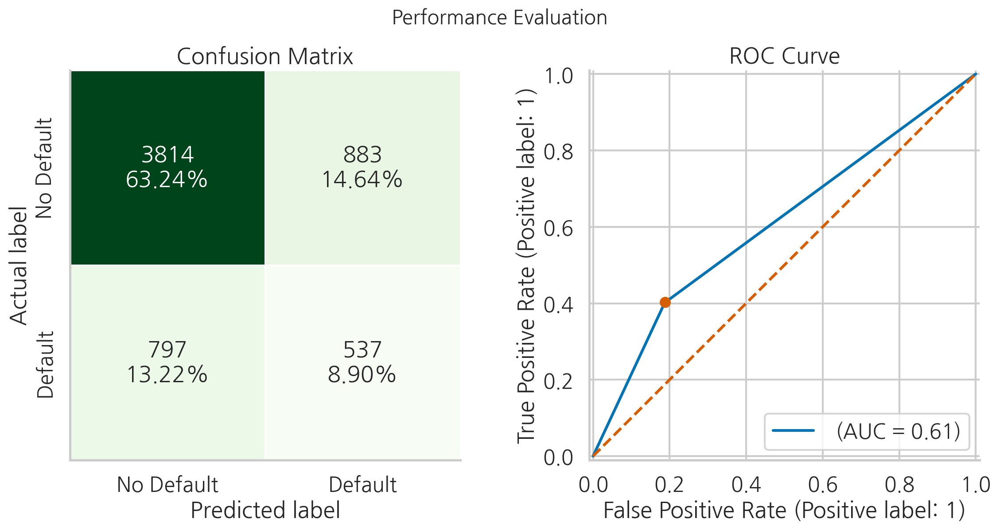

In [57]:
LABELS = ["No Default", "Default"]
tree_perf = performance_evaluation_report(tree_classifier, 
                                          X_test_ohe, 
                                          y_test, labels=LABELS, 
                                          show_plot=True)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_15", dpi=200)

그림 13.18: 학습된 의사결정 트리 분류기의 성능 평가 보고서

tree_perf 객체는 모델의 성능을 평가하는 데 도움이 되는 더 많은 관련 메트릭을 포함하는 딕셔너리입니다. 아래에서 이러한 메트릭을 보여드립니다:

In [104]:
tree_perf

{'accuracy': 0.7214392306416846,
 'precision': 0.37816901408450704,
 'recall': 0.4025487256371814,
 'specificity': 0.8120076644666808,
 'f1_score': 0.3899782135076253,
 'cohens_kappa': 0.20971632534408502,
 'matthews_corr_coeff': 0.20988814786286436,
 'roc_auc': 0.6071302490121769,
 'pr_auc': 0.4562496247182579,
 'average_precision': 0.2844892909582708}

4. Plot the first few levels of the fitted decision tree:

마지막 단계에서는 `plot_tree` 함수를 사용하여 의사결정 트리를 시각화합니다.

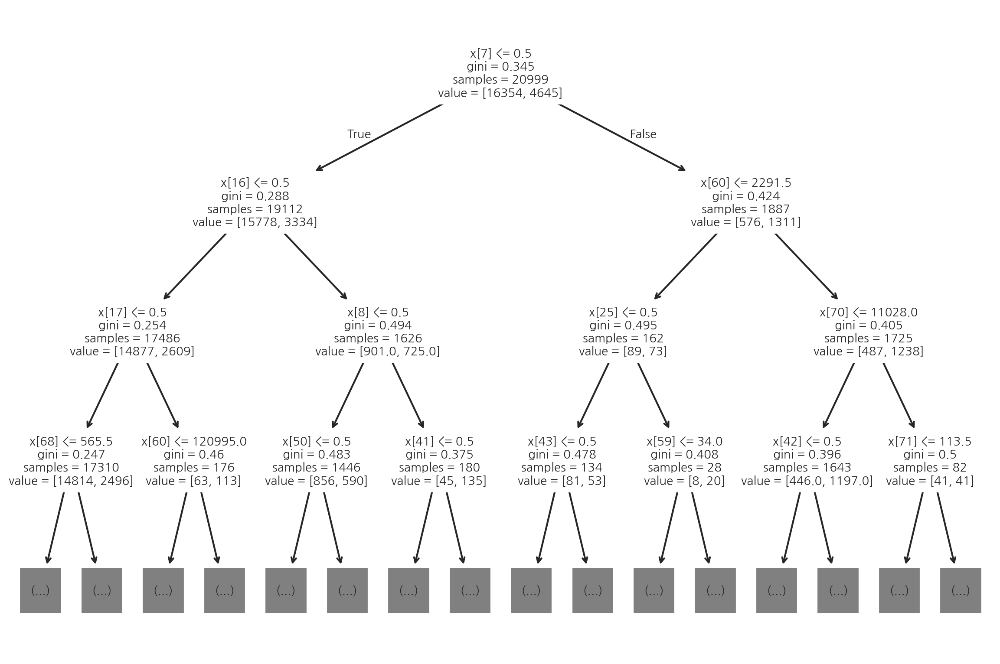

In [58]:
plot_tree(tree_classifier, max_depth=3, fontsize=10)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_16", dpi=200)

그림 13.19: 최대 깊이 3으로 제한된 학습된 의사결정 트리

간단한 명령어를 사용하여 이미 많은 정보를 시각화할 수 있습니다. 실제로 학습된 트리는 44단계의 깊이에 도달했기 때문에, 우리는 의사결정 트리의 상위 3단계만을 플롯하기로 결정했습니다. 언급한 것처럼, `max_depth` 하이퍼파라미터를 제한하지 않으면 이런 상황이 발생할 수 있으며, 이는 과적합 가능성도 매우 큽니다.

트리에서는 다음과 같은 정보를 볼 수 있습니다:

- 트리를 분할하는 데 사용된 피처와 해당 값. 안타깝게도 기본 설정으로는 피처 이름 대신 열 번호만 표시됩니다. 곧 이를 수정할 예정입니다.
- 지니 불순도 값.
- 각 노드/리프의 샘플 수.
- 각 노드/리프 내 각 클래스의 관측값 수.

In [62]:
tree_classifier.get_depth()

41

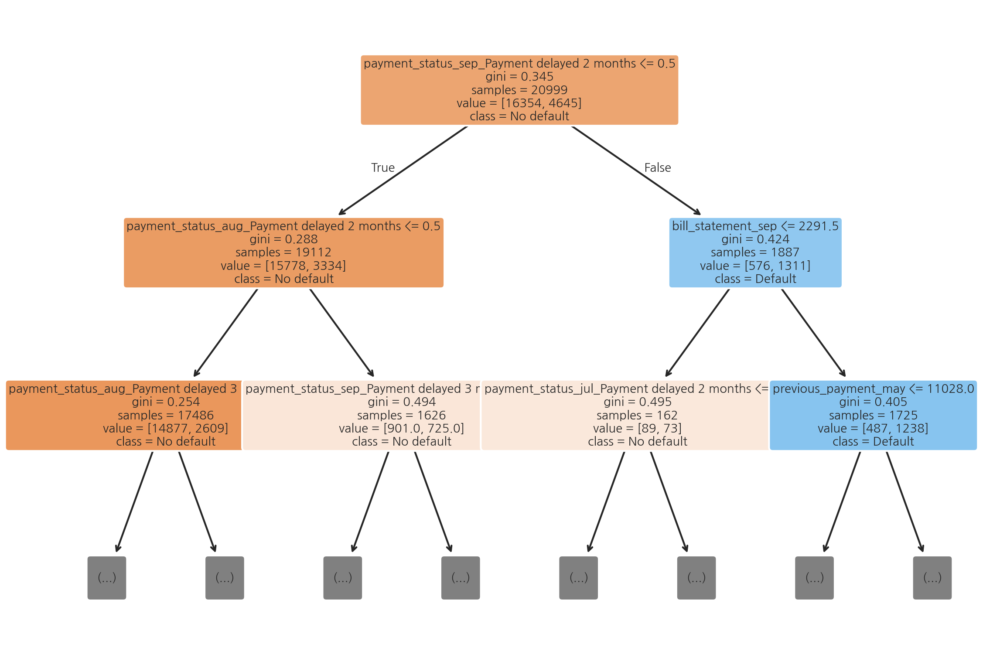

In [63]:
# 의사결정 트리 시각화
# max_depth=2: 트리의 최대 깊이를 2로 제한
# feature_names: 피처 이름을 X_train_ohe의 컬럼명으로 지정
# class_names: 클래스 이름을 "No default"와 "Default"로 지정
# rounded=True: 노드 모서리를 둥글게 표시
# filled=True: 노드를 색상으로 채움
plot_tree(
    tree_classifier, 
    max_depth=2,
    feature_names = X_train_ohe.columns, 
    class_names=["No default", "Default"],
    rounded=True, 
    filled = True, 
    fontsize=10
)

# 테두리 제거
sns.despine()
# 그래프 여백 조정
plt.tight_layout()
# plt.savefig("images/figure_13_17", dpi=200)

그림 13.20: 최대 깊이 2로 제한된 학습된 의사결정 트리

그림 13.20에서 우리는 추가적인 정보를 확인할 수 있습니다:

- 분할을 생성하는 데 사용된 피처의 이름
- 각 노드/리프에서 지배적인 클래스의 이름

의사결정 트리를 시각화하면 여러 이점이 있습니다. 첫째, 모델을 생성하는 데 사용된 피처(피처 중요도의 측정 가능성)와 분할을 생성하는 데 사용된 값을 이해할 수 있습니다. 피처가 명확한 해석을 가지고 있다면, 이는 초기 가설이 데이터와 문제에 대해 타당한지, 상식이나 도메인 지식과 일치하는지 확인하는 일종의 점검 수단으로 활용될 수 있습니다. 또한, 비즈니스 이해관계자에게 명확하고 일관된 설명을 제공하는 데도 도움이 됩니다. 이들은 모델의 간단한 표현을 쉽게 이해할 수 있습니다. 다음 장에서 피처 중요도와 모델 설명 가능성에 대해 깊이 논의할 예정입니다.

### There's more

우리는 이미 이진 분류 작업을 해결하기 위해 ML 모델(이 경우 의사결정 트리)을 사용하는 기본 사항을 다루었습니다. 또한 가장 인기 있는 분류 평가 지표를 살펴보았습니다. 하지만 여전히 언급할 가치가 있는 흥미로운 주제가 몇 가지 있습니다.

**분류 평가 지표에 대한 심화 탐구 : Precision-recall curve**

우리가 다룬 지표 중 하나는 ROC 곡선이었습니다. 그러나 클래스 불균형이 심할 때는 모델 성능을 평가하는 데 ROC 곡선이 신뢰성을 잃을 수 있습니다. 이러한 경우에는 **정밀도-재현율(PR) 곡선**을 사용하는 것이 좋습니다. 이는 정밀도와 재현율을 계산할 때 참 음성을 사용하지 않고, 소수 클래스(양성 클래스)의 정확한 예측만 고려하기 때문입니다.

우리는 예측된 점수/확률을 추출하고 다양한 임계값에 대한 정밀도와 재현율을 계산하는 것부터 시작합니다:

In [64]:
# 의사결정 트리 모델의 예측 확률 계산 (클래스 1에 대한 확률)
y_pred_prob = tree_classifier.predict_proba(X_test_ohe)[:, 1]

# 다양한 임계값에 대한 정밀도-재현율 곡선 계산
precision, recall, _ = metrics.precision_recall_curve(y_test, 
                                                      y_pred_prob)

> 임계값이 실제로 필요하지 않기 때문에, 해당 함수의 출력에서 언더스코어로 대체합니다.

필요한 요소를 계산한 후, 곡선을 그릴 수 있습니다:

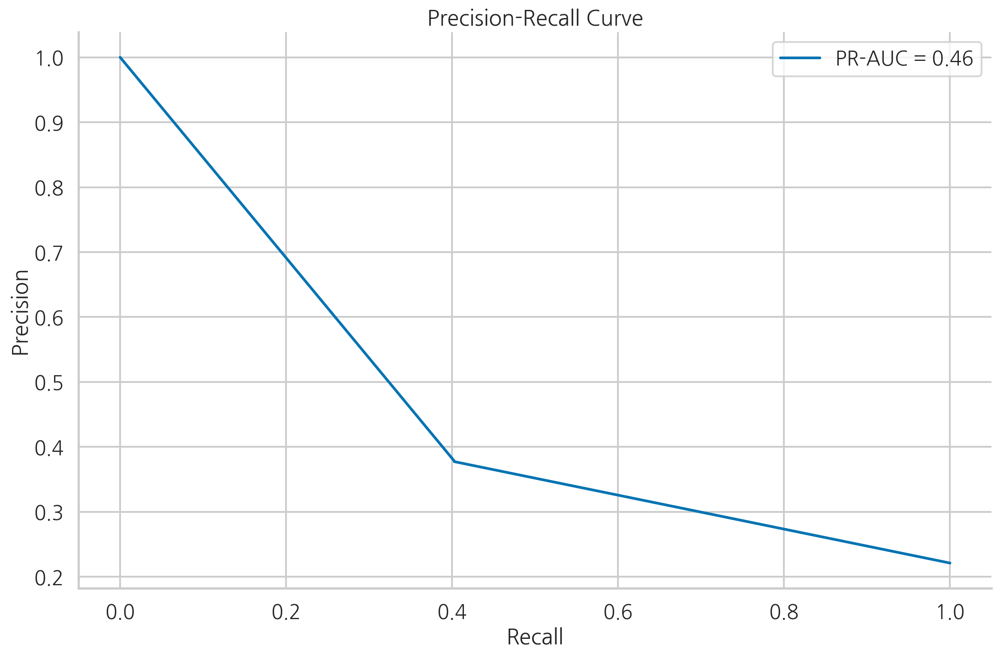

In [65]:
ax = plt.subplot()
ax.plot(recall, precision, 
        label=f"PR-AUC = {metrics.auc(recall, precision):.2f}")
ax.set(title="Precision-Recall Curve", 
       xlabel="Recall", 
       ylabel="Precision")
ax.legend()

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_19", dpi=200)

그림 13.22: 학습된 의사결정 트리 분류기의 정밀도-재현율(PR) 곡선

ROC 곡선과 유사하게, PR 곡선도 다음과 같이 분석할 수 있습니다:

- 곡선의 각 점은 다른 결정 임계값에 대한 정밀도와 재현율 값을 나타냅니다.
- 임계값이 0이면 정밀도는 0이고, 재현율은 1입니다.
- 임계값이 1이면 정밀도는 1이고, 재현율은 0입니다.
- 요약 지표로서, PR 곡선 아래 면적(PR-AUC)으로 성능을 나타낼 수 있습니다.
- PR-AUC는 0에서 1 사이의 값을 가지며, 1에 가까울수록 완벽한 모델을 의미합니다.
- PR-AUC가 1인 모델은 모든 양성 관측값을 식별하면서도 음성 관측값을 잘못된 양성으로 분류하지 않는 완벽한 재현율과 정밀도를 가집니다. 완벽한 지점은 (1, 1)로, 플롯의 오른쪽 상단 코너에 위치합니다.
- (1, 1) 지점으로 향하는 모델은 성능이 뛰어나다고 할 수 있습니다.

그림 13.22의 PR 곡선에서 발생할 수 있는 문제 중 하나는 각 임계값에 대한 정밀도와 재현율 값을 플로팅할 때 수행되는 보간으로 인해 과도하게 낙관적일 수 있다는 점입니다. 보다 현실적인 표현은 다음 코드 조각을 사용하여 얻을 수 있습니다:

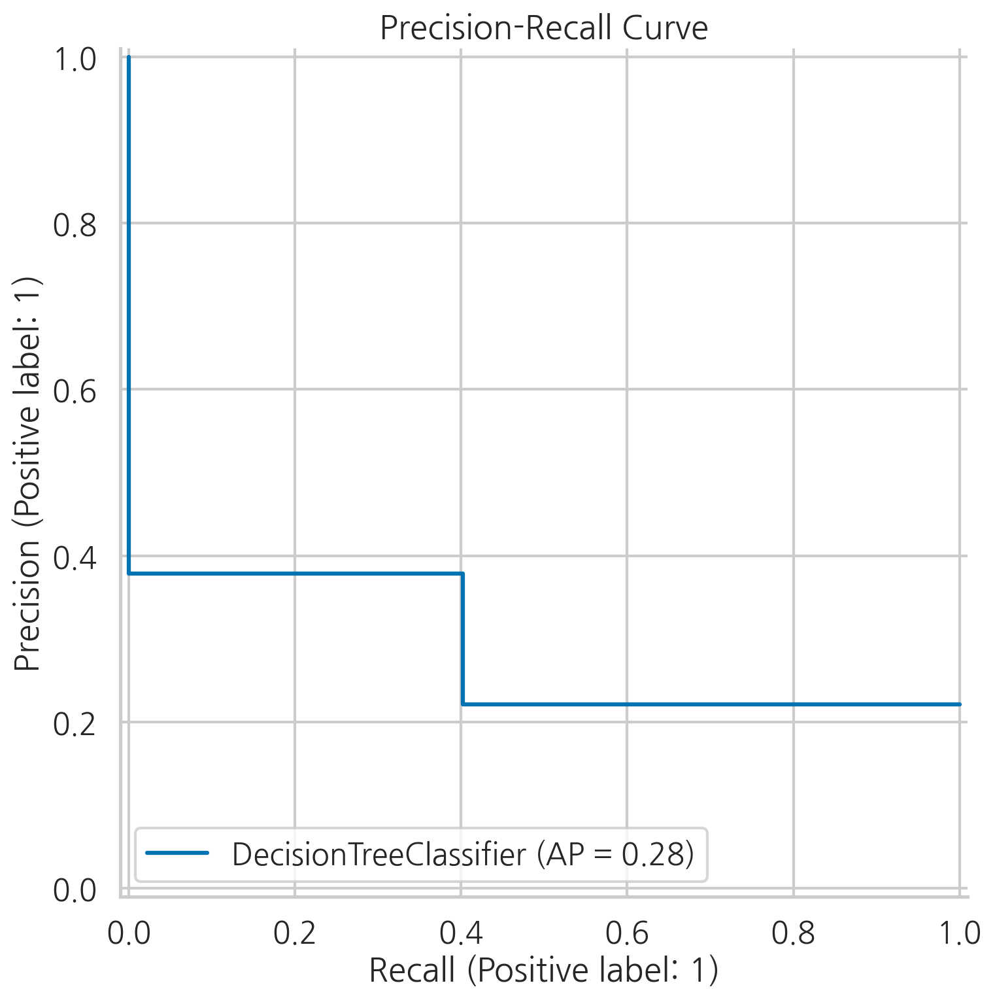

In [66]:
# metrics.PrecisionRecallDisplay.from_estimator()를 사용하여 PR 곡선 생성
# tree_classifier 모델, 테스트 데이터 X_test_ohe와 y_test를 입력으로 사용
ax = metrics.PrecisionRecallDisplay.from_estimator(
    tree_classifier, X_test_ohe, y_test
)

# 그래프 제목 설정
ax.ax_.set_title("Precision-Recall Curve")

# 테두리 제거
sns.despine()

# 그래프 레이아웃 조정
plt.tight_layout()

# 그래프 저장 (주석 처리됨)
# plt.savefig("images/figure_13_20", dpi=200)

그림 13.23: 학습된 의사결정 트리 분류기의 보다 현실적인 정밀도-재현율(PR) 곡선

첫째, 모양이 다르더라도 패턴을 쉽게 인식할 수 있으며, 보간이 실제로 어떤 역할을 하는지 이해할 수 있습니다. 플롯의 극단적인 점들을 (두 지표 값이 모두 약 0.4인) 단일 점으로 연결한다고 상상할 수 있으며, 이로 인해 보간을 사용할 때 얻는 모양이 나타납니다.

둘째, 점수가 상당히 감소한 것을 볼 수 있습니다(0.45에서 0.28로). 첫 번째 경우에는 PR 곡선의 사다리꼴 보간을 사용하여 점수를 얻었습니다(`auc(precision, recall)` in scikit-learn). 두 번째 경우에서 점수는 사실 **평균 정밀도(average precision)** 라는 또 다른 지표입니다. 평균 정밀도는 이전 임계값에서 재현율 증가를 가중치로 사용하여 각 임계값에서 얻은 정밀도의 가중 평균으로 정밀도-재현율 곡선을 요약합니다.

이 두 지표가 많은 경우에 매우 유사한 추정치를 산출하더라도, 근본적으로는 다릅니다. 첫 번째 접근 방식은 과도하게 낙관적인 선형 보간을 사용하며, 데이터가 심하게 치우치거나 불균형할 때 그 효과가 더 두드러질 수 있습니다.

우리는 이미 정밀도와 재현율의 조화 평균인 F1-Score를 다루었습니다. 사실, 이는 더 일반적인 지표인 Fβ-Score의 특정 사례입니다. 여기서 β 요소는 재현율에 어느 정도 가중치를 두는지 정의하며, 정밀도의 가중치는 1입니다. 가중치의 합이 1이 되도록 보정하기 위해 둘 다 (β + 1)로 나누어 정규화합니다. 이러한 점수 정의는 다음과 같은 의미를 가집니다:

- β > 1 — 재현율에 더 많은 가중치를 둠
- β = 1 — F1-Score와 동일하며, 정밀도와 재현율이 동일하게 취급됨
- β < 1 — 정밀도에 더 많은 가중치를 둠

정밀도, 재현율, F1-Score를 사용할 때의 잠재적인 문제점 중 하나는 이 지표들이 비대칭적이라는 점입니다. 즉, 양성 클래스에 중점을 둡니다. 공식에서 보면 참 음성 카테고리를 고려하지 않는다는 것을 알 수 있습니다. 이는 Matthew 상관 계수(MCC, phi-coefficient라고도 함)가 극복하려는 문제입니다.

$
\text{MCC} = \frac{TP \times TN - FP \times FN}{\sqrt{(TP + FP)(TP + FN)(TN + FP)(TN + FN)}}
$

공식을 분석하면 다음을 알 수 있습니다:

- 혼동 행렬의 모든 요소를 점수 계산에 고려합니다.
- 공식은 Pearson 상관 계수를 계산하는 데 사용되는 공식과 유사합니다.
- MCC는 참 클래스와 예측된 클래스를 두 개의 이진 변수로 간주하여, 그 상관 계수를 효과적으로 계산합니다.

MCC의 값은 -1(분류기가 항상 오분류하는 경우)에서 1(완벽한 분류기) 사이입니다. 0의 값은 분류기가 무작위 추측보다 나은 성과를 내지 못한다는 것을 의미합니다. 전반적으로, MCC는 대칭 지표이기 때문에 높은 값을 달성하려면 분류기가 양성 클래스와 음성 클래스를 모두 잘 예측해야 합니다.

> MCC는 F1-Score만큼 직관적이고 해석하기 쉬운 지표는 아니지만, 낮은 정밀도와 낮은 재현율의 비용이 알 수 없거나 측정할 수 없을 때 좋은 지표가 될 수 있습니다. 따라서, MCC는 더 균형 잡힌(대칭적) 분류기 평가를 제공합니다.

**dtreeviz를 사용한 의사결정 트리 시각화**

scikit-learn의 기본 플로팅 기능은 의사결정 트리를 시각화하는 데 충분히 유용하지만, **dtreeviz** 라이브러리를 사용하면 한 단계 더 나아갈 수 있습니다.

먼저, 라이브러리를 가져옵니다:


1. Import the libraries:

In [67]:
from dtreeviz.trees import *
from dtreeviz import trees

2. Fit a small decision tree with max depth of 3:

그런 다음, 최대 깊이 3의 작은 의사결정 트리를 학습시킵니다. 이는 시각화를 더 쉽게 읽을 수 있도록 하기 위함입니다. 아쉽게도 **dtreeviz**에서는 트리의 특정 수준만을 플로팅하는 옵션이 없습니다.

In [68]:
# 최대 깊이가 3인 작은 의사결정 트리 모델 생성
small_tree = DecisionTreeClassifier(max_depth=3, 
                                    random_state=42)
# 학습 데이터로 모델 학습
small_tree.fit(X_train_ohe, y_train)

DecisionTreeClassifier(max_depth=3, random_state=42)

마지막으로 트리를 플로팅합니다:

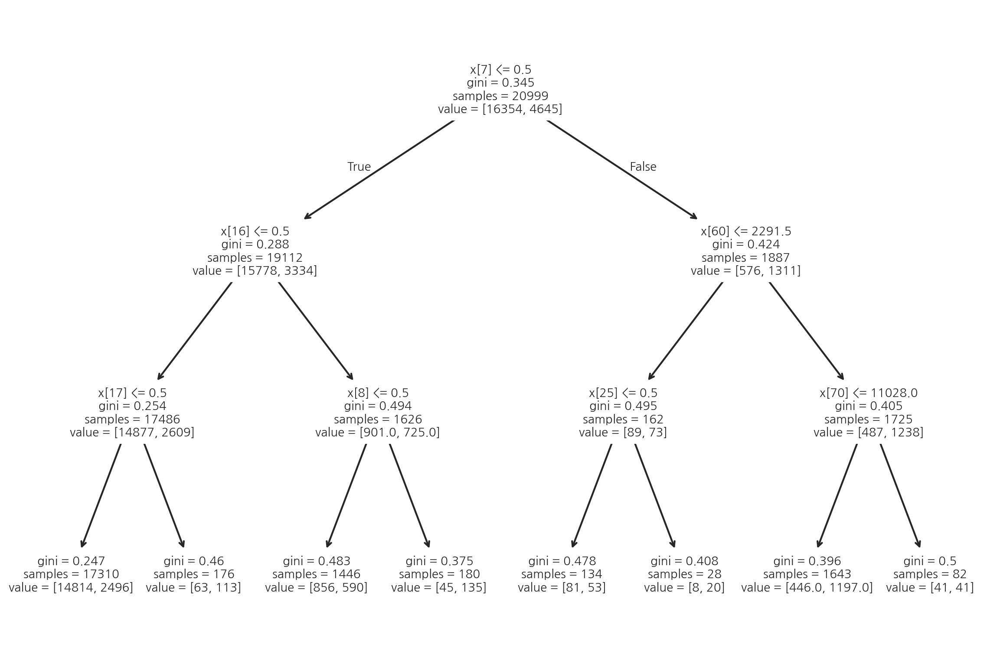

In [70]:
plot_tree(small_tree, max_depth=3, fontsize=10)

sns.despine()
plt.tight_layout()

이전에 생성된 플롯과 비교했을 때, **dtreeviz**로 생성된 플롯은 분할에 사용된 피처의 분포를 추가로 표시합니다(각 클래스별로 분리하여 표시). 또한, 리프 노드는 파이 차트로 표현됩니다.

3. Plot the decision tree using `dtreeviz`:

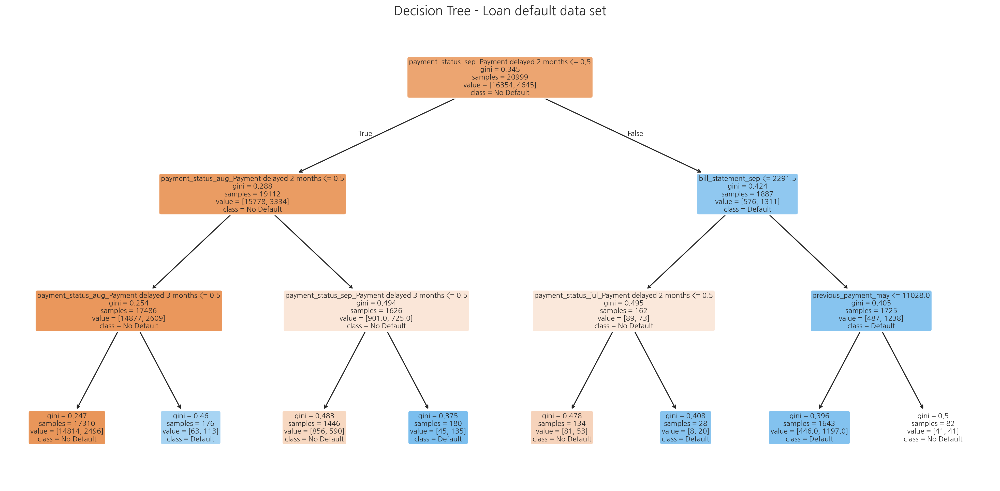

In [71]:
# viz = dtreeviz(small_tree, 
#                x_data=X_train_ohe,
#                y_data=y_train,
#                feature_names=X_train_ohe.columns, 
#                target_name="Default",
#                class_names=["No", "Yes"], 
#                title="Decision Tree - Loan default data set")
# viz

from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

plt.figure(figsize=(20,10))
plot_tree(small_tree, 
          feature_names=X_train_ohe.columns,
          class_names=["No Default", "Default"],
          filled=True,
          rounded=True,
          fontsize=10)

plt.title("Decision Tree - Loan default data set")
sns.despine()
plt.tight_layout()

4. Plot the simplified tree representation:

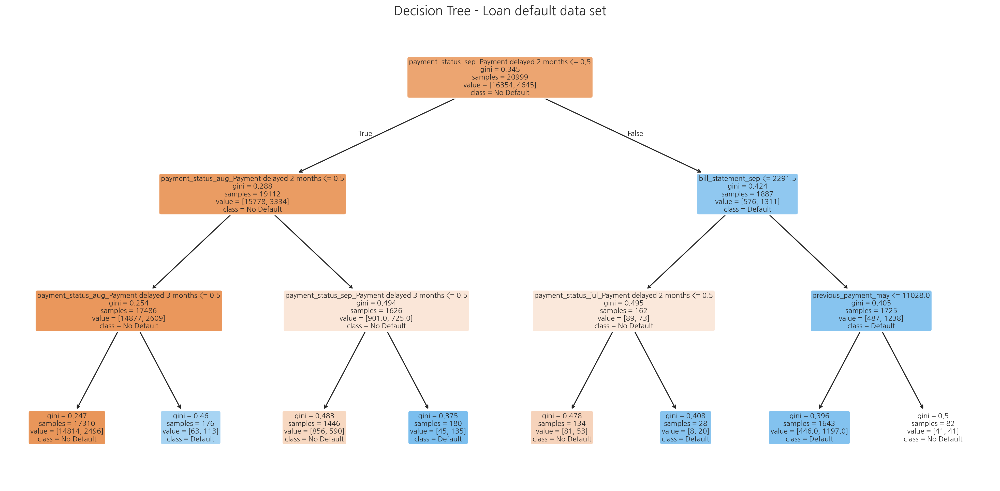

In [72]:
# viz = dtreeviz(small_tree, 
#                x_data=X_train_ohe,
#                y_data=y_train,
#                feature_names=X_train_ohe.columns, 
#                target_name="Default",
#                class_names=["No", "Yes"], 
#                title="Decision Tree - Loan default data set",
#                fancy=False)
# viz

plt.figure(figsize=(20,10))
plot_tree(small_tree, 
          feature_names=X_train_ohe.columns,
          class_names=["No Default", "Default"],
          filled=True,
          rounded=True,
          fontsize=10)

plt.title("Decision Tree - Loan default data set")
sns.despine()
plt.tight_layout()

5. Plot the simplified tree representation and the decision path of the first observation from the test set:

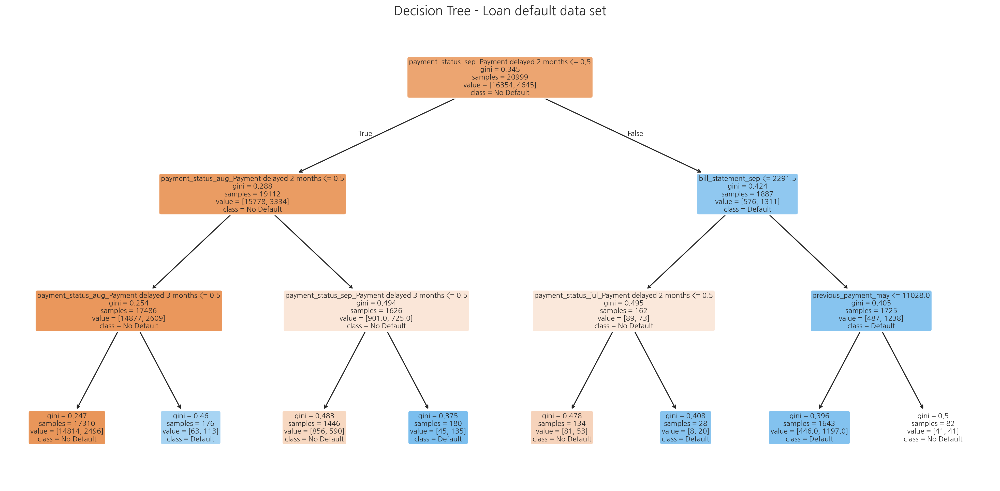

In [73]:
# viz = dtreeviz(small_tree, 
#                x_data=X_train_ohe,
#                y_data=y_train,
#                feature_names=X_train_ohe.columns, 
#                target_name="Default",
#                class_names=["No", "Yes"], 
#                title="Decision Tree - Loan default data set",
#                fancy=False,
#                X=X_test_ohe.iloc[0])
# viz

plt.figure(figsize=(20,10))
plot_tree(small_tree, 
          feature_names=X_train_ohe.columns,
          class_names=["No Default", "Default"],
          filled=True,
          rounded=True,
          fontsize=10)

plt.title("Decision Tree - Loan default data set")
sns.despine()
plt.tight_layout()

7. Print the prediction path using words:

In [74]:
# print(explain_prediction_path(small_tree, X_test_ohe.iloc[0], 
#                               feature_names=X_test_ohe.columns, 
#                               explanation_type="plain_english"))

def explain_decision_path(tree, sample, feature_names):
    """
    결정 트리의 예측 경로를 설명하는 함수
    
    Parameters:
    -----------
    tree : DecisionTreeClassifier
        학습된 결정 트리 모델
    sample : array-like
        설명하고자 하는 샘플
    feature_names : array-like
        특성 이름들
    """
    path = tree.decision_path(sample.values.reshape(1, -1))
    node_indices = path.indices
    
    print("Decision Path:")
    print("-" * 50)
    
    for i, node_id in enumerate(node_indices):
        if node_id == tree.tree_.node_count - 1:  # 리프 노드인 경우
            prediction = tree.classes_[tree.tree_.value[node_id].argmax()]
            print(f"\nFinal Prediction: {prediction}")
        else:
            feature = feature_names[tree.tree_.feature[node_id]]
            threshold = tree.tree_.threshold[node_id]
            value = sample[feature]
            
            if value <= threshold:
                direction = "<="
                next_direction = "left"
            else:
                direction = ">"
                next_direction = "right"
                
            print(f"Step {i+1}:")
            print(f"Feature: {feature}")
            print(f"Condition: {value:.2f} {direction} {threshold:.2f}")
            print(f"Going {next_direction}")
            print()

# 함수 사용
explain_decision_path(small_tree, X_test_ohe.iloc[0], X_test_ohe.columns)

Decision Path:
--------------------------------------------------
Step 1:
Feature: payment_status_sep_Payment delayed 2 months
Condition: 0.00 <= 0.50
Going left

Step 2:
Feature: payment_status_aug_Payment delayed 2 months
Condition: 0.00 <= 0.50
Going left

Step 3:
Feature: payment_status_aug_Payment delayed 3 months
Condition: 0.00 <= 0.50
Going left

Step 4:
Feature: previous_payment_may
Condition: 531.00 > -2.00
Going right



/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


## 13.7 Organizing the project with pipelines

**파이프라인을 사용한 프로젝트 구성**

이전의 예제들에서, 우리는 머신러닝 모델을 구축하는 데 필요한 모든 단계를 보여주었습니다. 데이터 로딩부터 시작해, 학습 및 테스트 세트로의 분할, 결측값 대체, 범주형 피처 인코딩, 마지막으로 의사결정 트리 분류기를 학습시키는 과정이 포함되었습니다.

이 과정은 특정 순서로 여러 단계를 실행해야 하며, 중간에 파이프라인을 수정할 필요가 있을 때 다소 까다로울 수 있습니다. 이러한 이유로 scikit-learn에서는 파이프라인을 도입했습니다. 파이프라인을 사용하면 데이터에 일련의 변환을 순차적으로 적용한 다음, 주어진 추정기(모델)를 학습시킬 수 있습니다.

중간 단계에서는 `fit`과 `transform` 메서드가 필요하고, 최종 추정기에서는 `fit` 메서드만 있으면 됩니다.

> scikit-learn의 용어에서, `fit` 및 `transform` 메서드를 포함하는 객체를 **변환기(transformers)** 라고 합니다. 우리는 이를 사용해 데이터를 정리하고 전처리합니다. 이미 다루었던 OneHotEncoder가 그 예입니다. 유사하게, `fit` 및 `predict` 메서드를 가진 객체를 **추정기(estimators)** 라고 합니다. 이들은 DecisionTreeClassifier와 같은 머신러닝 모델입니다.

파이프라인 사용의 장점은 다음과 같습니다:

- 흐름이 훨씬 더 읽기 쉽고 이해하기 쉬워지며, 주어진 열에서 실행할 작업의 순서가 명확해집니다.
- 데이터 누수를 방지하기가 더 쉬워집니다. 예를 들어, 학습 세트를 스케일링하고 교차 검증을 사용할 때 유용합니다.
- 파이프라인이 단계의 순서를 강제합니다.
- 재현성이 향상됩니다.

이 예제에서는, 데이터 로딩부터 분류기 학습까지 전체 프로젝트의 파이프라인을 만드는 방법을 보여줍니다.

### How to do it...

1. Import the libraries:

**1단계**에서 필요한 라이브러리를 가져옵니다. 이 목록이 다소 길어 보일 수 있지만, 이전 예제에서 사용된 여러 함수/클래스를 결합해야 하기 때문입니다.

In [85]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import Pipeline
from chapter_13_utils import performance_evaluation_report

2. Load the data, separate the target and create the stratified train-test split:

**2단계**에서는 CSV 파일에서 데이터를 로드하고, 피처에서 타겟 변수를 분리하며, 마지막으로 계층화된 학습-테스트 분할을 생성합니다.

In [76]:
# 신용카드 연체 데이터셋을 로드합니다. 결측값은 빈 문자열로 표시됩니다.
df = pd.read_csv("./datasets/credit_card_default.csv", na_values="")

# 데이터프레임을 복사하여 특성(X)과 타겟(y)으로 분리합니다.
X = df.copy()
y = X.pop("default_payment_next_month")

# 데이터를 학습용과 테스트용으로 분할합니다.
# test_size=0.2: 테스트 세트 크기를 20%로 설정
# stratify=y: 타겟 변수의 분포를 유지하며 분할
# random_state=42: 재현성을 위한 난수 시드 설정
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size=0.2, 
                                                    stratify=y, 
                                                    random_state=42)

3. Prepare lists of numerical/categorical features:

피처의 데이터 유형에 따라 다른 변환을 적용하기 위해 수치형 및 범주형 피처 목록 두 개를 만듭니다. 적절한 열을 선택하기 위해 `select_dtypes` 메서드를 사용합니다.

In [77]:
num_features = X_train.select_dtypes(include="number") \
                      .columns \
                      .to_list()
cat_features = X_train.select_dtypes(include="object") \
                      .columns \
                      .to_list()

In [78]:
# sanity check that all columns are included in the lists
len(X_train.columns) == (len(num_features) + len(cat_features))

True

4. Define the numerical pipeline:

**4단계**에서는 수치형 피처에 적용하려는 변환을 포함하는 첫 번째 **파이프라인**을 정의합니다. 여기서 우리는 피처의 결측값을 중앙값으로 대체하기만 하면 됩니다. `Pipeline` 클래스의 인스턴스를 생성할 때, 단계와 클래스 이름을 포함하는 튜플 목록을 제공합니다. 이 경우 `SimpleImputer` 클래스를 사용하며, 이는 **결측값 식별 및 처리** 예제에서 다루었던 클래스입니다.

In [79]:
num_pipeline = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median"))
])

5. Define the categorical pipeline:

**5단계**에서는 범주형 피처를 위한 유사한 파이프라인을 준비합니다. 그러나 이번에는 임퓨터(가장 빈번한 값 사용)와 원-핫 인코더라는 두 가지 다른 작업을 연결합니다. 인코더의 경우 가능한 모든 범주를 나열한 `cat_list`라는 목록을 지정합니다. 이는 교차 검증을 도입하는 다음 단계의 준비 작업으로, 일부 무작위 추출이 전체 범주를 포함하지 않을 수 있기 때문에 필요합니다.

In [80]:
cat_list = [
    list(X_train[col].dropna().unique()) for col in cat_features
]

cat_pipeline = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="most_frequent")),
    ("onehot", OneHotEncoder(categories=cat_list, 
                            sparse_output=False,  # sparse=False 대신 sparse_output=False 사용
                            handle_unknown="error", 
                            drop="first"))
])

이 코드는 범주형 변수들의 고유값(unique values)을 추출하는 리스트 컴프리헨션입니다. 각 단계별로 살펴보면:

1. `cat_features`는 범주형 컬럼들의 이름이 담긴 리스트입니다.

2. 각 범주형 컬럼(`col`)에 대해:
   - `X_train[col]`: 해당 컬럼의 데이터를 선택
   - `.dropna()`: 결측값(NA)을 제거
   - `.unique()`: 중복을 제거하고 고유값만 추출
   - `list()`: NumPy 배열을 파이썬 리스트로 변환

3. 결과적으로 `cat_list`는 각 범주형 변수의 가능한 모든 고유값을 담은 리스트들의 리스트가 됩니다.

예를 들어, 성별(sex)과 교육수준(education) 두 개의 범주형 변수가 있다면:
```python
# cat_features = ['sex', 'education']
# cat_list의 결과 예시:
[
    ['Male', 'Female'],  # sex 컬럼의 고유값
    ['High School', 'University', 'Graduate']  # education 컬럼의 고유값
]
```

이렇게 만든 `cat_list`는 나중에 OneHotEncoder에서 `categories` 파라미터로 사용됩니다. 이는 인코더가 각 범주형 변수에 대해 어떤 범주들을 고려해야 하는지 명시적으로 지정하는 역할을 합니다.

이렇게 하는 이유는:
1. 데이터의 일관성 유지
2. 새로운 범주가 등장했을 때 오류 처리 가능
3. 교차 검증 시 일부 폴드에서 특정 범주가 없더라도 안정적으로 처리 가능

6. Define the `ColumnTransformer` object: 

**6단계**에서는 `ColumnTransformer` 객체를 정의합니다. 일반적으로 `ColumnTransformer`는 서로 다른 열 그룹에 서로 다른 변환을 적용할 때 사용합니다. 우리의 경우, 수치형 및 범주형 피처에 대해 별도의 파이프라인을 가지고 있습니다. 다시 각 튜플에는 이름, 파이프라인, 변환을 적용할 열 목록이 포함됩니다. 또한, 추가 열을 삭제하도록 `remainder="drop"`을 지정합니다. 여기서 주의할 점은 `ColumnTransformer`가 `pandas` DataFrame 대신 `numpy` 배열을 반환한다는 것입니다.

> scikit-learn에서 사용할 수 있는 또 다른 유용한 클래스는 `FeatureUnion`입니다. 같은 입력 데이터를 서로 다른 방식으로 변환해야 할 때 사용할 수 있습니다. 예를 들어, 텍스트 데이터를 다루고 있고 TF-IDF(단어 빈도-역 문서 빈도) 벡터화와 텍스트 길이 추출이라는 두 가지 변환을 적용해야 할 때, 결과를 원래 데이터에 추가해 모델의 피처로 사용할 수 있습니다.

In [81]:
preprocessor = ColumnTransformer(
    transformers=[
        ("numerical", num_pipeline, num_features),
        ("categorical", cat_pipeline, cat_features)
    ], 
    remainder="drop"
)

7. Define the full pipeline including the decision tree model: 

**7단계**에서는 `Pipeline`을 다시 사용하여, 앞서 정의한 `ColumnTransformer` 객체(전처리기)와 의사결정 트리 분류기를 연결합니다(재현성을 위해 랜덤 상태를 42로 설정). 

In [82]:
dec_tree = DecisionTreeClassifier(random_state=42)

tree_pipeline = Pipeline(steps=[
    ("preprocessor", preprocessor),
    ("classifier", dec_tree)
])

8. Fit the pipeline to the data:

마지막 두 단계는 전체 파이프라인을 데이터에 맞추고 사용자 지정 함수로 성능을 평가하는 작업을 포함합니다.

In [83]:
tree_pipeline.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('numerical',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median'))]),
                                                  ['limit_bal', 'age',
                                                   'bill_statement_sep',
                                                   'bill_statement_aug',
                                                   'bill_statement_jul',
                                                   'bill_statement_jun',
                                                   'bill_statement_may',
                                                   'bill_statement_apr',
                                                   'previous_payment_sep',
                                                   'previous_payment_aug',
                                                   'previous_payment_j...
                                                                                              'months',
                                                                                              'Payment '
                                                                                              'delayed '
                                                                                              '7 '
                                                                                              'months',
                                                                                              'Payment '
                                                                                              'delayed '
                                                                                              '5 '
                                                                                              'months',
                                                                                              'Payment '
                                                                                              'delayed '
                                                                                              '8 '
                                                                                              'months']],
                                                                                 drop='first',
                                                                                 sparse_output=False))]),
                                                  ['sex', 'education',
                                                   'marriage',
                                                   'payment_status_sep',
                                                   'payment_status_aug',
                                                   'payment_status_jul',
                                                   'payment_status_jun',
                                                   'payment_status_may',
                                                   'payment_status_apr'])])),
                ('classifier', DecisionTreeClassifier(random_state=42))])

9. Evaluate the performance of the entire pipeline:

`performance_evaluation_report` 함수는 `predict`와 `predict_proba` 메서드를 가진 모든 추정기나 파이프라인에서 작동하도록 설계되었습니다. 이 함수는 예측과 해당 점수/확률을 얻는 데 사용됩니다.

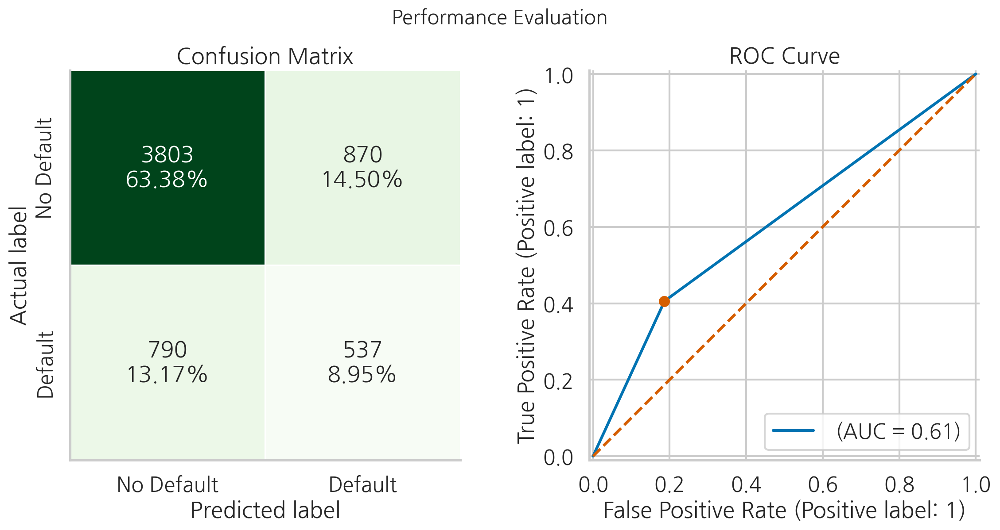

In [84]:
LABELS = ["No Default", "Default"]
tree_perf = performance_evaluation_report(tree_pipeline, X_test, 
                                          y_test, labels=LABELS, 
                                          show_plot=True)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_23", dpi=200)

그림 13.26: 학습된 파이프라인의 성능 평가 보고서

모델의 성능이 모든 단계를 개별적으로 수행했을 때와 매우 유사한 것을 볼 수 있습니다. 변화가 거의 없다는 점을 고려하면, 이는 우리가 기대했던 바로 그 결과입니다.

In [148]:
tree_perf

{'accuracy': 0.7233333333333334,
 'precision': 0.3816631130063966,
 'recall': 0.4046721929163527,
 'specificity': 0.8138240958698909,
 'f1_score': 0.3928310168251646,
 'cohens_kappa': 0.21388003714653614,
 'matthews_corr_coeff': 0.2140336931441623,
 'roc_auc': 0.6095279347712678,
 'pr_auc': 0.4589251149708047,
 'average_precision': 0.28616835280766334}

### There's more

#### Adding custom transformers to a pipeline

**파이프라인에 사용자 정의 변환기 추가**

이번 예제에서는 데이터 과학 프로젝트를 위한 전체 파이프라인을 만드는 방법을 보여주었습니다. 하지만 전처리 단계로 데이터를 처리하기 위해 적용할 수 있는 많은 다른 변환들이 있습니다. 그중 일부는 다음과 같습니다:

- **수치 피처의 스케일링:** 즉, 각 피처가 서로 다른 스케일로 측정되기 때문에 범위를 조정하는 것입니다. 이는 특히 피처 간의 거리를 계산하는 모델(예: k-최근접 이웃)이나 선형 모델을 사용할 때 중요합니다. scikit-learn에서 자주 사용하는 스케일링 옵션으로는 `StandardScaler`와 `MinMaxScaler`가 있습니다.
- **연속 변수 이산화:** 연속 변수를 제한된 수의 구간으로 변환할 수 있습니다(예: 나이 <25, 26-50, >51세). 특정 구간을 만들고 싶을 때는 `pd.cut` 함수를 사용해 분위수로 분할할 수 있습니다.
- **이상치 변환/제거:** 탐색적 데이터 분석(EDA) 동안 극단적인 값을 자주 볼 수 있는데, 이는 오류로 인해 발생하거나(예: 나이에 추가 숫자가 들어간 경우) 단순히 다른 값들과 호환되지 않을 수 있습니다(예: 중산층 샘플에 포함된 억만장자). 이러한 이상치는 모델의 결과를 왜곡시킬 수 있으며, 해결하는 것이 좋습니다. 해결책 중 하나는 아예 제거하는 것이지만, 이로 인해 모델의 일반화 능력에 영향을 줄 수 있습니다. 또한, 이상치를 일반 값에 더 가깝게 변경할 수도 있습니다.

> 의사결정 트리 기반의 ML 모델은 스케일링이 필요하지 않습니다.

이 예제에서는 이상치를 탐지하고 수정하기 위한 사용자 정의 변환기를 만드는 방법을 보여줍니다. 간단한 규칙을 적용하여 평균에서 ±3 표준편차를 벗어난 값을 제한합니다. 이를 위한 전용 변환기를 만들어 이전에 설정된 파이프라인에 이상치 처리를 통합합니다:

1. 먼저 `sklearn`에서 기본 추정기 및 변환기 클래스를 가져옵니다:

1. Import the base estimator and transformer classes from `sklearn`: 

In [86]:
from sklearn.base import BaseEstimator, TransformerMixin
import numpy as np

사용자 정의 변환기를 scikit-learn의 파이프라인과 호환되게 하려면 `fit`, `transform`, `fit_transform`, `get_params`, `set_params`와 같은 메서드를 포함해야 합니다.

모든 것을 수동으로 정의할 수도 있지만, Python의 **클래스 상속**을 사용하여 과정을 더 쉽게 만드는 것이 훨씬 더 유용합니다. 이를 위해 scikit-learn에서 `BaseEstimator`와 `TransformerMixin` 클래스를 가져옵니다. `TransformerMixin`을 상속받으면 `fit_transform` 메서드를 지정할 필요가 없고, `BaseEstimator`를 상속받으면 `get_params`와 `set_params` 메서드를 자동으로 제공합니다.

> 학습의 일환으로, scikit-learn의 인기 있는 변환기/추정기의 코드 일부를 탐구하는 것은 매우 유익합니다. 이를 통해 객체 지향 프로그래밍의 모범 사례를 배우고, 모든 클래스가 동일한 가이드라인과 원칙을 일관되게 따르는 방식을 관찰하고 이해할 수 있습니다.

2. Define the `OutlierRemover` class:

이 클래스는 다음과 같은 구성 요소로 나눌 수 있습니다:

- `__init__` 메서드에서 관측값이 이상치로 처리될지를 결정하는 표준편차의 수를 저장합니다(기본값은 3).
- `fit` 메서드에서 이상치로 간주되는 상한 및 하한 임계값과 전체 피처 수를 저장합니다.
- `transform` 메서드에서 `fit` 메서드에서 결정된 임계값을 초과하는 모든 값을 제한합니다.

> 대안으로, pandas DataFrame의 `clip` 메서드를 사용하여 극단값을 제한할 수도 있습니다.

이 클래스의 알려진 한계 중 하나는 결측값을 처리하지 않는다는 점입니다. 따라서 결측값이 있는 경우 `ValueError`를 발생시킵니다. 또한, 결측값 문제를 방지하기 위해 `OutlierRemover`를 대체 후에 사용합니다. 물론, 변환기에서 결측값을 처리하도록 만들 수도 있지만, 그렇게 하면 코드가 더 길어지고 가독성이 떨어질 수 있습니다. 이는 독자에게 연습 문제로 남깁니다. 변환기를 구성할 때 결측값을 마스킹하는 방법에 대한 예시는 scikit-learn의 `SimpleImputer` 정의를 참조하십시오.

In [87]:
class OutlierRemover(BaseEstimator, TransformerMixin):
    def __init__(self, n_std=3):
        # n_std: 이상치를 판단하는 기준이 되는 표준편차의 수 (기본값: 3)
        self.n_std = n_std
    
    def fit(self, X, y = None):
        # 결측값이 있는지 확인하고 있으면 에러 발생
        if np.isnan(X).any(axis=None):
            raise ValueError("""There are missing values in the array! 
                                Please remove them.""")

        # 각 특성의 평균과 표준편차 계산
        mean_vec = np.mean(X, axis=0)  # 각 열(특성)의 평균
        std_vec = np.std(X, axis=0)    # 각 열(특성)의 표준편차
        
        # 상한선 계산: 평균 + n_std * 표준편차
        self.upper_band_ = pd.Series(mean_vec + self.n_std * std_vec)
        self.upper_band_ = self.upper_band_.to_frame().transpose()
        
        # 하한선 계산: 평균 - n_std * 표준편차 
        self.lower_band_ = pd.Series(mean_vec - self.n_std * std_vec)
        self.lower_band_ = self.lower_band_.to_frame().transpose()
        
        # 특성의 수 저장
        self.n_features_ = len(self.upper_band_.columns)
        
        return self 
    
    def transform(self, X, y = None):
        # 입력 데이터 복사
        X_copy = pd.DataFrame(X.copy())
        
        # 모든 행에 대해 상한선과 하한선 배열 생성
        upper_band = pd.concat(
            [self.upper_band_] * len(X_copy), 
            ignore_index=True
        )
        lower_band = pd.concat(
            [self.lower_band_] * len(X_copy), 
            ignore_index=True
        )
        
        # 상한선보다 큰 값은 상한선으로, 하한선보다 작은 값은 하한선으로 대체
        X_copy[X_copy >= upper_band] = upper_band
        X_copy[X_copy <= lower_band] = lower_band
        
        # numpy 배열로 변환하여 반환
        return X_copy.values

3. Add the `OutlierRemover` to the numerical pipeline:

In [88]:
num_pipeline = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median")),
    ("outliers", OutlierRemover())
])

4. Execute the rest of the pipeline to compare the results: 

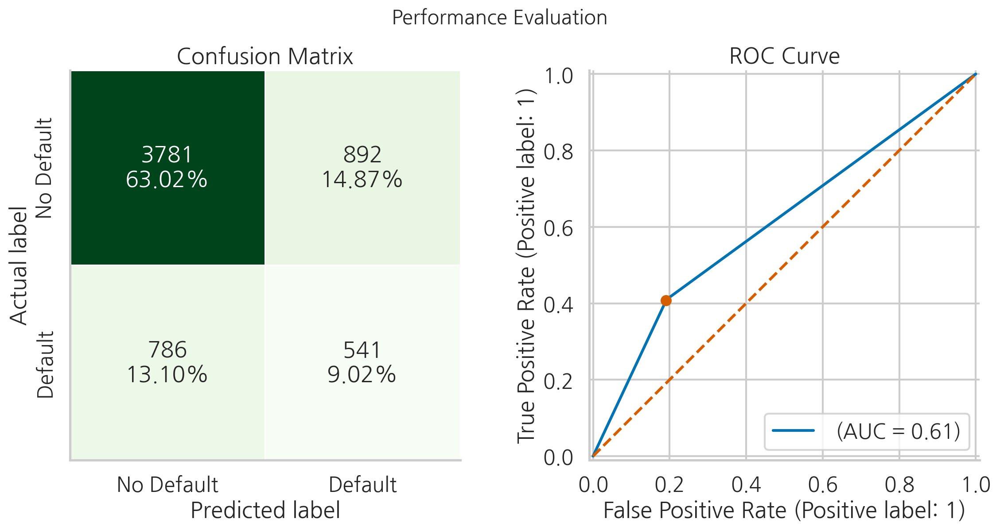

In [89]:
preprocessor = ColumnTransformer(transformers=[
    ("numerical", num_pipeline, num_features),
    ("categorical", cat_pipeline, cat_features)],
    remainder="drop")

dec_tree = DecisionTreeClassifier(random_state=42)

tree_pipeline = Pipeline(steps=[("preprocessor", preprocessor),
                                ("classifier", dec_tree)])

tree_pipeline.fit(X_train, y_train)

tree_perf = performance_evaluation_report(tree_pipeline, X_test, 
                                          y_test, labels=LABELS, 
                                          show_plot=True)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_24", dpi=200)

그림 13.27: 이상치 처리를 포함한 파이프라인의 성능 평가 보고서

이상치 제한 변환을 포함시켜도 전체 파이프라인의 성능에는 큰 변화가 없었습니다.

In [153]:
tree_perf

{'accuracy': 0.7203333333333334,
 'precision': 0.377529658060014,
 'recall': 0.4076865109269028,
 'specificity': 0.8091161994436122,
 'f1_score': 0.39202898550724635,
 'cohens_kappa': 0.21077497538963086,
 'matthews_corr_coeff': 0.2110374148258694,
 'roc_auc': 0.608982787005664,
 'pr_auc': 0.4582134167657523,
 'average_precision': 0.2850810668089482}

#### 파이프라인 요소 접근하기

파이프라인은 프로젝트를 재현하기 쉽게 하고 데이터 누수의 가능성을 줄여주지만, 파이프라인의 요소에 추가로 접근하거나 대체하는 것은 약간 더 어려워집니다. 몇 가지 예를 통해 이를 설명하겠습니다.

우선, 다음 코드 스니펫을 사용하여 파이프라인 전체를 딕셔너리 형식으로 표시합니다:

1. Display the structure of the pipeline:

이 구조를 사용하여, 파이프라인 끝에 있는 머신러닝 모델에 할당된 이름을 통해 접근할 수 있습니다:

In [154]:
tree_pipeline.named_steps

{'preprocessor': ColumnTransformer(transformers=[('numerical',
                                  Pipeline(steps=[('imputer',
                                                   SimpleImputer(strategy='median')),
                                                  ('outliers',
                                                   OutlierRemover())]),
                                  ['limit_bal', 'age', 'bill_statement_sep',
                                   'bill_statement_aug', 'bill_statement_jul',
                                   'bill_statement_jun', 'bill_statement_may',
                                   'bill_statement_apr', 'previous_payment_sep',
                                   'previous_payment_aug',
                                   'previous_payment_jul...
                                                                              'months',
                                                                              'Payment '
                                          

2. Access the estimator at the end of the pipeline:

In [155]:
tree_pipeline.named_steps["classifier"]

DecisionTreeClassifier(random_state=42)

3. Access the upper thresholds of the fitted `OutlierRemover` transformer:

`ColumnTransformer` 안으로 더 깊이 들어가야 할 때는 조금 더 복잡해집니다. 예를 들어, `OutlierRemover`의 상한 값을 확인하려면(`upper_band_` 속성), 다음과 같은 코드를 사용해야 합니다:

In [156]:
(
    tree_pipeline
    .named_steps["preprocessor"]
    .named_transformers_["numerical"]["outliers"]
    .upper_band_
)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,555890.511578,62.945993,271626.004006,261528.147261,252069.405868,235292.85113,222044.17518,216598.486524,54067.496948,66637.658658,57755.3464,49971.471286,49914.412427,58779.830767


먼저, 파이프라인 끝에 있는 추정기에 접근할 때 사용했던 방법과 동일한 접근 방식을 따릅니다. 이번에는 `ColumnTransformer`가 포함된 단계의 이름을 사용했습니다. 그런 다음, `named_transformers_` 속성을 사용하여 변환기의 더 깊은 레벨에 접근하고, 각각의 이름을 사용하여 이상치 처리 단계를 선택했습니다. 마지막으로, 사용자 정의 변환기의 상한 값에 접근했습니다.

> `ColumnTransformer`의 단계에 접근할 때, `named_transformers_` 속성 대신 `transformers_` 속성을 사용할 수도 있습니다. 그러나 이 경우 출력은 우리가 `ColumnTransformer`를 정의할 때 수동으로 제공한 것과 동일한 튜플 목록이 됩니다. 이러한 요소에 정수 인덱스를 사용하여 접근해야 합니다. 노트북에서는 `transformers_` 속성을 사용하여 상한 값에 접근하는 방법을 보여줍니다.

In [157]:
( 
    tree_pipeline
    .named_steps["preprocessor"]
    .transformers_[0][1]["outliers"]
    .upper_band_
)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,555890.511578,62.945993,271626.004006,261528.147261,252069.405868,235292.85113,222044.17518,216598.486524,54067.496948,66637.658658,57755.3464,49971.471286,49914.412427,58779.830767


## 13.8 Tuning hyperparameters using grid search and cross-validation

**그리드 검색과 교차 검증을 통한 하이퍼파라미터 튜닝**

이전 예제에서 우리는 고객이 대출을 연체할지 예측하기 위해 의사결정 트리 모델을 사용합니다. 보았듯이, 트리는 44 레벨의 깊이를 가진 거대한 구조가 되었고, 시각화가 어려워졌습니다. 하지만, 이는 모델이 학습 데이터에 과적합되었을 가능성을 의미할 수도 있습니다. 깊이 제한은 실제로 의사결정 트리의 하이퍼파라미터 중 하나이며, 이를 튜닝하여 성능을 개선하고 과적합과 과소적합 간의 균형을 찾을 수 있습니다.

우선, 하이퍼파라미터의 몇 가지 특성을 요약합니다:

- 모델의 외적 특성
- 데이터에 기반하지 않음
- 모델의 설정으로 간주 가능
- 학습 전에 설정됨
- 튜닝 시 성능 향상이 가능

또한 파라미터의 몇 가지 특성도 고려할 수 있습니다:

- 모델의 내적 특성
- 데이터에 기반해 추정됨 (예: 선형 회귀의 계수)
- 학습 중에 학습됨

모델의 하이퍼파라미터를 튜닝할 때는 학습에 사용되지 않은 데이터로 성능을 평가하고자 합니다. **훈련 및 테스트 세트로 데이터 분할하기**에서 설명했듯이, 추가적인 검증 세트를 사용하여 하이퍼파라미터를 튜닝할 수 있습니다. 그러나 검증 세트를 사용하면 학습에 사용할 수 있는 데이터가 줄어들어 특히 작은 데이터셋에서는 불리할 수 있습니다.

이 때문에 교차 검증이 인기를 얻습니다. 교차 검증은 모델의 일반화 오류에 대한 신뢰할 수 있는 추정치를 얻을 수 있게 하는 기법입니다. 예를 들어 k-겹 교차 검증을 사용할 때, 학습 데이터를 임의로 k개의 폴드로 나누고, k-1개의 폴드로 모델을 학습한 후 나머지 폴드로 성능을 평가합니다. 이 과정을 k번 반복하고, 그 결과를 평균하여 성능을 평가합니다.

교차 검증의 잠재적 단점은 특히 하이퍼파라미터 튜닝을 위한 그리드 검색과 결합할 때 계산 비용이 많이 든다는 점입니다.


<img src="image/fig_13_28.PNG" alt="그림 13.28" width="800">

그림 13.28은 5-겹 교차 검증 절차의 개요를 보여줍니다. 각 라운드에서 훈련 세트와 검증 세트를 다르게 설정하여 모델을 학습하고 평가합니다. 

우리는 이미 **그리드 검색**이 하이퍼파라미터 튜닝에 자주 사용되는 기법이라는 점을 언급했습니다. 기본 개념은 가능한 모든 하이퍼파라미터 조합으로 이루어진 그리드를 생성하고 모델을 각 조합으로 학습시키는 것입니다. 이 접근법은 최적의 파라미터를 보장하지만, 파라미터나 값이 많아질수록 필요한 모델 학습과 예측의 수가 기하급수적으로 증가하여 계산 비용이 크게 증가할 수 있습니다.

하이퍼파라미터 $a$ 와 $b$ 를 가진 모델을 학습한다고 가정하여 예를 들어보겠습니다. 각 하이퍼파라미터에 대한 가능한 값이 3개씩 있고, 그리드에는 6개의 조합이 존재하며, 각 조합에 대해 5-겹 교차 검증을 사용한다면, 최종적으로 30개의 모델이 그리드 검색 절차에서 학습됩니다.

그리드 검색의 문제를 해결하기 위한 잠재적 해결책으로, **랜덤 검색**(랜덤화된 그리드 검색이라고도 함)을 사용할 수 있습니다. 이 방법에서는 하이퍼파라미터의 임의의 세트를 선택하여 모델을 학습하고, 그 결과를 반환한 후 이 과정을 반복합니다. 랜덤 검색은 매우 큰 그리드일 때 그리드 검색보다 선호됩니다. 이는 최적의 조합에 근접하는 하이퍼파라미터를 훨씬 적은 시간에 찾을 가능성이 있기 때문입니다.

### Getting ready

Please execute the code from the previous recipe before running this one!

### How to do it...

1. Import the libraries:

In [90]:
from sklearn.model_selection import (
    GridSearchCV, cross_val_score, 
    RandomizedSearchCV, cross_validate, 
    StratifiedKFold
)
from sklearn import metrics

2. Define the cross-validation scheme:

**2단계**에서는 5-폴드 교차 검증 방식(fold cross-validation scheme)을 정의합니다. 데이터에는 고유한 순서가 없으므로 셔플링을 사용하고 재현성을 위해 랜덤 시드를 지정합니다. 층화(stratification)를 사용하여 각 폴드에 타겟 변수의 클래스 비율이 비슷하게 포함되도록 합니다. 불균형 클래스 문제를 다룰 때는 이러한 설정이 매우 중요합니다.

In [91]:
k_fold = StratifiedKFold(5, shuffle=True, random_state=42)

3. Evaluate the pipeline using cross-validation:

**3단계**에서는 파이프라인을 전체 프로젝트의 파이프라인 구성에서 정의하고 **cross_val_score** 함수를 사용해 평가합니다. 파이프라인(전체 파이프라인), 훈련 데이터, 교차 검증 매개변수 등을 함수에 전달합니다. 분류 문제인 경우에는 k-폴드 교차 검증이 기본값으로 자동 적용되지만, 사용자 정의 방식으로 랜덤 상태를 정의해 결과의 재현성을 보장합니다.

> **주:** 파이프라인의 또 다른 장점은 교차 검증 중에 정보를 누출하지 않는다는 점입니다. 파이프라인이 없을 경우, 훈련 데이터에 대해 변환을 적용하고 나서 훈련 및 테스트 세트를 각각 변환해야 할 수도 있습니다. 반면, 파이프라인을 사용하면 테스트 세트에 대한 정보가 누출되지 않도록 보장할 수 있습니다.

In [92]:
cross_val_score(tree_pipeline, X_train, y_train, cv=k_fold)

array([0.72333333, 0.72958333, 0.71375   , 0.723125  , 0.72      ])

4. Add extra metrics to cross-validation:

**4단계**에서는 **cross_validate** 함수를 사용해 교차 검증을 확장합니다. 이 함수는 여러 평가 기준을 사용할 수 있어 더욱 유연합니다(여기서는 정확도, 정밀도, 재현율, ROC AUC를 사용). 또한 훈련 및 추론 단계에 소요된 시간도 기록해 결과를 **pandas DataFrame**으로 반환합니다.

In [93]:
cv_scores = cross_validate(tree_pipeline, X_train, y_train, cv=k_fold, 
                           scoring=["accuracy", "precision", "recall", 
                                    "roc_auc"])
pd.DataFrame(cv_scores)

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_roc_auc
0,0.503517,0.104203,0.723333,0.385604,0.424128,0.616333
1,0.540296,0.095325,0.729583,0.395575,0.420904,0.618938
2,0.539419,0.095932,0.713750,0.369783,0.417137,0.607940
3,0.548620,0.095442,0.723125,0.386383,0.427495,0.618066
4,0.486405,0.094379,0.720000,0.376748,0.405838,0.607129


5. Define the parameter grid:

**5단계**에서는 그리드 탐색에 필요한 매개변수 그리드를 정의합니다. 중요한 점은 **Pipeline** 객체와 작업할 때는 매개변수 이름 구성을 주의해야 한다는 것입니다. 그리드 사전의 키는 스텝/모델 이름과 하이퍼파라미터 이름이 두 개의 언더스코어로 연결된 형태로 구성됩니다. 예를 들어, 의사 결정 트리 분류기의 주요 하이퍼파라미터는 다음과 같습니다:

- **criterion**: 분할 기준으로 엔트로피 또는 지니 불순도를 결정합니다.
- **max_depth**: 트리의 최대 깊이입니다.
- **min_samples_leaf**: 리프 노드에 있어야 할 최소 샘플 수로, 관측값이 매우 적은 트리를 방지합니다.

또한, 평균에서 세 표준편차 또는 네 표준편차를 사용하여 이상치 여부를 결정하는 등 이상치 처리기도 실험합니다. **preprocessor** → **numerical** → **outliers** → **n_std**와 같이 이름 구성에 주의해야 합니다.

> **팁**: 모델(예: 의사 결정 트리 분류기)의 튜닝 시에는 하이퍼파라미터의 이름을 직접 사용해야 합니다.

In [94]:
param_grid = {
    "classifier__criterion": ["entropy", "gini"],
    "classifier__max_depth": range(3, 11),
    "classifier__min_samples_leaf": range(2, 11), 
    "preprocessor__numerical__outliers__n_std": [3, 4]
}

6. Run the exhaustive grid search: 

**6단계**에서는 **GridSearchCV** 인스턴스를 생성하고, 파이프라인 및 매개변수 그리드를 입력합니다. 또한, 평가 지표를 정밀도(recall)로 설정하여 최고의 성능을 보이는 모델을 선택합니다.

scikit-learn의 그리드 탐색 클래스와 함께 작업할 때, 여러 평가 지표(리스트나 딕셔너리로 지정)를 제공할 수 있습니다. 이는 학습된 모델을 더 심도 있게 분석하고자 할 때 매우 유용합니다. 여러 지표를 사용할 때는 최적의 하이퍼파라미터 조합을 결정할 지표를 refit 인자로 지정해야 한다는 점을 기억해야 합니다.

그런 다음, scikit-learn의 다른 추정기와 마찬가지로 GridSearchCV 객체의 fit 메서드를 사용합니다. 출력 결과에서 그리드가 288개의 하이퍼파라미터 조합을 포함하고 있음을 확인합니다. 각 조합에 대해 5개의 모델을 맞췄습니다(5-폴드 교차 검증).

> GridSearchCV의 기본 설정인 refit=True는 그리드 탐색이 완료된 후, 최적의 모델이 전체 훈련 세트에 다시 맞춰지도록 설정되어 있음을 의미합니다. 이를 통해 지정된 기준에 따라 식별된 추정기를 classifier_gs.predict(X_test)를 실행하여 직접 사용할 수 있습니다.

In [95]:
classifier_gs = GridSearchCV(tree_pipeline, param_grid, 
                             scoring="recall", cv=k_fold, 
                             n_jobs=-1, verbose=1)

classifier_gs.fit(X_train, y_train)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits


GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('numerical',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('outliers',
                                                                                          OutlierRemover())]),
                                                                         ['limit_bal',
                                                                          'age',
                                                                          'bill_statement_sep',
                                                                          'bill_statement_aug',
                                                                          'bill_statement_jul',
                                                                          'bill_statement...
                                                                          'payment_status_jul',
                                                                          'payment_status_jun',
                                                                          'payment_status_may',
                                                                          'payment_status_apr'])])),
                                       ('classifier',
                                        DecisionTreeClassifier(random_state=42))]),
             n_jobs=-1,
             param_grid={'classifier__criterion': ['entropy', 'gini'],
                         'classifier__max_depth': range(3, 11),
                         'classifier__min_samples_leaf': range(2, 11),
                         'preprocessor__numerical__outliers__n_std': [3, 4]},
             scoring='recall', verbose=1)

In [164]:
print(f"Best parameters: {classifier_gs.best_params_}") 
print(f"Recall (Training set): {classifier_gs.best_score_:.4f}") 
print(f"Recall (Test set): {metrics.recall_score(y_test, classifier_gs.predict(X_test)):.4f}")

Best parameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 10, 'classifier__min_samples_leaf': 7, 'preprocessor__numerical__outliers__n_std': 4}
Recall (Training set): 0.3858
Recall (Test set): 0.3775


7. Evaluate the performance of the tuned pipeline:

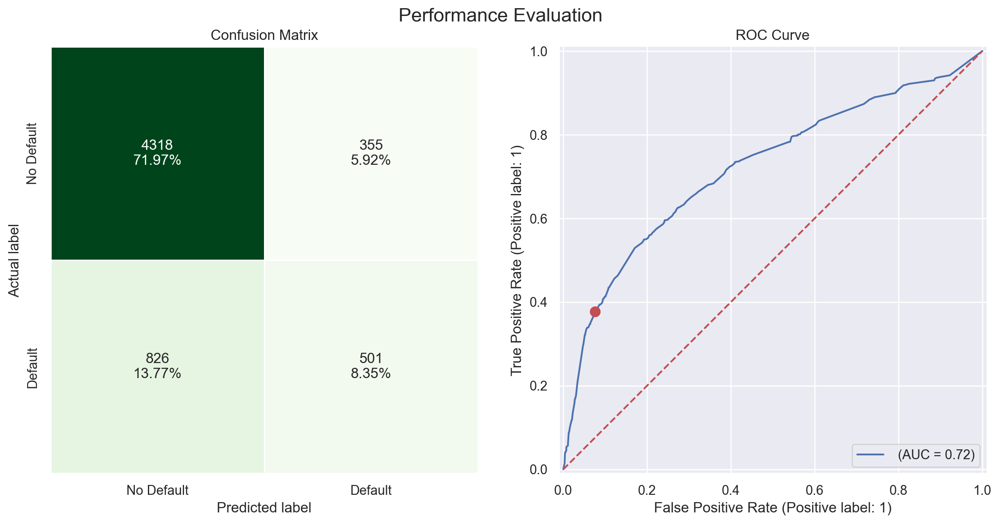

In [165]:
LABELS = ["No Default", "Default"]
tree_gs_perf = performance_evaluation_report(classifier_gs, X_test, 
                                             y_test, labels=LABELS, 
                                             show_plot=True)

sns.despine()
plt.tight_layout()
# plt.savefig("images/figure_13_26", dpi=200)

In [166]:
tree_gs_perf

{'accuracy': 0.8031666666666667,
 'precision': 0.5852803738317757,
 'recall': 0.3775433308214017,
 'specificity': 0.9240316713032314,
 'f1_score': 0.45900137425561155,
 'cohens_kappa': 0.34547526291831954,
 'matthews_corr_coeff': 0.35788321424347136,
 'roc_auc': 0.7205480311384921,
 'pr_auc': 0.4698784893189859,
 'average_precision': 0.4652985864969478}

8. Run the randomized grid search: 

**8단계**에서는 랜덤 그리드 탐색 인스턴스를 생성합니다. 이는 최대 반복 횟수를 지정할 수 있다는 점을 제외하면 일반적인 그리드 탐색과 유사합니다. 여기서는 파라미터 그리드에서 임의로 선택한 100개의 조합을 테스트했으며, 이는 사용 가능한 전체 조합의 약 1/3에 해당합니다.

전체 탐색 방식과 랜덤 방식 간의 또 다른 차이점은 랜덤 방식에서는 고유 값의 목록 대신 하이퍼파라미터 분포를 제공할 수 있다는 점입니다. 예를 들어, 0과 1 사이의 비율을 나타내는 하이퍼파라미터가 있다고 가정하면 다음과 같은 값을 지정할 수 있습니다: `[0, 0.2, 0.4, 0.6, 0.8, 1]`. 랜덤 탐색에서는 동일한 값을 사용해 무작위로 선택하거나, 하이퍼파라미터 값의 범위가 0에서 1 사이로 제한된 균등 분포에서 임의 값을 추출하는 방법도 선택할 수 있습니다.

> 기본적으로, scikit-learn는 다음과 같은 로직을 적용합니다. 모든 하이퍼파라미터가 리스트로 제공된 경우, 알고리즘은 교체 없이 샘플링을 수행합니다. 하나 이상의 하이퍼파라미터가 분포로 표시된 경우, 교체를 통한 샘플링이 대신 사용됩니다.

In [167]:
classifier_rs = RandomizedSearchCV(tree_pipeline, param_grid, 
                                   scoring="recall", cv=k_fold, 
                                   n_jobs=-1, verbose=1, 
                                   n_iter=100, random_state=42)
classifier_rs.fit(X_train, y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
                   estimator=Pipeline(steps=[('preprocessor',
                                              ColumnTransformer(transformers=[('numerical',
                                                                               Pipeline(steps=[('imputer',
                                                                                                SimpleImputer(strategy='median')),
                                                                                               ('outliers',
                                                                                                OutlierRemover())]),
                                                                               ['limit_bal',
                                                                                'age',
                                                                                'bill_statement_sep',
                                                                                'bill_statement_aug',
                                                                                'bill_statement_jul',
                                                                                'bill_sta...
                                                                                'payment_status_may',
                                                                                'payment_status_apr'])])),
                                             ('classifier',
                                              DecisionTreeClassifier(random_state=42))]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'classifier__criterion': ['entropy',
                                                                  'gini'],
                                        'classifier__max_depth': range(3, 11),
                                        'classifier__min_samples_leaf': range(2, 11),
                                        'preprocessor__numerical__outliers__n_std': [3,
                                                                                     4]},
                   random_state=42, scoring='recall', verbose=1)

In [168]:
print(f"Best parameters: {classifier_rs.best_params_}") 
print(f"Recall (Training set): {classifier_rs.best_score_:.4f}") 
print(f"Recall (Test set): {metrics.recall_score(y_test, classifier_rs.predict(X_test)):.4f}")

Best parameters: {'preprocessor__numerical__outliers__n_std': 3, 'classifier__min_samples_leaf': 7, 'classifier__max_depth': 10, 'classifier__criterion': 'gini'}
Recall (Training set): 0.3854
Recall (Test set): 0.3760


9. Evaluate the performance of the Randomized Grid Search:

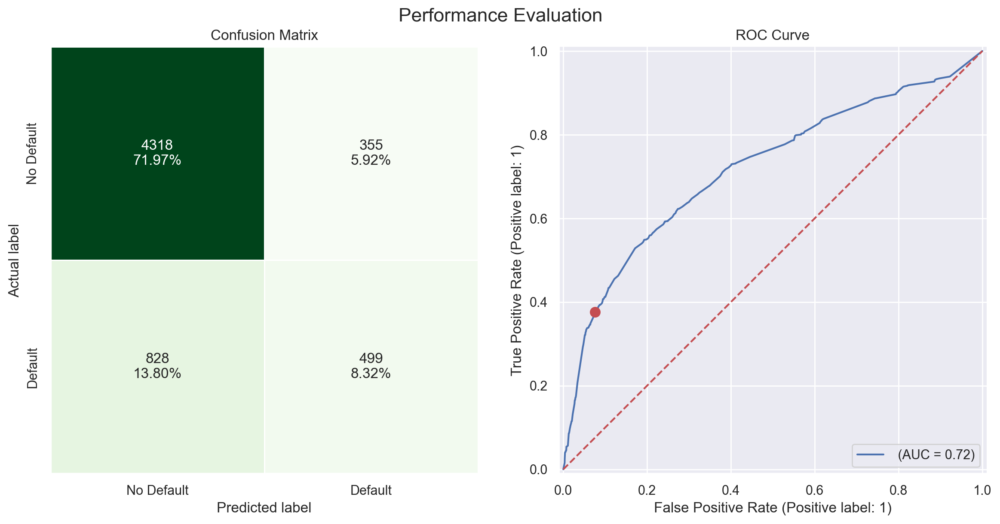

In [169]:
tree_rs_perf = performance_evaluation_report(classifier_rs, X_test, 
                                             y_test, labels=LABELS, 
                                             show_plot=True)

sns.despine()
plt.tight_layout()

In [170]:
tree_rs_perf

{'accuracy': 0.8028333333333333,
 'precision': 0.5843091334894613,
 'recall': 0.3760361718161266,
 'specificity': 0.9240316713032314,
 'f1_score': 0.45758826226501603,
 'cohens_kappa': 0.3439613201516819,
 'matthews_corr_coeff': 0.3564420906256157,
 'roc_auc': 0.7188330048148133,
 'pr_auc': 0.4686663337519278,
 'average_precision': 0.46397440653315936}

### There's more

#### 연속적인 반감법을 통한 더 빠른 탐색

모든 하이퍼파라미터 후보에 대해, grid search는 전체 데이터를 사용하여 모델/파이프라인을 학습합니다. scikit-learn은 연속적인 반감법(successive halving)에 기반한 추가적인 접근법인 halving grid search를 제공합니다.

알고리즘의 작동 방식은 다음과 같습니다. 첫 번째 단계에서 모든 후보 모델은 제한된 학습 데이터의 작은 부분(일반적으로 제한된 자원을 사용)을 통해 학습됩니다. 이후, 가장 성능이 좋은 후보는 더 큰 학습 데이터로 재학습됩니다. 이러한 단계를 반복하여 최적의 하이퍼파라미터 집합이 선정될 때까지 진행합니다. 이 방법에서 각 반복 이후, 사용되는 하이퍼파라미터 후보의 수가 줄어들며, 학습 데이터(자원) 사용량이 증가합니다.

> halving grid search의 기본 동작은 학습 데이터를 자원으로 사용하는 것입니다. 그러나 튜닝하려는 추정기에서 정수 값을 허용하는 모든 양수를 사용할 수 있습니다. 예를 들어, 각 반복마다 사용할 트리의 수(n_estimators)를 증가시켜 Random Forest 모델의 자원을 늘릴 수 있습니다.

알고리즘의 속도는 두 가지 하이퍼파라미터에 의해 결정됩니다:

- **min_resources**: 각 후보가 사용할 수 있는 자원의 최소 양입니다. 실제로 이는 첫 반복에서 사용되는 자원량과 일치합니다.
- **factor**: 반감 파라미터입니다. factor의 역수(1 / factor)는 각 반복에서 최고의 모델로 선택되는 후보의 비율을 결정합니다. factor와 이전 반복의 자원 수의 곱이 현재 반복의 자원 수를 결정합니다.

이 두 가지를 수동으로 설정하는 것이 다소 복잡해 보일 수 있지만, scikit-learn은 **min_resources="exhaust"** 값을 통해 이러한 계산을 자동화하여 대부분의 자원을 최대한 사용할 수 있게 합니다. 기본 설정의 경우 마지막 반복은 가능한 한 많은 학습 데이터를 사용하여 끝납니다.

> 랜덤화된 grid search와 유사하게, scikit-learn은 랜덤화된 halving grid search도 제공합니다. 주요 차이점은 처음에 고정된 수의 후보가 파라미터 공간에서 무작위로 샘플링된다는 것입니다. 이 수는 **n_candidates** 인자로 결정됩니다.

아래 예시는 HalvingGridSearchCV를 사용하는 방법을 보여줍니다. 먼저, 실험적 기능이므로 이를 가져오기 전에 명시적으로 활성화해야 합니다(미래에 이 기능이 더 이상 실험적이지 않으면 이 단계는 필요하지 않을 수 있습니다).

In [ ]:
# halving grid search를 사용하기 위한 실험적 기능 활성화
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV

그런 다음, 의사결정 트리 파이프라인에 대한 최적의 하이퍼파라미터를 찾습니다:

In [171]:
# min_resources와 factor의 기본값을 사용하여 halving grid search 수행
# min_resources="exhaust": 가능한 많은 학습 데이터 사용
# factor=3: 각 반복마다 상위 1/3의 후보만 선택
classifier_sh = HalvingGridSearchCV(tree_pipeline, param_grid, 
                                    scoring="recall", cv=k_fold, 
                                    n_jobs=-1, verbose=1, 
                                    min_resources="exhaust", factor=3)

# 모델 학습 수행
classifier_sh.fit(X_train, y_train)

n_iterations: 6
n_required_iterations: 6
n_possible_iterations: 6
min_resources_: 98
max_resources_: 24000
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 288
n_resources: 98
Fitting 5 folds for each of 288 candidates, totalling 1440 fits


/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast


----------
iter: 1
n_candidates: 96
n_resources: 294
Fitting 5 folds for each of 96 candidates, totalling 480 fits


/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast


----------
iter: 2
n_candidates: 32
n_resources: 882
Fitting 5 folds for each of 32 candidates, totalling 160 fits


/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast


----------
iter: 3
n_candidates: 11
n_resources: 2646
Fitting 5 folds for each of 11 candidates, totalling 55 fits


/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast


----------
iter: 4
n_candidates: 4
n_resources: 7938
Fitting 5 folds for each of 4 candidates, totalling 20 fits


/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast


----------
iter: 5
n_candidates: 2
n_resources: 23814
Fitting 5 folds for each of 2 candidates, totalling 10 fits


HalvingGridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
                    estimator=Pipeline(steps=[('preprocessor',
                                               ColumnTransformer(transformers=[('numerical',
                                                                                Pipeline(steps=[('imputer',
                                                                                                 SimpleImputer(strategy='median')),
                                                                                                ('outliers',
                                                                                                 OutlierRemover())]),
                                                                                ['limit_bal',
                                                                                 'age',
                                                                                 'bill_statement_sep',
                                                                                 'bill_statement_aug',
                                                                                 'bill_statement_jul',
                                                                                 'bill_st...
                                                                                 'payment_status_jul',
                                                                                 'payment_status_jun',
                                                                                 'payment_status_may',
                                                                                 'payment_status_apr'])])),
                                              ('classifier',
                                               DecisionTreeClassifier(random_state=42))]),
                    n_jobs=-1,
                    param_grid={'classifier__criterion': ['entropy', 'gini'],
                                'classifier__max_depth': range(3, 11),
                                'classifier__min_samples_leaf': range(2, 11),
                                'preprocessor__numerical__outliers__n_std': [3,
                                                                             4]},
                    scoring='recall', verbose=1)

위 로그는 연속적인 반감법 알고리즘이 실제로 어떻게 작동하는지 보여줍니다:

앞서 언급했듯이, `max_resources`는 학습 데이터의 크기, 즉 24,000개의 관측값에 의해 결정됩니다. 이후, 알고리즘은 가능한 한 큰 샘플을 사용하여 절차를 종료하기 위해 시작 샘플 크기를 98로 설정해야 한다는 것을 알아냈습니다. 이 경우, 마지막 반복에서 알고리즘은 23,814개의 학습 관측값을 사용했습니다.

In [172]:
print(f"Best parameters: {classifier_sh.best_params_}") 
print(f"Recall (Training set): {classifier_sh.best_score_:.4f}") 
print(f"Recall (Test set): {metrics.recall_score(y_test, classifier_sh.predict(X_test)):.4f}")

Best parameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 8, 'classifier__min_samples_leaf': 8, 'preprocessor__numerical__outliers__n_std': 4}
Recall (Training set): 0.3651
Recall (Test set): 0.3723


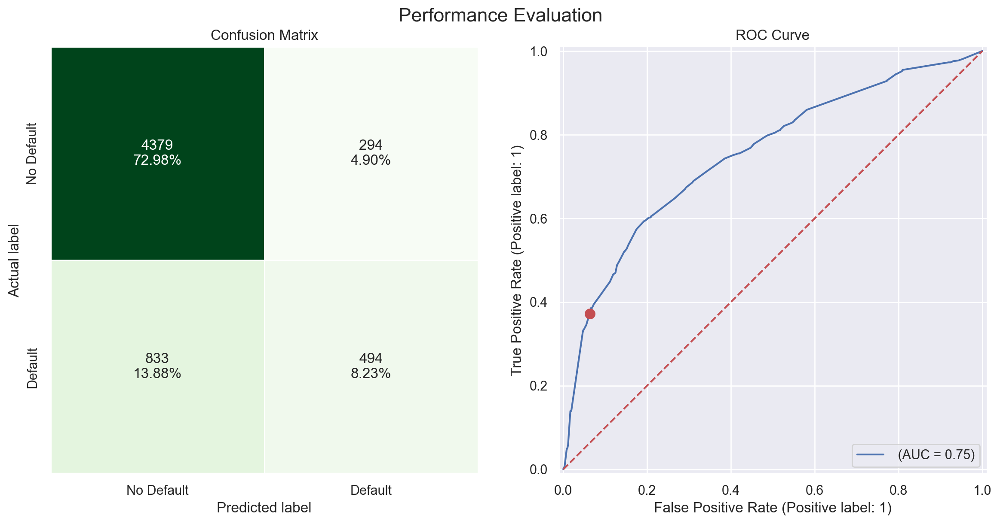

In [173]:
tree_sh_perf = performance_evaluation_report(classifier_sh, X_test, 
                                             y_test, labels=LABELS, 
                                             show_plot=True)

sns.despine()
plt.tight_layout()

아래 표에서는 이 레시피에서 다룬 grid search의 세 가지 접근 방식 각각이 선택한 하이퍼파라미터 값을 확인할 수 있습니다. 이 값들은 매우 유사하며, 테스트 세트에서의 성능도 비슷합니다(정확한 비교는 GitHub에 있는 노트북에서 확인할 수 있습니다). 모든 알고리즘의 학습 시간 비교는 독자가 직접 수행해 보도록 남겨두었습니다.

In [174]:
pd.DataFrame(
    data = [
        classifier_gs.best_params_, 
        classifier_rs.best_params_, 
        classifier_sh.best_params_
    ],
    index = ["grid_search", "randomized_search", "halving_search"]
)

,classifier__criterion,classifier__max_depth,classifier__min_samples_leaf,preprocessor__numerical__outliers__n_std
grid_search,gini,10,7,4
randomized_search,gini,10,7,3
halving_search,entropy,8,8,4


In [175]:
pd.DataFrame(
    data = [tree_gs_perf, tree_rs_perf, tree_sh_perf],
    index = ["grid_search", "randomized_search", "halving_search"]
).round(3)

,accuracy,precision,recall,specificity,f1_score,cohens_kappa,matthews_corr_coeff,roc_auc,pr_auc,average_precision
grid_search,0.803,0.585,0.378,0.924,0.459,0.345,0.358,0.721,0.470,0.465
randomized_search,0.803,0.584,0.376,0.924,0.458,0.344,0.356,0.719,0.469,0.464
halving_search,0.812,0.627,0.372,0.937,0.467,0.362,0.380,0.752,0.489,0.491


#### 여러 분류기를 사용한 그리드 탐색

우리는 여러 분류기를 포함하는 그리드를 생성할 수 있습니다. 이렇게 하면 어떤 모델이 우리의 데이터에 가장 적합한 성능을 발휘하는지 확인할 수 있습니다. 이를 위해, 우리는 먼저 `scikit-learn`에서 Random Forest를 불러올 것입니다.

In [176]:
from sklearn.ensemble import RandomForestClassifier

우리는 이 모델을 선택했는데, 이는 결정 트리의 앙상블로 구성되어 있으며 추가적인 데이터 전처리가 필요하지 않기 때문입니다. 예를 들어, 단순한 로지스틱 회귀 분류기(정규화를 사용하는)를 사용할 경우, 수치적 특성 부분에 추가적인 단계를 통해 특성을 표준화하거나 정규화해야 할 것입니다. 우리는 다음 장에서 Random Forest 모델에 대해 더 자세히 다룰 것입니다.

다시 한번, 파라미터 그리드를 정의해야 합니다. 이번에는 여러 딕셔너리를 포함하는 목록으로, 분류기마다 하나의 딕셔너리를 사용합니다. 결정 트리의 하이퍼파라미터는 이전과 동일하며, 우리는 추가 설명이 필요하지 않은 Random Forest의 가장 간단한 하이퍼파라미터를 선택했습니다.

파이프라인의 다른 하이퍼파라미터를 튜닝하려면, 목록의 각 딕셔너리에 해당 하이퍼파라미터를 지정해야 한다는 점을 언급할 필요가 있습니다. 그래서 `preprocessor__numerical__outliers__n_std`가 다음 코드에 포함된 것입니다.

In [177]:
param_grid = [
    {"classifier": [RandomForestClassifier(random_state=42)],
     "classifier__n_estimators": np.linspace(100, 500, 10, dtype=int),
     "classifier__max_depth": range(3, 11),
     "preprocessor__numerical__outliers__n_std": [3, 4]},
    {"classifier": [DecisionTreeClassifier(random_state=42)],
     "classifier__criterion": ["entropy", "gini"],
     "classifier__max_depth": range(3, 11),
     "classifier__min_samples_leaf": range(2, 11),
     "preprocessor__numerical__outliers__n_std": [3, 4]}
]

In [178]:
classifier_gs_2 = GridSearchCV(tree_pipeline, param_grid, 
                               scoring="recall", cv=k_fold, 
                               n_jobs=-1, verbose=1)

classifier_gs_2.fit(X_train, y_train)

print(f"Best parameters: {classifier_gs_2.best_params_}") 
print(f"Recall (Training set): {classifier_gs_2.best_score_:.4f}") 
print(f"Recall (Test set): {metrics.recall_score(y_test, classifier_gs_2.predict(X_test)):.4f}")

Fitting 5 folds for each of 448 candidates, totalling 2240 fits


/home/restful3/anaconda3/envs/ml4t/lib/python3.10/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast


Best parameters: {'classifier': DecisionTreeClassifier(random_state=42), 'classifier__criterion': 'gini', 'classifier__max_depth': 10, 'classifier__min_samples_leaf': 7, 'preprocessor__numerical__outliers__n_std': 4}
Recall (Training set): 0.3858
Recall (Test set): 0.3775


튜닝된 결정 트리가 나무의 앙상블을 구성하는 데 성공했습니다. 다음 장에서 살펴보겠지만, 약간의 튜닝으로 Random Forest 분류기의 결과를 쉽게 개선할 수 있습니다. 여기서는 많은 하이퍼파라미터 중 두 가지만 튜닝했습니다.

다음 코드를 사용하여, 모든 고려된 하이퍼파라미터/분류기 조합을 추출하고, 가장 좋은 결과부터 시작하여 정렬할 수 있습니다.

In [179]:
pd.DataFrame(classifier_gs_2.cv_results_).sort_values("rank_test_score")

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier,param_classifier__max_depth,param_classifier__n_estimators,param_preprocessor__numerical__outliers__n_std,param_classifier__criterion,param_classifier__min_samples_leaf,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
441,0.768559,0.006736,0.105100,0.002821,DecisionTreeClassifier(random_state=42),10,NaN,4,gini,7.0,{'classifier': DecisionTreeClassifier(random_s...,0.419416,0.359699,0.393597,0.386064,0.370056,0.385766,0.020591,1
419,0.750494,0.007739,0.105558,0.003706,DecisionTreeClassifier(random_state=42),9,NaN,4,gini,5.0,{'classifier': DecisionTreeClassifier(random_s...,0.394910,0.386064,0.387006,0.363465,0.397363,0.385762,0.011976,2
418,0.746018,0.005987,0.103091,0.001858,DecisionTreeClassifier(random_state=42),9,NaN,3,gini,5.0,{'classifier': DecisionTreeClassifier(random_s...,0.391140,0.386064,0.389831,0.363465,0.397363,0.385573,0.011637,3
440,0.765177,0.006225,0.107042,0.001209,DecisionTreeClassifier(random_state=42),10,NaN,3,gini,7.0,{'classifier': DecisionTreeClassifier(random_s...,0.415646,0.360640,0.393597,0.387006,0.370056,0.385389,0.019147,4
437,0.762011,0.015995,0.105604,0.001603,DecisionTreeClassifier(random_state=42),10,NaN,4,gini,5.0,{'classifier': DecisionTreeClassifier(random_s...,0.423186,0.364407,0.392655,0.382298,0.359699,0.384449,0.022745,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18,6.990831,0.332878,0.196402,0.003361,RandomForestClassifier(random_state=42),3,500.0,3,NaN,NaN,{'classifier': RandomForestClassifier(random_s...,0.100848,0.101695,0.100753,0.096987,0.099812,0.100019,0.001629,441
16,6.398691,0.301177,0.197342,0.011499,RandomForestClassifier(random_state=42),3,455.0,3,NaN,NaN,{'classifier': RandomForestClassifier(random_s...,0.099906,0.100753,0.103578,0.097928,0.097928,0.100019,0.002096,445
17,6.411975,0.319190,0.186339,0.003200,RandomForestClassifier(random_state=42),3,455.0,4,NaN,NaN,{'classifier': RandomForestClassifier(random_s...,0.099906,0.100753,0.102637,0.097928,0.097928,0.099830,0.001787,446
12,5.285247,0.263453,0.179334,0.014200,RandomForestClassifier(random_state=42),3,366.0,3,NaN,NaN,{'classifier': RandomForestClassifier(random_s...,0.099906,0.100753,0.100753,0.102637,0.092279,0.099266,0.003606,447


### See also

랜덤 탐색 절차에 대한 추가 자료는 다음에서 확인할 수 있습니다:

- Bergstra, J. & Bengio, Y. (2012). "Random search for hyper-parameter optimization." *Journal of Machine Learning Research*, 13(2월), 281-305. [링크](http://www.jmlr.org/papers/volume13/bergstra12a/bergstra12a.pdf).

## Summary

이 장에서는 재무 도메인에만 국한되지 않고, 머신 러닝 프로젝트에 접근하기 위한 기본 사항을 다뤘습니다. 우리는 다음을 수행했습니다:

- 데이터를 가져오고 메모리 사용을 최적화했습니다.
- 피처의 분포, 누락된 값, 클래스 불균형 등 데이터를 철저히 탐색했으며, 잠재적인 피처 엔지니어링에 대한 아이디어를 제공했습니다.
- 데이터셋의 누락된 값을 식별하고 이를 보완했습니다.
- 범주형 변수를 올바르게 해석하여 머신 러닝 모델에 의해 해석되도록 인코딩하는 방법을 배웠습니다.
- 가장 인기 있고 성숙한 ML 라이브러리인 scikit-learn을 사용하여 결정 트리 분류기를 적합시켰습니다.
- 파이프라인을 사용하여 전체 코드베이스를 구성하는 방법을 배웠습니다.
- 언더피팅과 오버피팅의 균형을 맞추기 위해 하이퍼파라미터를 튜닝하여 추가 성능을 얻는 방법을 배웠습니다.
